# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:50, 3.63MB/s]                              
SVHN Testing Set: 64.3MB [00:22, 2.83MB/s]                              


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

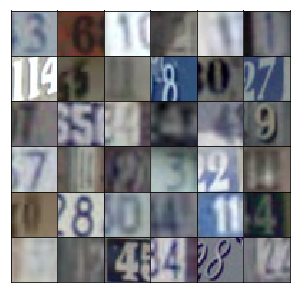

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    mn, mx = feature_range
    x = x * (mx - mn) + mn
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.1122... Generator Loss: 0.8161
Epoch 1/25... Discriminator Loss: 0.4604... Generator Loss: 2.2189
Epoch 1/25... Discriminator Loss: 0.1594... Generator Loss: 2.9855
Epoch 1/25... Discriminator Loss: 0.1506... Generator Loss: 3.3151
Epoch 1/25... Discriminator Loss: 0.1045... Generator Loss: 3.8223
Epoch 1/25... Discriminator Loss: 0.1385... Generator Loss: 2.5822
Epoch 1/25... Discriminator Loss: 0.1380... Generator Loss: 2.8123
Epoch 1/25... Discriminator Loss: 0.0974... Generator Loss: 4.6170
Epoch 1/25... Discriminator Loss: 0.1004... Generator Loss: 3.3098
Epoch 1/25... Discriminator Loss: 0.0977... Generator Loss: 3.3788


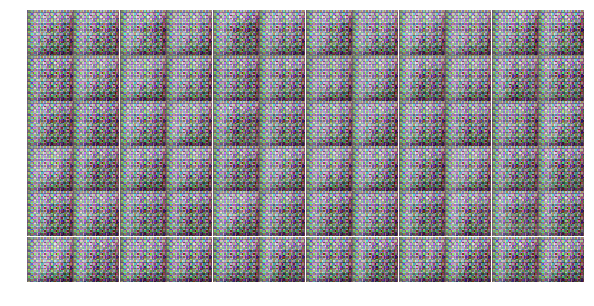

Epoch 1/25... Discriminator Loss: 0.4335... Generator Loss: 1.6793
Epoch 1/25... Discriminator Loss: 0.8345... Generator Loss: 3.2342
Epoch 1/25... Discriminator Loss: 0.7603... Generator Loss: 1.1769
Epoch 1/25... Discriminator Loss: 0.5754... Generator Loss: 1.1161
Epoch 1/25... Discriminator Loss: 0.9313... Generator Loss: 0.6338
Epoch 1/25... Discriminator Loss: 0.4788... Generator Loss: 2.6759
Epoch 1/25... Discriminator Loss: 0.3979... Generator Loss: 1.7197
Epoch 1/25... Discriminator Loss: 0.4437... Generator Loss: 2.5683
Epoch 1/25... Discriminator Loss: 0.2689... Generator Loss: 2.6128
Epoch 1/25... Discriminator Loss: 0.2739... Generator Loss: 3.1293


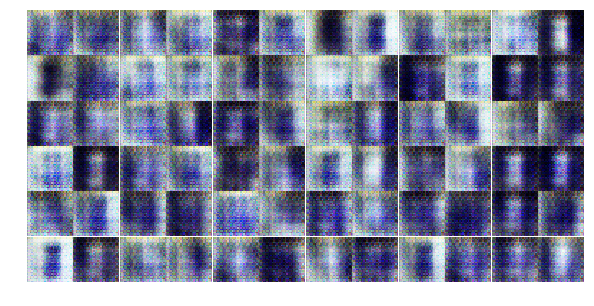

Epoch 1/25... Discriminator Loss: 0.4089... Generator Loss: 2.1083
Epoch 1/25... Discriminator Loss: 0.3492... Generator Loss: 1.4091
Epoch 1/25... Discriminator Loss: 2.4212... Generator Loss: 0.1570
Epoch 1/25... Discriminator Loss: 1.3639... Generator Loss: 0.5589
Epoch 1/25... Discriminator Loss: 0.5751... Generator Loss: 1.6707
Epoch 1/25... Discriminator Loss: 0.9354... Generator Loss: 0.6550
Epoch 1/25... Discriminator Loss: 0.6597... Generator Loss: 3.4543
Epoch 1/25... Discriminator Loss: 1.2356... Generator Loss: 0.8304
Epoch 1/25... Discriminator Loss: 0.6052... Generator Loss: 1.8693
Epoch 1/25... Discriminator Loss: 0.6754... Generator Loss: 1.4925


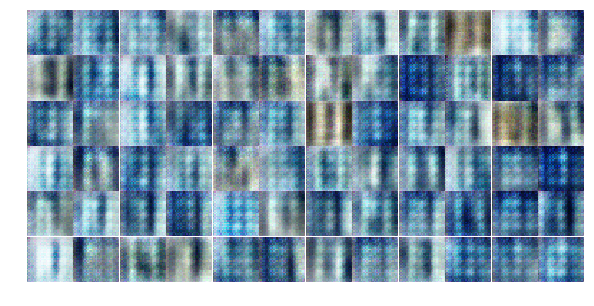

Epoch 1/25... Discriminator Loss: 0.6944... Generator Loss: 1.2107
Epoch 1/25... Discriminator Loss: 0.5606... Generator Loss: 1.5792
Epoch 1/25... Discriminator Loss: 0.3531... Generator Loss: 2.0852
Epoch 1/25... Discriminator Loss: 0.4598... Generator Loss: 2.1885
Epoch 1/25... Discriminator Loss: 0.3849... Generator Loss: 2.2381
Epoch 1/25... Discriminator Loss: 0.2077... Generator Loss: 2.9773
Epoch 1/25... Discriminator Loss: 0.4058... Generator Loss: 2.2032
Epoch 1/25... Discriminator Loss: 0.1926... Generator Loss: 2.9718
Epoch 1/25... Discriminator Loss: 0.3137... Generator Loss: 3.2289
Epoch 1/25... Discriminator Loss: 0.5317... Generator Loss: 1.5538


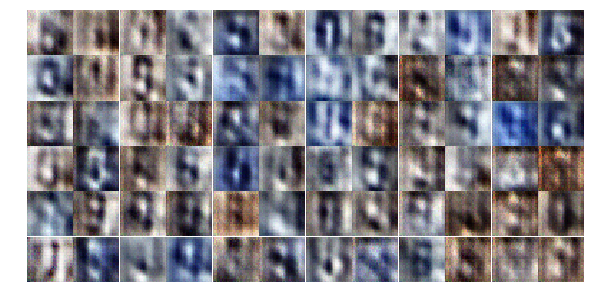

Epoch 1/25... Discriminator Loss: 0.3285... Generator Loss: 1.8596
Epoch 1/25... Discriminator Loss: 0.2788... Generator Loss: 2.2074
Epoch 1/25... Discriminator Loss: 0.2816... Generator Loss: 2.8226
Epoch 1/25... Discriminator Loss: 0.8401... Generator Loss: 1.7580
Epoch 1/25... Discriminator Loss: 0.8855... Generator Loss: 1.2226
Epoch 1/25... Discriminator Loss: 1.0035... Generator Loss: 0.8266
Epoch 1/25... Discriminator Loss: 0.3891... Generator Loss: 2.3467
Epoch 1/25... Discriminator Loss: 0.4219... Generator Loss: 2.3279
Epoch 1/25... Discriminator Loss: 0.4893... Generator Loss: 1.2401
Epoch 1/25... Discriminator Loss: 1.4325... Generator Loss: 0.3922


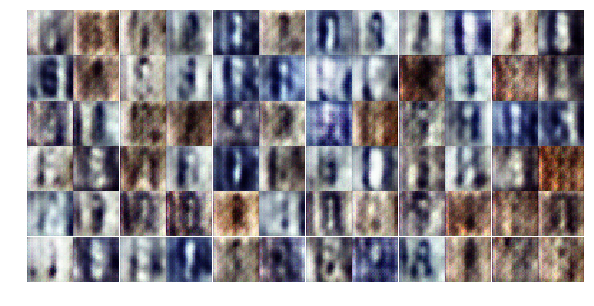

Epoch 1/25... Discriminator Loss: 0.2571... Generator Loss: 2.0095
Epoch 1/25... Discriminator Loss: 1.0108... Generator Loss: 1.2853
Epoch 1/25... Discriminator Loss: 0.7664... Generator Loss: 1.6093
Epoch 1/25... Discriminator Loss: 0.4911... Generator Loss: 2.0335
Epoch 1/25... Discriminator Loss: 0.9918... Generator Loss: 0.8087
Epoch 1/25... Discriminator Loss: 0.3042... Generator Loss: 1.9732
Epoch 1/25... Discriminator Loss: 0.9230... Generator Loss: 1.2740
Epoch 2/25... Discriminator Loss: 0.8273... Generator Loss: 1.4409
Epoch 2/25... Discriminator Loss: 0.7725... Generator Loss: 1.6323
Epoch 2/25... Discriminator Loss: 0.5814... Generator Loss: 1.5493


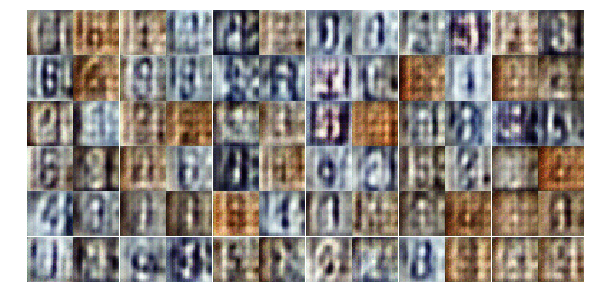

Epoch 2/25... Discriminator Loss: 0.6943... Generator Loss: 1.1574
Epoch 2/25... Discriminator Loss: 0.3214... Generator Loss: 2.6950
Epoch 2/25... Discriminator Loss: 1.0632... Generator Loss: 0.8493
Epoch 2/25... Discriminator Loss: 0.5403... Generator Loss: 2.0978
Epoch 2/25... Discriminator Loss: 1.1513... Generator Loss: 0.5833
Epoch 2/25... Discriminator Loss: 0.3552... Generator Loss: 2.0510
Epoch 2/25... Discriminator Loss: 1.5942... Generator Loss: 0.3765
Epoch 2/25... Discriminator Loss: 0.7528... Generator Loss: 1.6270
Epoch 2/25... Discriminator Loss: 0.4093... Generator Loss: 1.4377
Epoch 2/25... Discriminator Loss: 0.7223... Generator Loss: 1.9083


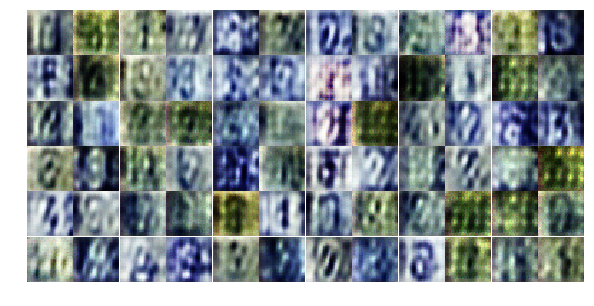

Epoch 2/25... Discriminator Loss: 0.6042... Generator Loss: 2.1815
Epoch 2/25... Discriminator Loss: 0.3906... Generator Loss: 3.6840
Epoch 2/25... Discriminator Loss: 0.9974... Generator Loss: 1.9713
Epoch 2/25... Discriminator Loss: 0.3408... Generator Loss: 2.0851
Epoch 2/25... Discriminator Loss: 1.2502... Generator Loss: 2.5288
Epoch 2/25... Discriminator Loss: 1.3620... Generator Loss: 1.2107
Epoch 2/25... Discriminator Loss: 0.9550... Generator Loss: 0.8401
Epoch 2/25... Discriminator Loss: 0.7537... Generator Loss: 0.8473
Epoch 2/25... Discriminator Loss: 1.6680... Generator Loss: 0.3417
Epoch 2/25... Discriminator Loss: 0.6439... Generator Loss: 2.2323


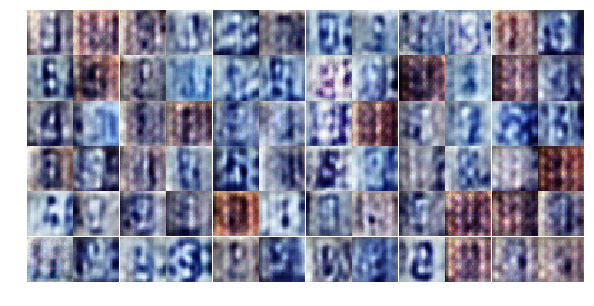

Epoch 2/25... Discriminator Loss: 0.6560... Generator Loss: 1.2481
Epoch 2/25... Discriminator Loss: 0.4074... Generator Loss: 2.0848
Epoch 2/25... Discriminator Loss: 0.8199... Generator Loss: 4.0259
Epoch 2/25... Discriminator Loss: 0.8697... Generator Loss: 0.9506
Epoch 2/25... Discriminator Loss: 0.4780... Generator Loss: 1.8064
Epoch 2/25... Discriminator Loss: 0.1934... Generator Loss: 2.5697
Epoch 2/25... Discriminator Loss: 0.9231... Generator Loss: 2.1646
Epoch 2/25... Discriminator Loss: 0.8588... Generator Loss: 0.9644
Epoch 2/25... Discriminator Loss: 1.5538... Generator Loss: 0.3821
Epoch 2/25... Discriminator Loss: 0.6473... Generator Loss: 2.1101


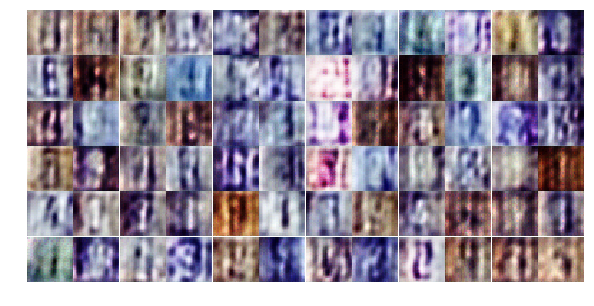

Epoch 2/25... Discriminator Loss: 1.7024... Generator Loss: 0.3093
Epoch 2/25... Discriminator Loss: 0.8037... Generator Loss: 2.1714
Epoch 2/25... Discriminator Loss: 1.4244... Generator Loss: 0.4904
Epoch 2/25... Discriminator Loss: 1.0623... Generator Loss: 0.5947
Epoch 2/25... Discriminator Loss: 0.7377... Generator Loss: 3.2035
Epoch 2/25... Discriminator Loss: 0.9467... Generator Loss: 1.1451
Epoch 2/25... Discriminator Loss: 1.2336... Generator Loss: 0.6421
Epoch 2/25... Discriminator Loss: 0.7333... Generator Loss: 2.1445
Epoch 2/25... Discriminator Loss: 0.8683... Generator Loss: 1.3134
Epoch 2/25... Discriminator Loss: 1.1159... Generator Loss: 0.8523


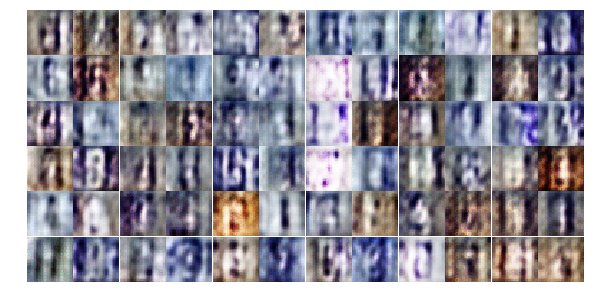

Epoch 2/25... Discriminator Loss: 0.4948... Generator Loss: 2.0435
Epoch 2/25... Discriminator Loss: 0.8564... Generator Loss: 1.1709
Epoch 2/25... Discriminator Loss: 0.5613... Generator Loss: 1.4748
Epoch 2/25... Discriminator Loss: 0.8039... Generator Loss: 2.4044
Epoch 2/25... Discriminator Loss: 0.6968... Generator Loss: 1.6667
Epoch 2/25... Discriminator Loss: 1.1670... Generator Loss: 2.6620
Epoch 2/25... Discriminator Loss: 0.5492... Generator Loss: 2.0052
Epoch 2/25... Discriminator Loss: 0.7071... Generator Loss: 2.1757
Epoch 2/25... Discriminator Loss: 0.6294... Generator Loss: 1.0754
Epoch 2/25... Discriminator Loss: 1.3734... Generator Loss: 3.3259


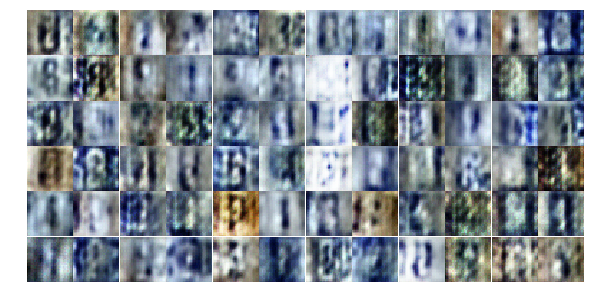

Epoch 2/25... Discriminator Loss: 0.9706... Generator Loss: 0.6580
Epoch 2/25... Discriminator Loss: 0.9989... Generator Loss: 0.6797
Epoch 2/25... Discriminator Loss: 1.3351... Generator Loss: 0.4746
Epoch 2/25... Discriminator Loss: 1.4848... Generator Loss: 0.4206
Epoch 3/25... Discriminator Loss: 1.3472... Generator Loss: 2.6254
Epoch 3/25... Discriminator Loss: 0.9875... Generator Loss: 0.9469
Epoch 3/25... Discriminator Loss: 1.2180... Generator Loss: 1.5620
Epoch 3/25... Discriminator Loss: 0.8051... Generator Loss: 1.0550
Epoch 3/25... Discriminator Loss: 0.7357... Generator Loss: 1.0355
Epoch 3/25... Discriminator Loss: 0.6140... Generator Loss: 2.4791


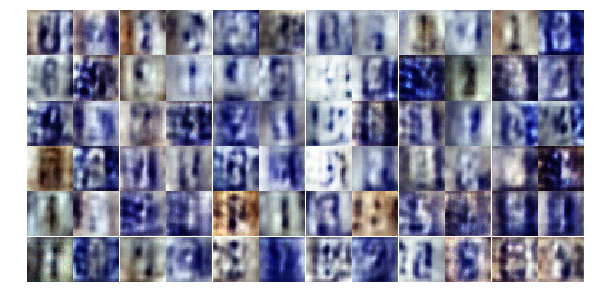

Epoch 3/25... Discriminator Loss: 0.6575... Generator Loss: 2.4818
Epoch 3/25... Discriminator Loss: 0.9580... Generator Loss: 2.1630
Epoch 3/25... Discriminator Loss: 0.9214... Generator Loss: 0.7850
Epoch 3/25... Discriminator Loss: 1.2532... Generator Loss: 1.0014
Epoch 3/25... Discriminator Loss: 0.9428... Generator Loss: 0.9983
Epoch 3/25... Discriminator Loss: 1.2395... Generator Loss: 0.5367
Epoch 3/25... Discriminator Loss: 0.7450... Generator Loss: 2.6358
Epoch 3/25... Discriminator Loss: 0.6333... Generator Loss: 1.0526
Epoch 3/25... Discriminator Loss: 1.3733... Generator Loss: 0.9351
Epoch 3/25... Discriminator Loss: 0.3509... Generator Loss: 2.4980


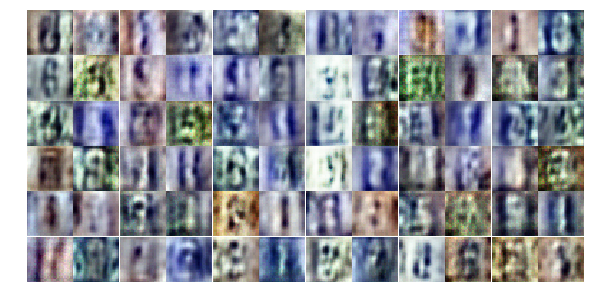

Epoch 3/25... Discriminator Loss: 0.5975... Generator Loss: 1.6057
Epoch 3/25... Discriminator Loss: 0.4932... Generator Loss: 1.4529
Epoch 3/25... Discriminator Loss: 0.4925... Generator Loss: 2.7226
Epoch 3/25... Discriminator Loss: 0.6090... Generator Loss: 2.9341
Epoch 3/25... Discriminator Loss: 0.5966... Generator Loss: 1.3450
Epoch 3/25... Discriminator Loss: 0.3889... Generator Loss: 2.2232
Epoch 3/25... Discriminator Loss: 1.1556... Generator Loss: 0.4784
Epoch 3/25... Discriminator Loss: 1.0673... Generator Loss: 2.0910
Epoch 3/25... Discriminator Loss: 0.3878... Generator Loss: 2.2320
Epoch 3/25... Discriminator Loss: 1.3783... Generator Loss: 0.4701


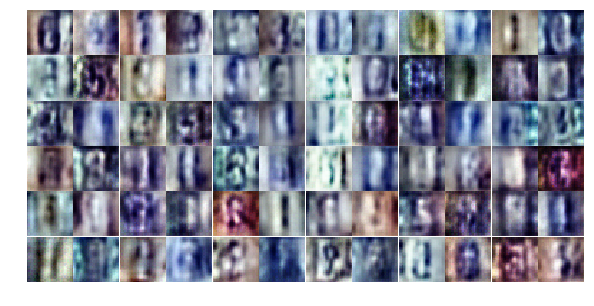

Epoch 3/25... Discriminator Loss: 0.6738... Generator Loss: 1.8285
Epoch 3/25... Discriminator Loss: 0.6517... Generator Loss: 1.2729
Epoch 3/25... Discriminator Loss: 0.6269... Generator Loss: 1.8283
Epoch 3/25... Discriminator Loss: 0.6477... Generator Loss: 1.1463
Epoch 3/25... Discriminator Loss: 0.3812... Generator Loss: 2.0140
Epoch 3/25... Discriminator Loss: 0.6437... Generator Loss: 2.0424
Epoch 3/25... Discriminator Loss: 0.7861... Generator Loss: 1.1059
Epoch 3/25... Discriminator Loss: 0.5219... Generator Loss: 1.5083
Epoch 3/25... Discriminator Loss: 1.3579... Generator Loss: 0.4405
Epoch 3/25... Discriminator Loss: 0.6377... Generator Loss: 1.1655


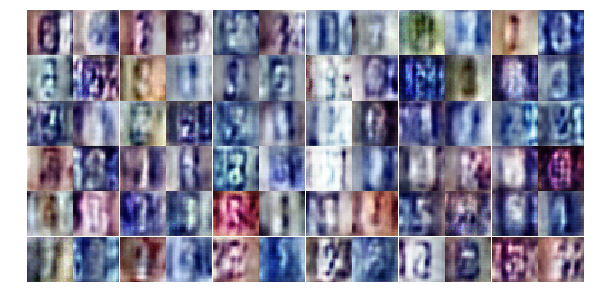

Epoch 3/25... Discriminator Loss: 0.4783... Generator Loss: 1.7347
Epoch 3/25... Discriminator Loss: 0.4050... Generator Loss: 2.4651
Epoch 3/25... Discriminator Loss: 0.5858... Generator Loss: 1.2351
Epoch 3/25... Discriminator Loss: 0.5816... Generator Loss: 2.9434
Epoch 3/25... Discriminator Loss: 0.5596... Generator Loss: 2.3857
Epoch 3/25... Discriminator Loss: 0.7024... Generator Loss: 2.2876
Epoch 3/25... Discriminator Loss: 0.8461... Generator Loss: 2.5377
Epoch 3/25... Discriminator Loss: 0.8258... Generator Loss: 0.8028
Epoch 3/25... Discriminator Loss: 1.9445... Generator Loss: 4.0946
Epoch 3/25... Discriminator Loss: 0.9085... Generator Loss: 1.1472


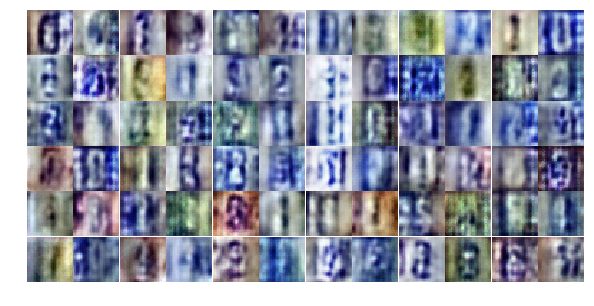

Epoch 3/25... Discriminator Loss: 0.6271... Generator Loss: 2.7470
Epoch 3/25... Discriminator Loss: 0.7338... Generator Loss: 2.1028
Epoch 3/25... Discriminator Loss: 0.4919... Generator Loss: 1.7976
Epoch 3/25... Discriminator Loss: 0.3566... Generator Loss: 2.0866
Epoch 3/25... Discriminator Loss: 0.6444... Generator Loss: 1.4548
Epoch 3/25... Discriminator Loss: 0.2786... Generator Loss: 4.7624
Epoch 3/25... Discriminator Loss: 0.4540... Generator Loss: 1.9547
Epoch 3/25... Discriminator Loss: 0.4880... Generator Loss: 2.6243
Epoch 3/25... Discriminator Loss: 0.7861... Generator Loss: 2.5431
Epoch 3/25... Discriminator Loss: 0.6119... Generator Loss: 1.2311


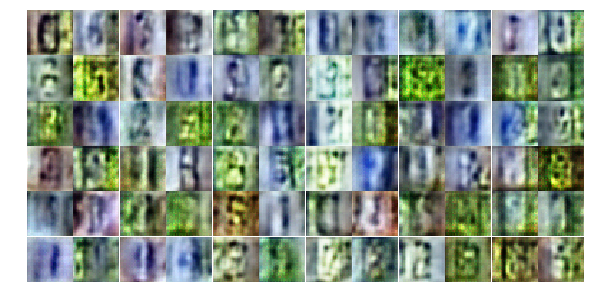

Epoch 3/25... Discriminator Loss: 1.1596... Generator Loss: 0.5513
Epoch 4/25... Discriminator Loss: 0.7455... Generator Loss: 1.3154
Epoch 4/25... Discriminator Loss: 0.4319... Generator Loss: 1.6983
Epoch 4/25... Discriminator Loss: 1.3141... Generator Loss: 0.4775
Epoch 4/25... Discriminator Loss: 0.6316... Generator Loss: 1.3082
Epoch 4/25... Discriminator Loss: 0.5150... Generator Loss: 1.2685
Epoch 4/25... Discriminator Loss: 0.5676... Generator Loss: 1.7724
Epoch 4/25... Discriminator Loss: 0.4816... Generator Loss: 2.9492
Epoch 4/25... Discriminator Loss: 0.5839... Generator Loss: 1.0329
Epoch 4/25... Discriminator Loss: 0.2589... Generator Loss: 2.3905


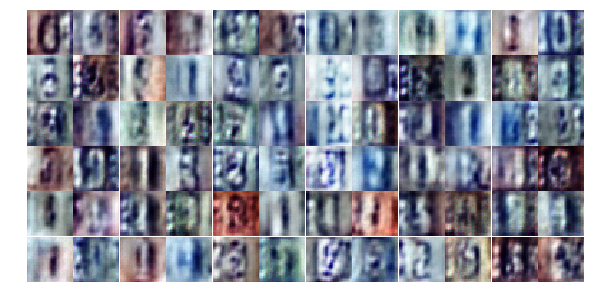

Epoch 4/25... Discriminator Loss: 0.4952... Generator Loss: 1.4940
Epoch 4/25... Discriminator Loss: 0.5358... Generator Loss: 2.1693
Epoch 4/25... Discriminator Loss: 0.7051... Generator Loss: 1.4051
Epoch 4/25... Discriminator Loss: 0.7567... Generator Loss: 0.9631
Epoch 4/25... Discriminator Loss: 0.7333... Generator Loss: 1.1305
Epoch 4/25... Discriminator Loss: 1.6437... Generator Loss: 0.3074
Epoch 4/25... Discriminator Loss: 0.9348... Generator Loss: 0.7083
Epoch 4/25... Discriminator Loss: 0.3891... Generator Loss: 2.2859
Epoch 4/25... Discriminator Loss: 0.4700... Generator Loss: 1.6126
Epoch 4/25... Discriminator Loss: 0.6203... Generator Loss: 1.0524


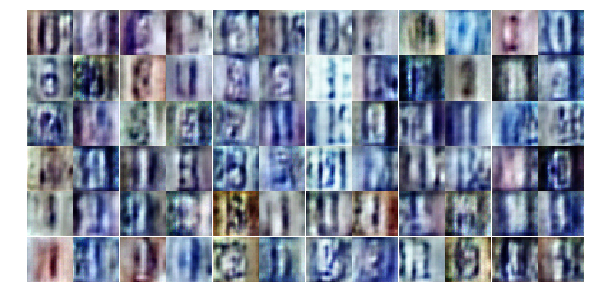

Epoch 4/25... Discriminator Loss: 0.6537... Generator Loss: 1.2908
Epoch 4/25... Discriminator Loss: 0.4997... Generator Loss: 1.5881
Epoch 4/25... Discriminator Loss: 0.2900... Generator Loss: 2.0225
Epoch 4/25... Discriminator Loss: 1.1046... Generator Loss: 0.5695
Epoch 4/25... Discriminator Loss: 0.3301... Generator Loss: 2.2154
Epoch 4/25... Discriminator Loss: 0.5315... Generator Loss: 2.2728
Epoch 4/25... Discriminator Loss: 1.7044... Generator Loss: 0.3238
Epoch 4/25... Discriminator Loss: 0.2515... Generator Loss: 2.6162
Epoch 4/25... Discriminator Loss: 0.2145... Generator Loss: 2.7111
Epoch 4/25... Discriminator Loss: 0.4542... Generator Loss: 1.8136


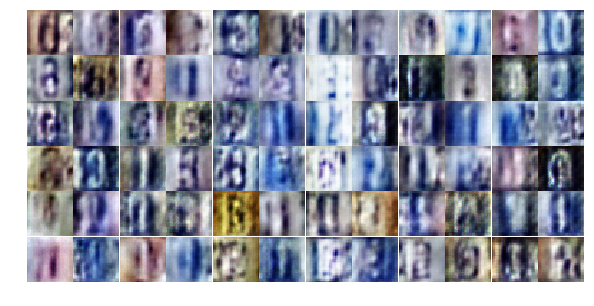

Epoch 4/25... Discriminator Loss: 0.4070... Generator Loss: 2.0666
Epoch 4/25... Discriminator Loss: 0.4139... Generator Loss: 2.8004
Epoch 4/25... Discriminator Loss: 0.6482... Generator Loss: 1.1687
Epoch 4/25... Discriminator Loss: 0.2895... Generator Loss: 2.7775
Epoch 4/25... Discriminator Loss: 0.3445... Generator Loss: 2.3282
Epoch 4/25... Discriminator Loss: 0.4999... Generator Loss: 2.0075
Epoch 4/25... Discriminator Loss: 0.4732... Generator Loss: 1.5006
Epoch 4/25... Discriminator Loss: 0.2947... Generator Loss: 2.2529
Epoch 4/25... Discriminator Loss: 0.5342... Generator Loss: 1.1299
Epoch 4/25... Discriminator Loss: 0.3779... Generator Loss: 1.4374


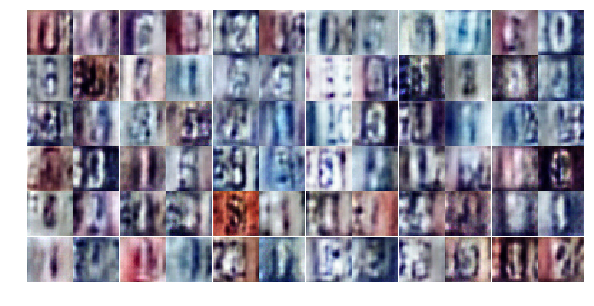

Epoch 4/25... Discriminator Loss: 0.2042... Generator Loss: 2.4493
Epoch 4/25... Discriminator Loss: 0.1861... Generator Loss: 2.5793
Epoch 4/25... Discriminator Loss: 0.3042... Generator Loss: 4.3425
Epoch 4/25... Discriminator Loss: 0.8835... Generator Loss: 0.7993
Epoch 4/25... Discriminator Loss: 0.5943... Generator Loss: 2.1043
Epoch 4/25... Discriminator Loss: 0.7070... Generator Loss: 0.9053
Epoch 4/25... Discriminator Loss: 0.2359... Generator Loss: 2.6574
Epoch 4/25... Discriminator Loss: 0.2347... Generator Loss: 2.6057
Epoch 4/25... Discriminator Loss: 0.2780... Generator Loss: 2.0944
Epoch 4/25... Discriminator Loss: 0.3906... Generator Loss: 2.2799


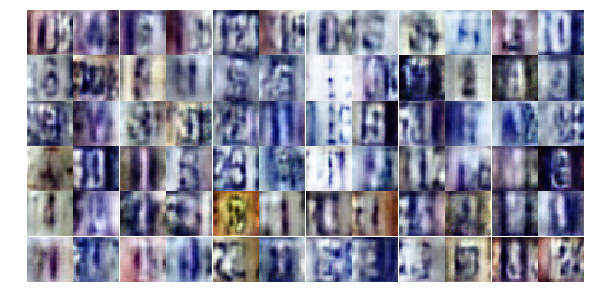

Epoch 4/25... Discriminator Loss: 0.3875... Generator Loss: 3.8512
Epoch 4/25... Discriminator Loss: 0.4815... Generator Loss: 1.7202
Epoch 4/25... Discriminator Loss: 0.3495... Generator Loss: 3.6245
Epoch 4/25... Discriminator Loss: 0.4231... Generator Loss: 4.5656
Epoch 4/25... Discriminator Loss: 0.8565... Generator Loss: 0.7846
Epoch 4/25... Discriminator Loss: 0.5502... Generator Loss: 1.1942
Epoch 4/25... Discriminator Loss: 1.5737... Generator Loss: 0.3045
Epoch 4/25... Discriminator Loss: 0.3218... Generator Loss: 3.5365
Epoch 4/25... Discriminator Loss: 0.9695... Generator Loss: 0.6738
Epoch 5/25... Discriminator Loss: 0.5256... Generator Loss: 1.4609


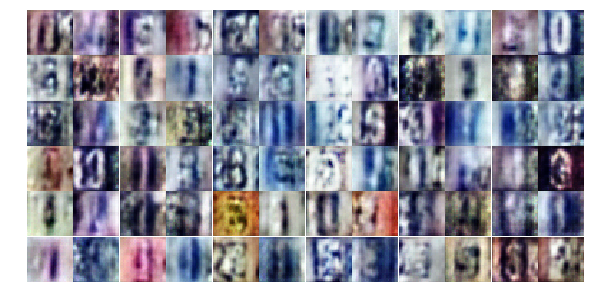

Epoch 5/25... Discriminator Loss: 0.2587... Generator Loss: 2.9761
Epoch 5/25... Discriminator Loss: 0.9108... Generator Loss: 0.6737
Epoch 5/25... Discriminator Loss: 0.3710... Generator Loss: 2.7984
Epoch 5/25... Discriminator Loss: 0.5641... Generator Loss: 1.0195
Epoch 5/25... Discriminator Loss: 0.3332... Generator Loss: 1.6878
Epoch 5/25... Discriminator Loss: 0.5298... Generator Loss: 1.2024
Epoch 5/25... Discriminator Loss: 0.3156... Generator Loss: 1.7944
Epoch 5/25... Discriminator Loss: 0.2166... Generator Loss: 2.4738
Epoch 5/25... Discriminator Loss: 0.4140... Generator Loss: 1.4507
Epoch 5/25... Discriminator Loss: 0.9566... Generator Loss: 0.6855


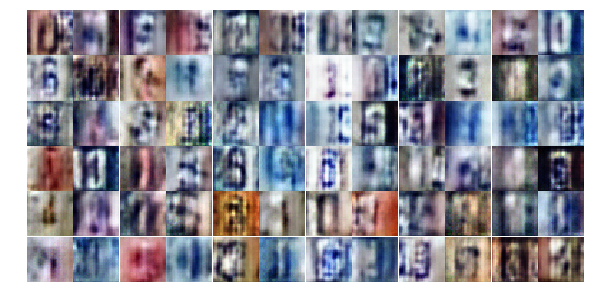

Epoch 5/25... Discriminator Loss: 0.6321... Generator Loss: 0.9812
Epoch 5/25... Discriminator Loss: 0.2281... Generator Loss: 2.6679
Epoch 5/25... Discriminator Loss: 0.4480... Generator Loss: 3.5034
Epoch 5/25... Discriminator Loss: 0.7121... Generator Loss: 0.9098
Epoch 5/25... Discriminator Loss: 2.5863... Generator Loss: 3.5887
Epoch 5/25... Discriminator Loss: 0.2834... Generator Loss: 3.8169
Epoch 5/25... Discriminator Loss: 0.3597... Generator Loss: 2.1009
Epoch 5/25... Discriminator Loss: 0.5593... Generator Loss: 1.3098
Epoch 5/25... Discriminator Loss: 0.4146... Generator Loss: 1.4947
Epoch 5/25... Discriminator Loss: 0.3391... Generator Loss: 2.1626


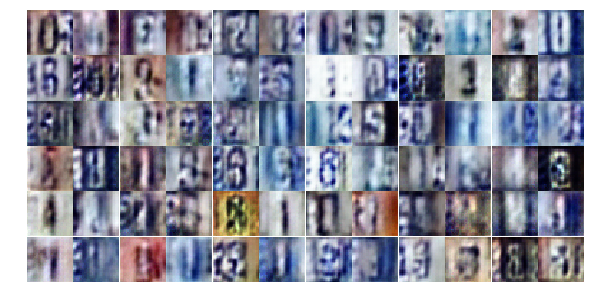

Epoch 5/25... Discriminator Loss: 0.2117... Generator Loss: 2.3608
Epoch 5/25... Discriminator Loss: 0.3246... Generator Loss: 1.9179
Epoch 5/25... Discriminator Loss: 0.3502... Generator Loss: 3.9777
Epoch 5/25... Discriminator Loss: 0.1092... Generator Loss: 3.7613
Epoch 5/25... Discriminator Loss: 0.9983... Generator Loss: 0.6397
Epoch 5/25... Discriminator Loss: 0.2723... Generator Loss: 1.9734
Epoch 5/25... Discriminator Loss: 0.7132... Generator Loss: 0.9106
Epoch 5/25... Discriminator Loss: 0.2546... Generator Loss: 2.3968
Epoch 5/25... Discriminator Loss: 1.2262... Generator Loss: 3.6683
Epoch 5/25... Discriminator Loss: 0.6915... Generator Loss: 0.9860


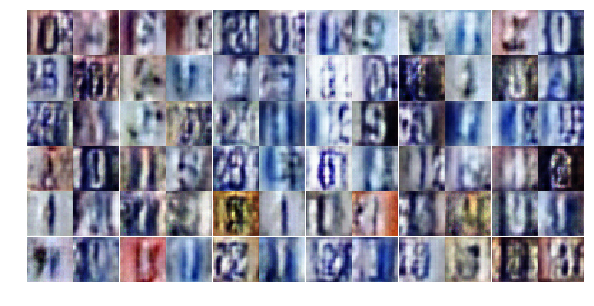

Epoch 5/25... Discriminator Loss: 0.6767... Generator Loss: 1.0397
Epoch 5/25... Discriminator Loss: 0.5529... Generator Loss: 1.3011
Epoch 5/25... Discriminator Loss: 0.2770... Generator Loss: 2.6546
Epoch 5/25... Discriminator Loss: 0.2800... Generator Loss: 1.9397
Epoch 5/25... Discriminator Loss: 0.5266... Generator Loss: 1.3033
Epoch 5/25... Discriminator Loss: 0.1248... Generator Loss: 4.0614
Epoch 5/25... Discriminator Loss: 1.0636... Generator Loss: 0.5896
Epoch 5/25... Discriminator Loss: 0.5089... Generator Loss: 2.8082
Epoch 5/25... Discriminator Loss: 0.6926... Generator Loss: 0.9611
Epoch 5/25... Discriminator Loss: 0.8094... Generator Loss: 0.8760


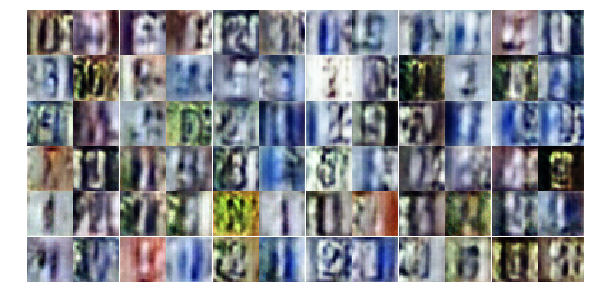

Epoch 5/25... Discriminator Loss: 0.2189... Generator Loss: 2.7453
Epoch 5/25... Discriminator Loss: 0.7461... Generator Loss: 0.8640
Epoch 5/25... Discriminator Loss: 0.6964... Generator Loss: 0.9803
Epoch 5/25... Discriminator Loss: 0.4016... Generator Loss: 1.5378
Epoch 5/25... Discriminator Loss: 0.3217... Generator Loss: 1.8763
Epoch 5/25... Discriminator Loss: 0.8708... Generator Loss: 0.7347
Epoch 5/25... Discriminator Loss: 0.4726... Generator Loss: 2.9930
Epoch 5/25... Discriminator Loss: 0.4239... Generator Loss: 1.4193
Epoch 5/25... Discriminator Loss: 4.3978... Generator Loss: 0.0218
Epoch 5/25... Discriminator Loss: 0.3158... Generator Loss: 2.6951


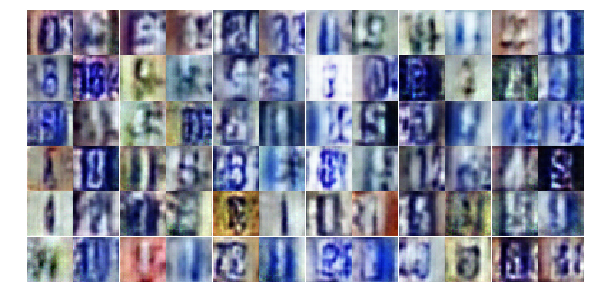

Epoch 5/25... Discriminator Loss: 0.6326... Generator Loss: 1.2930
Epoch 5/25... Discriminator Loss: 0.6427... Generator Loss: 1.0889
Epoch 5/25... Discriminator Loss: 0.4653... Generator Loss: 1.3181
Epoch 5/25... Discriminator Loss: 0.2757... Generator Loss: 2.1886
Epoch 5/25... Discriminator Loss: 0.4534... Generator Loss: 1.5878
Epoch 5/25... Discriminator Loss: 0.3772... Generator Loss: 2.7939
Epoch 6/25... Discriminator Loss: 0.2864... Generator Loss: 2.1153
Epoch 6/25... Discriminator Loss: 0.2184... Generator Loss: 2.5085
Epoch 6/25... Discriminator Loss: 0.3784... Generator Loss: 1.5951
Epoch 6/25... Discriminator Loss: 0.3894... Generator Loss: 1.5300


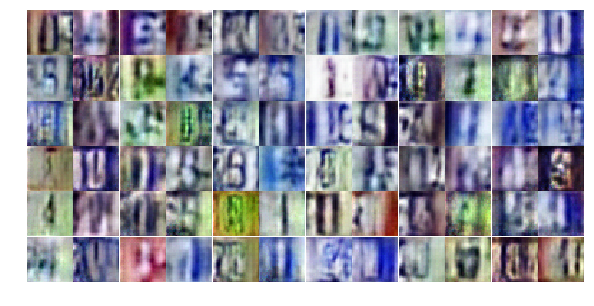

Epoch 6/25... Discriminator Loss: 0.1757... Generator Loss: 2.4527
Epoch 6/25... Discriminator Loss: 0.7559... Generator Loss: 4.0650
Epoch 6/25... Discriminator Loss: 0.1710... Generator Loss: 2.8881
Epoch 6/25... Discriminator Loss: 0.2315... Generator Loss: 2.2951
Epoch 6/25... Discriminator Loss: 0.7767... Generator Loss: 0.8528
Epoch 6/25... Discriminator Loss: 0.1293... Generator Loss: 3.2017
Epoch 6/25... Discriminator Loss: 0.5227... Generator Loss: 3.8230
Epoch 6/25... Discriminator Loss: 1.4779... Generator Loss: 1.3767
Epoch 6/25... Discriminator Loss: 0.9667... Generator Loss: 1.4081
Epoch 6/25... Discriminator Loss: 1.2363... Generator Loss: 0.7697


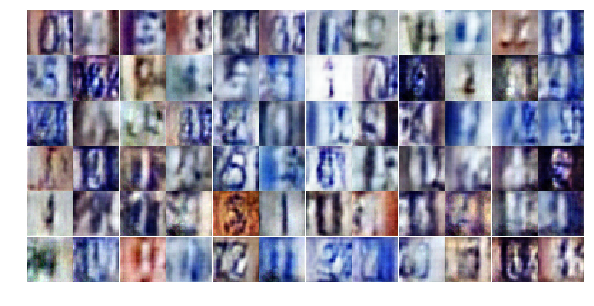

Epoch 6/25... Discriminator Loss: 0.5157... Generator Loss: 1.6669
Epoch 6/25... Discriminator Loss: 1.0362... Generator Loss: 0.6290
Epoch 6/25... Discriminator Loss: 0.3928... Generator Loss: 1.6915
Epoch 6/25... Discriminator Loss: 0.2507... Generator Loss: 2.1842
Epoch 6/25... Discriminator Loss: 0.4061... Generator Loss: 2.2739
Epoch 6/25... Discriminator Loss: 0.2787... Generator Loss: 2.8044
Epoch 6/25... Discriminator Loss: 0.4252... Generator Loss: 1.4121
Epoch 6/25... Discriminator Loss: 0.7184... Generator Loss: 0.8907
Epoch 6/25... Discriminator Loss: 0.3447... Generator Loss: 3.0532
Epoch 6/25... Discriminator Loss: 0.5336... Generator Loss: 1.4246


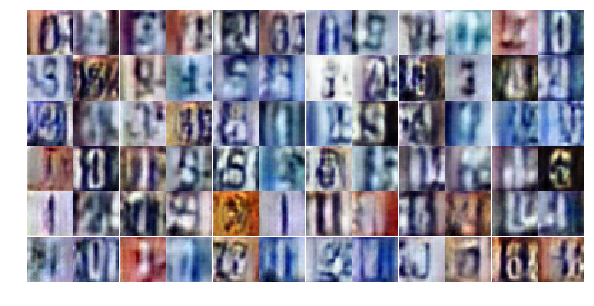

Epoch 6/25... Discriminator Loss: 0.7309... Generator Loss: 0.8489
Epoch 6/25... Discriminator Loss: 0.4574... Generator Loss: 3.5176
Epoch 6/25... Discriminator Loss: 1.0474... Generator Loss: 0.5707
Epoch 6/25... Discriminator Loss: 1.4057... Generator Loss: 0.3716
Epoch 6/25... Discriminator Loss: 0.2817... Generator Loss: 2.1521
Epoch 6/25... Discriminator Loss: 1.3420... Generator Loss: 0.4506
Epoch 6/25... Discriminator Loss: 0.3259... Generator Loss: 2.4581
Epoch 6/25... Discriminator Loss: 0.2784... Generator Loss: 3.1935
Epoch 6/25... Discriminator Loss: 0.3545... Generator Loss: 1.6648
Epoch 6/25... Discriminator Loss: 0.2954... Generator Loss: 2.1274


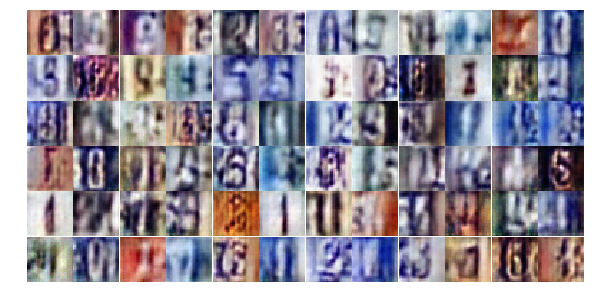

Epoch 6/25... Discriminator Loss: 0.4258... Generator Loss: 1.6021
Epoch 6/25... Discriminator Loss: 0.4500... Generator Loss: 1.3553
Epoch 6/25... Discriminator Loss: 0.5974... Generator Loss: 0.9818
Epoch 6/25... Discriminator Loss: 0.2803... Generator Loss: 1.9117
Epoch 6/25... Discriminator Loss: 1.1806... Generator Loss: 0.4859
Epoch 6/25... Discriminator Loss: 0.4750... Generator Loss: 1.3552
Epoch 6/25... Discriminator Loss: 0.1914... Generator Loss: 2.7051
Epoch 6/25... Discriminator Loss: 0.7435... Generator Loss: 5.4743
Epoch 6/25... Discriminator Loss: 0.7238... Generator Loss: 1.6247
Epoch 6/25... Discriminator Loss: 0.2749... Generator Loss: 2.1124


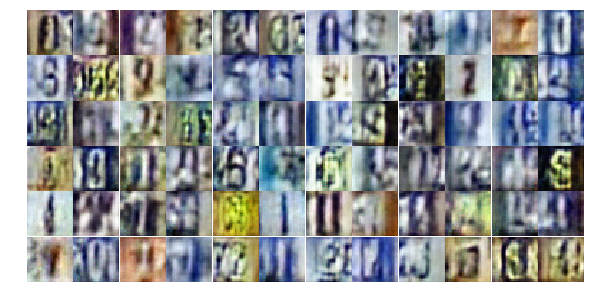

Epoch 6/25... Discriminator Loss: 0.3664... Generator Loss: 1.6976
Epoch 6/25... Discriminator Loss: 0.3619... Generator Loss: 1.5927
Epoch 6/25... Discriminator Loss: 1.1313... Generator Loss: 0.5504
Epoch 6/25... Discriminator Loss: 1.9203... Generator Loss: 3.8978
Epoch 6/25... Discriminator Loss: 0.8696... Generator Loss: 3.6683
Epoch 6/25... Discriminator Loss: 0.3262... Generator Loss: 1.9718
Epoch 6/25... Discriminator Loss: 0.2350... Generator Loss: 2.4683
Epoch 6/25... Discriminator Loss: 1.0166... Generator Loss: 0.6042
Epoch 6/25... Discriminator Loss: 0.2781... Generator Loss: 3.8385
Epoch 6/25... Discriminator Loss: 0.7334... Generator Loss: 0.9029


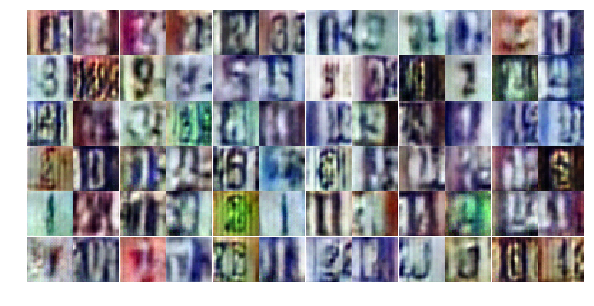

Epoch 6/25... Discriminator Loss: 0.3200... Generator Loss: 1.9863
Epoch 6/25... Discriminator Loss: 0.4659... Generator Loss: 1.4201
Epoch 6/25... Discriminator Loss: 0.5645... Generator Loss: 1.2562
Epoch 7/25... Discriminator Loss: 0.3081... Generator Loss: 2.5861
Epoch 7/25... Discriminator Loss: 0.3820... Generator Loss: 2.2119
Epoch 7/25... Discriminator Loss: 0.3184... Generator Loss: 3.2363
Epoch 7/25... Discriminator Loss: 0.3342... Generator Loss: 1.9756
Epoch 7/25... Discriminator Loss: 0.4225... Generator Loss: 1.4269
Epoch 7/25... Discriminator Loss: 0.2830... Generator Loss: 2.1264
Epoch 7/25... Discriminator Loss: 0.7674... Generator Loss: 0.8679


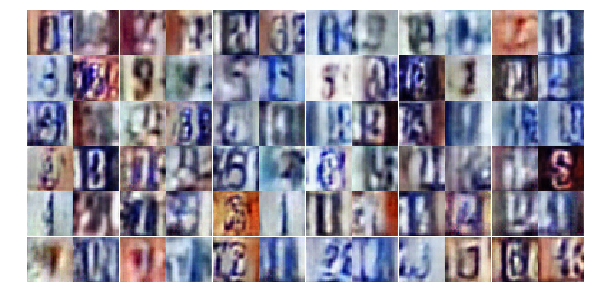

Epoch 7/25... Discriminator Loss: 0.4514... Generator Loss: 1.5557
Epoch 7/25... Discriminator Loss: 0.4322... Generator Loss: 1.5364
Epoch 7/25... Discriminator Loss: 1.1298... Generator Loss: 0.5550
Epoch 7/25... Discriminator Loss: 0.3281... Generator Loss: 2.7017
Epoch 7/25... Discriminator Loss: 2.4796... Generator Loss: 0.1471
Epoch 7/25... Discriminator Loss: 0.2226... Generator Loss: 2.9848
Epoch 7/25... Discriminator Loss: 0.6370... Generator Loss: 2.4074
Epoch 7/25... Discriminator Loss: 0.9919... Generator Loss: 3.3790
Epoch 7/25... Discriminator Loss: 0.6123... Generator Loss: 3.0844
Epoch 7/25... Discriminator Loss: 0.5675... Generator Loss: 1.1917


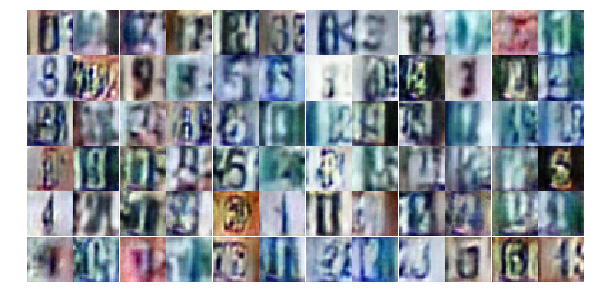

Epoch 7/25... Discriminator Loss: 0.3206... Generator Loss: 1.9216
Epoch 7/25... Discriminator Loss: 0.2697... Generator Loss: 1.8027
Epoch 7/25... Discriminator Loss: 0.6404... Generator Loss: 1.1615
Epoch 7/25... Discriminator Loss: 0.3642... Generator Loss: 1.5939
Epoch 7/25... Discriminator Loss: 0.3651... Generator Loss: 4.0089
Epoch 7/25... Discriminator Loss: 0.6093... Generator Loss: 1.0301
Epoch 7/25... Discriminator Loss: 0.3110... Generator Loss: 1.9599
Epoch 7/25... Discriminator Loss: 1.0550... Generator Loss: 0.6149
Epoch 7/25... Discriminator Loss: 0.1601... Generator Loss: 3.5596
Epoch 7/25... Discriminator Loss: 0.2660... Generator Loss: 2.2931


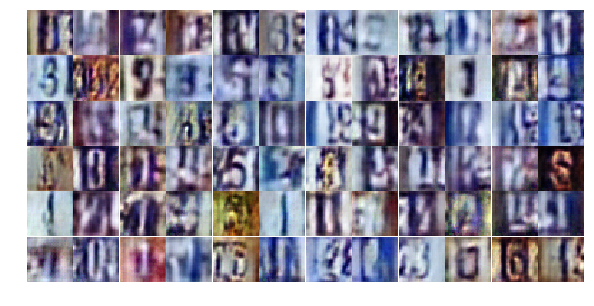

Epoch 7/25... Discriminator Loss: 1.4647... Generator Loss: 0.3623
Epoch 7/25... Discriminator Loss: 0.5403... Generator Loss: 1.2920
Epoch 7/25... Discriminator Loss: 0.2889... Generator Loss: 2.0904
Epoch 7/25... Discriminator Loss: 0.5466... Generator Loss: 1.1582
Epoch 7/25... Discriminator Loss: 0.3767... Generator Loss: 1.9491
Epoch 7/25... Discriminator Loss: 0.2314... Generator Loss: 2.1543
Epoch 7/25... Discriminator Loss: 0.1123... Generator Loss: 3.1267
Epoch 7/25... Discriminator Loss: 0.3520... Generator Loss: 1.7467
Epoch 7/25... Discriminator Loss: 0.5224... Generator Loss: 1.4683
Epoch 7/25... Discriminator Loss: 0.3502... Generator Loss: 1.9171


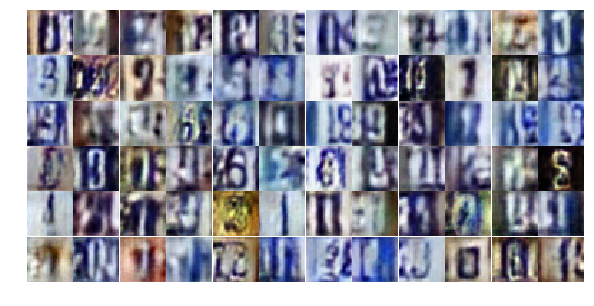

Epoch 7/25... Discriminator Loss: 1.1958... Generator Loss: 0.4642
Epoch 7/25... Discriminator Loss: 0.2515... Generator Loss: 2.3508
Epoch 7/25... Discriminator Loss: 1.2361... Generator Loss: 0.5020
Epoch 7/25... Discriminator Loss: 0.2107... Generator Loss: 2.2245
Epoch 7/25... Discriminator Loss: 0.2880... Generator Loss: 1.8767
Epoch 7/25... Discriminator Loss: 0.2459... Generator Loss: 2.2728
Epoch 7/25... Discriminator Loss: 0.1640... Generator Loss: 2.4624
Epoch 7/25... Discriminator Loss: 0.9386... Generator Loss: 0.7756
Epoch 7/25... Discriminator Loss: 0.8057... Generator Loss: 2.8558
Epoch 7/25... Discriminator Loss: 2.0990... Generator Loss: 0.2184


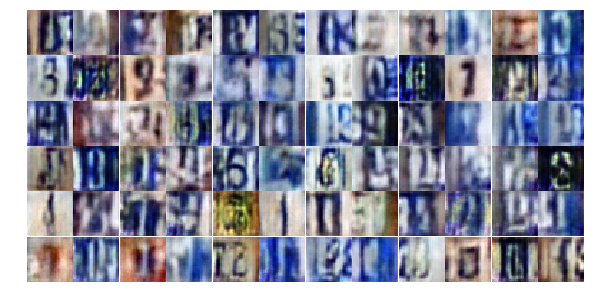

Epoch 7/25... Discriminator Loss: 0.4153... Generator Loss: 1.6815
Epoch 7/25... Discriminator Loss: 0.4944... Generator Loss: 1.3781
Epoch 7/25... Discriminator Loss: 0.5020... Generator Loss: 1.4991
Epoch 7/25... Discriminator Loss: 0.2499... Generator Loss: 2.1191
Epoch 7/25... Discriminator Loss: 0.5848... Generator Loss: 1.1872
Epoch 7/25... Discriminator Loss: 0.6349... Generator Loss: 1.0419
Epoch 7/25... Discriminator Loss: 0.7476... Generator Loss: 0.9246
Epoch 7/25... Discriminator Loss: 0.7261... Generator Loss: 0.9421
Epoch 7/25... Discriminator Loss: 0.8154... Generator Loss: 0.8308
Epoch 7/25... Discriminator Loss: 0.4779... Generator Loss: 1.6269


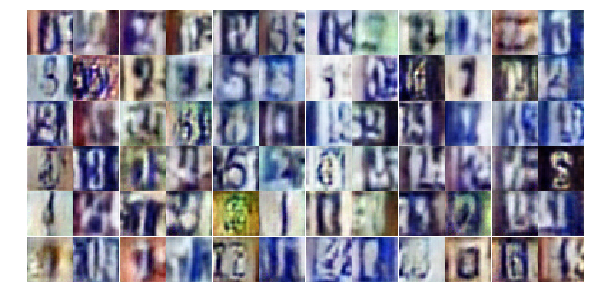

Epoch 7/25... Discriminator Loss: 0.2434... Generator Loss: 2.7590
Epoch 8/25... Discriminator Loss: 0.2509... Generator Loss: 2.4520
Epoch 8/25... Discriminator Loss: 1.1955... Generator Loss: 0.4701
Epoch 8/25... Discriminator Loss: 0.3333... Generator Loss: 1.8221
Epoch 8/25... Discriminator Loss: 0.3248... Generator Loss: 3.2554
Epoch 8/25... Discriminator Loss: 0.3971... Generator Loss: 1.7563
Epoch 8/25... Discriminator Loss: 1.0361... Generator Loss: 0.6038
Epoch 8/25... Discriminator Loss: 0.2233... Generator Loss: 2.4448
Epoch 8/25... Discriminator Loss: 0.4881... Generator Loss: 1.2580
Epoch 8/25... Discriminator Loss: 0.5847... Generator Loss: 1.1849


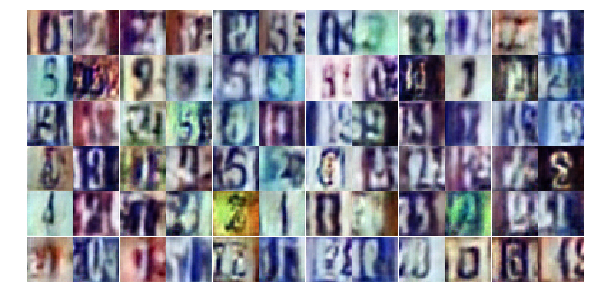

Epoch 8/25... Discriminator Loss: 0.2950... Generator Loss: 2.0137
Epoch 8/25... Discriminator Loss: 0.2267... Generator Loss: 3.9226
Epoch 8/25... Discriminator Loss: 0.3808... Generator Loss: 1.5328
Epoch 8/25... Discriminator Loss: 0.2333... Generator Loss: 2.3883
Epoch 8/25... Discriminator Loss: 1.1131... Generator Loss: 0.6826
Epoch 8/25... Discriminator Loss: 0.4588... Generator Loss: 2.6380
Epoch 8/25... Discriminator Loss: 0.7564... Generator Loss: 2.2416
Epoch 8/25... Discriminator Loss: 0.3818... Generator Loss: 2.2678
Epoch 8/25... Discriminator Loss: 0.5191... Generator Loss: 1.2710
Epoch 8/25... Discriminator Loss: 1.4192... Generator Loss: 0.3602


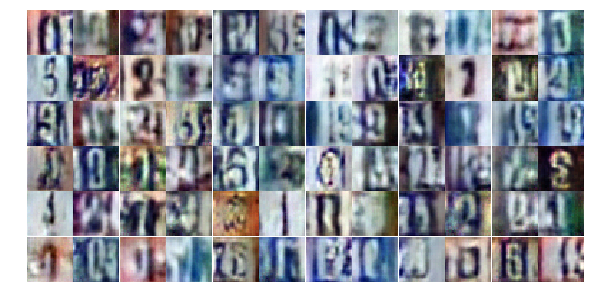

Epoch 8/25... Discriminator Loss: 0.3170... Generator Loss: 2.4123
Epoch 8/25... Discriminator Loss: 0.3560... Generator Loss: 1.8350
Epoch 8/25... Discriminator Loss: 0.6197... Generator Loss: 1.0152
Epoch 8/25... Discriminator Loss: 0.3841... Generator Loss: 1.8699
Epoch 8/25... Discriminator Loss: 0.2794... Generator Loss: 2.2270
Epoch 8/25... Discriminator Loss: 0.2725... Generator Loss: 2.2761
Epoch 8/25... Discriminator Loss: 1.3422... Generator Loss: 3.7534
Epoch 8/25... Discriminator Loss: 0.4316... Generator Loss: 1.4959
Epoch 8/25... Discriminator Loss: 0.9688... Generator Loss: 0.6989
Epoch 8/25... Discriminator Loss: 0.5361... Generator Loss: 1.2363


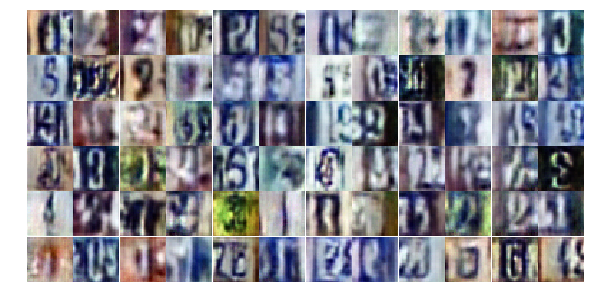

Epoch 8/25... Discriminator Loss: 0.3808... Generator Loss: 2.7321
Epoch 8/25... Discriminator Loss: 1.2084... Generator Loss: 0.4983
Epoch 8/25... Discriminator Loss: 0.3844... Generator Loss: 1.8867
Epoch 8/25... Discriminator Loss: 0.4317... Generator Loss: 1.3972
Epoch 8/25... Discriminator Loss: 0.1933... Generator Loss: 2.5586
Epoch 8/25... Discriminator Loss: 0.0719... Generator Loss: 4.8828
Epoch 8/25... Discriminator Loss: 0.3333... Generator Loss: 2.3576
Epoch 8/25... Discriminator Loss: 0.4111... Generator Loss: 1.4693
Epoch 8/25... Discriminator Loss: 0.3858... Generator Loss: 1.6230
Epoch 8/25... Discriminator Loss: 0.3006... Generator Loss: 1.8086


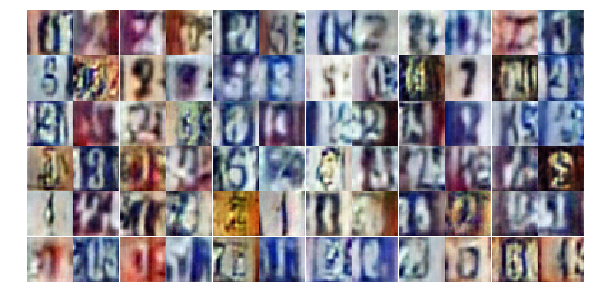

Epoch 8/25... Discriminator Loss: 0.3775... Generator Loss: 2.5487
Epoch 8/25... Discriminator Loss: 0.4931... Generator Loss: 1.2948
Epoch 8/25... Discriminator Loss: 0.2732... Generator Loss: 1.9246
Epoch 8/25... Discriminator Loss: 0.4342... Generator Loss: 1.3733
Epoch 8/25... Discriminator Loss: 0.2910... Generator Loss: 2.2665
Epoch 8/25... Discriminator Loss: 0.6179... Generator Loss: 3.2997
Epoch 8/25... Discriminator Loss: 2.1644... Generator Loss: 0.2523
Epoch 8/25... Discriminator Loss: 0.8503... Generator Loss: 1.8082
Epoch 8/25... Discriminator Loss: 0.7089... Generator Loss: 1.0267
Epoch 8/25... Discriminator Loss: 0.7567... Generator Loss: 1.0365


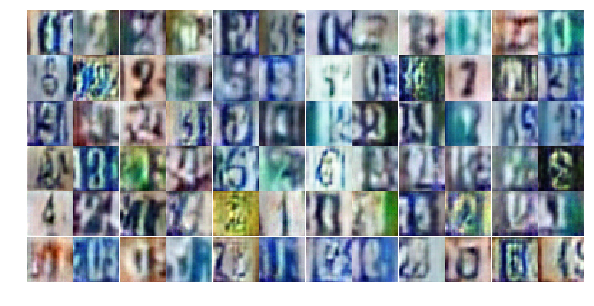

Epoch 8/25... Discriminator Loss: 0.4422... Generator Loss: 1.5426
Epoch 8/25... Discriminator Loss: 0.2550... Generator Loss: 3.1151
Epoch 8/25... Discriminator Loss: 0.4923... Generator Loss: 1.3871
Epoch 8/25... Discriminator Loss: 0.4023... Generator Loss: 1.6248
Epoch 8/25... Discriminator Loss: 0.4921... Generator Loss: 1.9161
Epoch 8/25... Discriminator Loss: 1.3682... Generator Loss: 0.3858
Epoch 8/25... Discriminator Loss: 0.8859... Generator Loss: 0.6962
Epoch 8/25... Discriminator Loss: 0.3723... Generator Loss: 1.5658
Epoch 9/25... Discriminator Loss: 0.7527... Generator Loss: 0.8461
Epoch 9/25... Discriminator Loss: 0.4707... Generator Loss: 1.3385


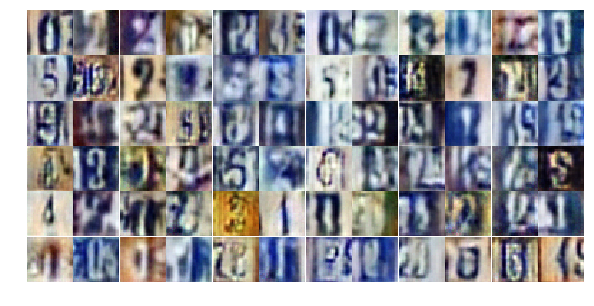

Epoch 9/25... Discriminator Loss: 0.4829... Generator Loss: 1.3656
Epoch 9/25... Discriminator Loss: 0.3382... Generator Loss: 2.7332
Epoch 9/25... Discriminator Loss: 0.8513... Generator Loss: 0.8213
Epoch 9/25... Discriminator Loss: 0.6114... Generator Loss: 1.0041
Epoch 9/25... Discriminator Loss: 0.5564... Generator Loss: 1.2743
Epoch 9/25... Discriminator Loss: 0.3233... Generator Loss: 3.3013
Epoch 9/25... Discriminator Loss: 0.2372... Generator Loss: 2.6105
Epoch 9/25... Discriminator Loss: 0.4635... Generator Loss: 1.2992
Epoch 9/25... Discriminator Loss: 0.8074... Generator Loss: 0.7764
Epoch 9/25... Discriminator Loss: 0.5832... Generator Loss: 1.6991


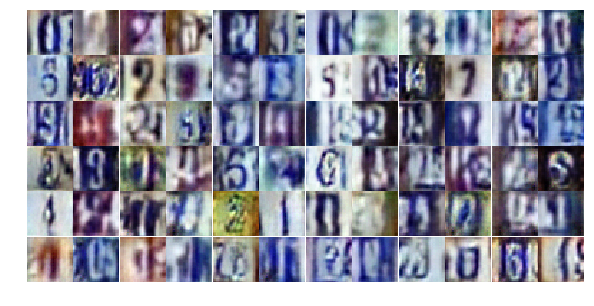

Epoch 9/25... Discriminator Loss: 0.7289... Generator Loss: 0.8644
Epoch 9/25... Discriminator Loss: 2.0745... Generator Loss: 0.2407
Epoch 9/25... Discriminator Loss: 0.5412... Generator Loss: 1.6096
Epoch 9/25... Discriminator Loss: 0.4749... Generator Loss: 1.3519
Epoch 9/25... Discriminator Loss: 0.4478... Generator Loss: 1.3530
Epoch 9/25... Discriminator Loss: 0.4765... Generator Loss: 1.3317
Epoch 9/25... Discriminator Loss: 0.5673... Generator Loss: 1.1289
Epoch 9/25... Discriminator Loss: 0.3485... Generator Loss: 1.6096
Epoch 9/25... Discriminator Loss: 0.6666... Generator Loss: 0.9838
Epoch 9/25... Discriminator Loss: 0.3892... Generator Loss: 1.6568


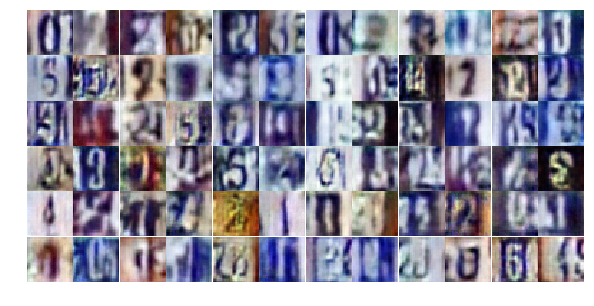

Epoch 9/25... Discriminator Loss: 0.7228... Generator Loss: 2.7891
Epoch 9/25... Discriminator Loss: 0.3032... Generator Loss: 2.7801
Epoch 9/25... Discriminator Loss: 0.5311... Generator Loss: 1.2602
Epoch 9/25... Discriminator Loss: 0.3386... Generator Loss: 1.8740
Epoch 9/25... Discriminator Loss: 1.4742... Generator Loss: 3.9739
Epoch 9/25... Discriminator Loss: 0.5649... Generator Loss: 2.0274
Epoch 9/25... Discriminator Loss: 0.8610... Generator Loss: 0.8894
Epoch 9/25... Discriminator Loss: 0.4948... Generator Loss: 1.3594
Epoch 9/25... Discriminator Loss: 0.3924... Generator Loss: 1.5289
Epoch 9/25... Discriminator Loss: 0.3762... Generator Loss: 1.7314


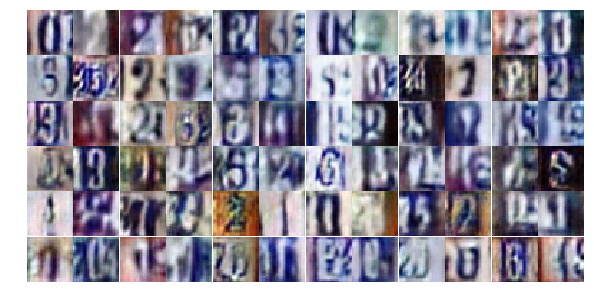

Epoch 9/25... Discriminator Loss: 0.4062... Generator Loss: 1.5312
Epoch 9/25... Discriminator Loss: 0.6666... Generator Loss: 0.9976
Epoch 9/25... Discriminator Loss: 0.8531... Generator Loss: 0.7781
Epoch 9/25... Discriminator Loss: 0.3522... Generator Loss: 2.2250
Epoch 9/25... Discriminator Loss: 0.3550... Generator Loss: 1.8595
Epoch 9/25... Discriminator Loss: 0.5568... Generator Loss: 1.1959
Epoch 9/25... Discriminator Loss: 0.2586... Generator Loss: 2.4411
Epoch 9/25... Discriminator Loss: 0.5307... Generator Loss: 1.1731
Epoch 9/25... Discriminator Loss: 0.4243... Generator Loss: 1.4408
Epoch 9/25... Discriminator Loss: 1.1543... Generator Loss: 0.5230


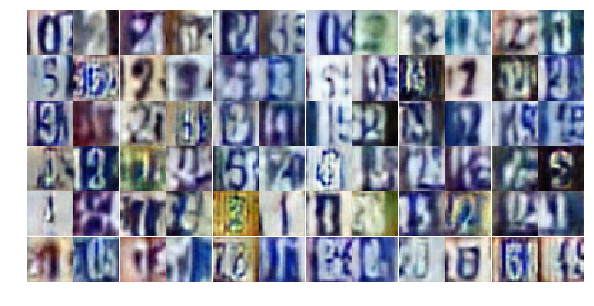

Epoch 9/25... Discriminator Loss: 0.5168... Generator Loss: 2.6749
Epoch 9/25... Discriminator Loss: 0.5217... Generator Loss: 1.2162
Epoch 9/25... Discriminator Loss: 0.8358... Generator Loss: 1.1524
Epoch 9/25... Discriminator Loss: 0.8132... Generator Loss: 1.7315
Epoch 9/25... Discriminator Loss: 0.4156... Generator Loss: 1.8764
Epoch 9/25... Discriminator Loss: 0.9184... Generator Loss: 0.7135
Epoch 9/25... Discriminator Loss: 0.8037... Generator Loss: 0.8182
Epoch 9/25... Discriminator Loss: 0.5340... Generator Loss: 1.2304
Epoch 9/25... Discriminator Loss: 0.3790... Generator Loss: 1.6844
Epoch 9/25... Discriminator Loss: 0.5115... Generator Loss: 3.2035


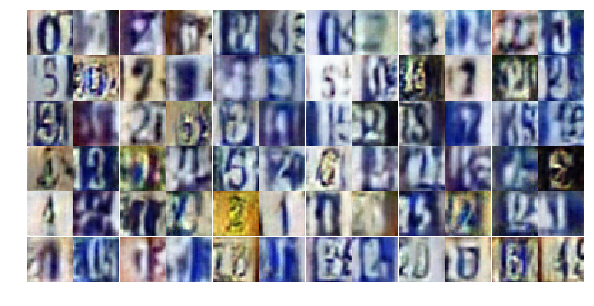

Epoch 9/25... Discriminator Loss: 0.7495... Generator Loss: 0.8827
Epoch 9/25... Discriminator Loss: 2.4003... Generator Loss: 4.1597
Epoch 9/25... Discriminator Loss: 0.4747... Generator Loss: 1.4774
Epoch 9/25... Discriminator Loss: 0.9566... Generator Loss: 0.7517
Epoch 9/25... Discriminator Loss: 0.3487... Generator Loss: 1.9187
Epoch 10/25... Discriminator Loss: 0.4545... Generator Loss: 1.3726
Epoch 10/25... Discriminator Loss: 0.3572... Generator Loss: 1.8848
Epoch 10/25... Discriminator Loss: 0.6001... Generator Loss: 1.0612
Epoch 10/25... Discriminator Loss: 0.8439... Generator Loss: 0.7697
Epoch 10/25... Discriminator Loss: 1.0947... Generator Loss: 0.5532


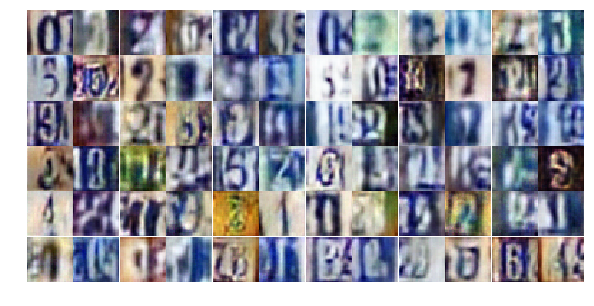

Epoch 10/25... Discriminator Loss: 2.0807... Generator Loss: 0.2631
Epoch 10/25... Discriminator Loss: 0.3540... Generator Loss: 1.6427
Epoch 10/25... Discriminator Loss: 0.3898... Generator Loss: 1.9056
Epoch 10/25... Discriminator Loss: 0.7455... Generator Loss: 1.0804
Epoch 10/25... Discriminator Loss: 0.9459... Generator Loss: 4.6811
Epoch 10/25... Discriminator Loss: 0.6842... Generator Loss: 1.0301
Epoch 10/25... Discriminator Loss: 0.5707... Generator Loss: 1.0893
Epoch 10/25... Discriminator Loss: 0.9789... Generator Loss: 0.6490
Epoch 10/25... Discriminator Loss: 0.7440... Generator Loss: 0.9392
Epoch 10/25... Discriminator Loss: 0.4848... Generator Loss: 1.4058


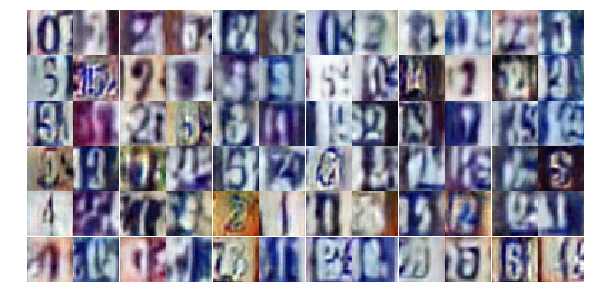

Epoch 10/25... Discriminator Loss: 0.4044... Generator Loss: 1.6248
Epoch 10/25... Discriminator Loss: 0.7713... Generator Loss: 0.8119
Epoch 10/25... Discriminator Loss: 0.3790... Generator Loss: 1.6530
Epoch 10/25... Discriminator Loss: 0.5034... Generator Loss: 1.3224
Epoch 10/25... Discriminator Loss: 0.2412... Generator Loss: 3.2286
Epoch 10/25... Discriminator Loss: 0.4527... Generator Loss: 1.5151
Epoch 10/25... Discriminator Loss: 0.4632... Generator Loss: 1.2966
Epoch 10/25... Discriminator Loss: 0.5045... Generator Loss: 1.4081
Epoch 10/25... Discriminator Loss: 0.2913... Generator Loss: 1.9844
Epoch 10/25... Discriminator Loss: 0.3312... Generator Loss: 2.6382


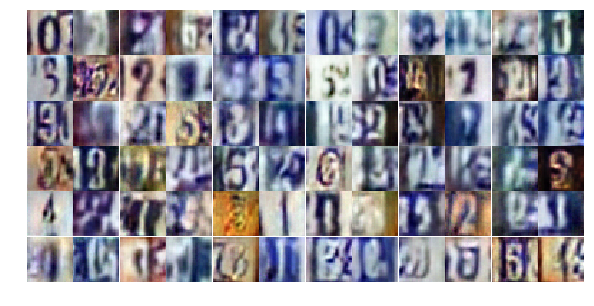

Epoch 10/25... Discriminator Loss: 0.9659... Generator Loss: 0.7018
Epoch 10/25... Discriminator Loss: 1.1277... Generator Loss: 0.6358
Epoch 10/25... Discriminator Loss: 0.1869... Generator Loss: 2.6473
Epoch 10/25... Discriminator Loss: 0.3086... Generator Loss: 2.0750
Epoch 10/25... Discriminator Loss: 0.5361... Generator Loss: 1.1963
Epoch 10/25... Discriminator Loss: 0.4279... Generator Loss: 1.4218
Epoch 10/25... Discriminator Loss: 0.3384... Generator Loss: 1.6408
Epoch 10/25... Discriminator Loss: 1.1534... Generator Loss: 0.4940
Epoch 10/25... Discriminator Loss: 0.3748... Generator Loss: 1.5213
Epoch 10/25... Discriminator Loss: 0.6666... Generator Loss: 2.3069


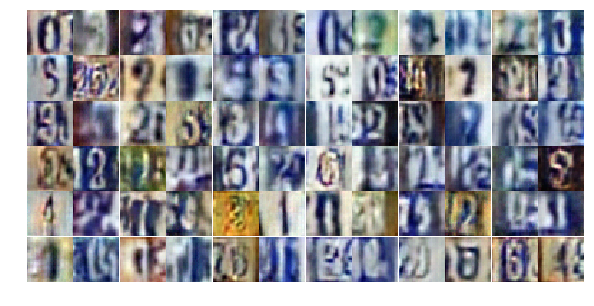

Epoch 10/25... Discriminator Loss: 0.4198... Generator Loss: 1.9012
Epoch 10/25... Discriminator Loss: 0.4436... Generator Loss: 1.4814
Epoch 10/25... Discriminator Loss: 0.2238... Generator Loss: 2.5566
Epoch 10/25... Discriminator Loss: 0.4408... Generator Loss: 1.6159
Epoch 10/25... Discriminator Loss: 0.5183... Generator Loss: 1.1347
Epoch 10/25... Discriminator Loss: 1.0865... Generator Loss: 0.5808
Epoch 10/25... Discriminator Loss: 0.7069... Generator Loss: 0.9160
Epoch 10/25... Discriminator Loss: 0.8865... Generator Loss: 0.7049
Epoch 10/25... Discriminator Loss: 0.5931... Generator Loss: 1.0501
Epoch 10/25... Discriminator Loss: 0.4930... Generator Loss: 1.5843


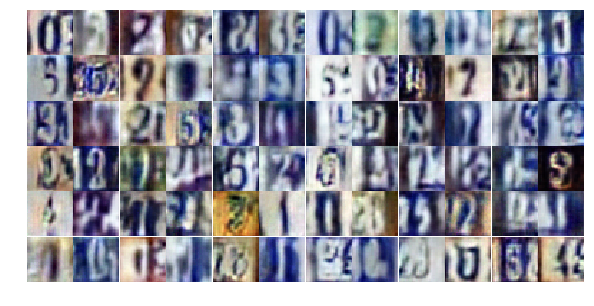

Epoch 10/25... Discriminator Loss: 3.5779... Generator Loss: 0.2815
Epoch 10/25... Discriminator Loss: 1.3396... Generator Loss: 1.6005
Epoch 10/25... Discriminator Loss: 1.9045... Generator Loss: 0.2719
Epoch 10/25... Discriminator Loss: 0.8225... Generator Loss: 0.9444
Epoch 10/25... Discriminator Loss: 0.3904... Generator Loss: 2.1615
Epoch 10/25... Discriminator Loss: 0.4952... Generator Loss: 1.5060
Epoch 10/25... Discriminator Loss: 0.5137... Generator Loss: 1.3108
Epoch 10/25... Discriminator Loss: 0.3975... Generator Loss: 1.7708
Epoch 10/25... Discriminator Loss: 1.1114... Generator Loss: 3.6001
Epoch 10/25... Discriminator Loss: 0.6417... Generator Loss: 1.2722


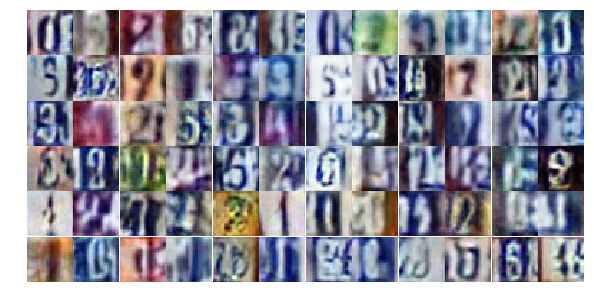

Epoch 10/25... Discriminator Loss: 0.5399... Generator Loss: 1.3243
Epoch 10/25... Discriminator Loss: 0.3484... Generator Loss: 1.7803
Epoch 10/25... Discriminator Loss: 0.4397... Generator Loss: 1.3273
Epoch 11/25... Discriminator Loss: 0.5935... Generator Loss: 1.3666
Epoch 11/25... Discriminator Loss: 0.5880... Generator Loss: 1.0883
Epoch 11/25... Discriminator Loss: 1.2270... Generator Loss: 0.4889
Epoch 11/25... Discriminator Loss: 0.6692... Generator Loss: 1.0216
Epoch 11/25... Discriminator Loss: 0.5639... Generator Loss: 1.2065
Epoch 11/25... Discriminator Loss: 1.6047... Generator Loss: 0.3707
Epoch 11/25... Discriminator Loss: 0.4323... Generator Loss: 1.7277


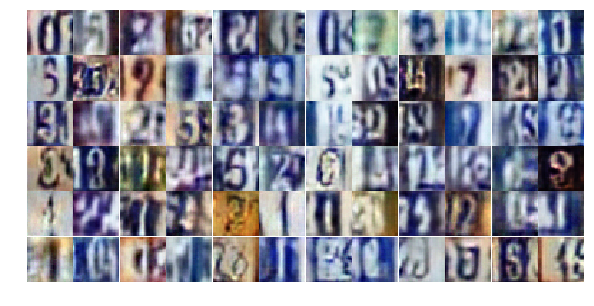

Epoch 11/25... Discriminator Loss: 0.4362... Generator Loss: 2.0866
Epoch 11/25... Discriminator Loss: 0.6085... Generator Loss: 1.4351
Epoch 11/25... Discriminator Loss: 0.4764... Generator Loss: 1.3501
Epoch 11/25... Discriminator Loss: 0.4140... Generator Loss: 1.7096
Epoch 11/25... Discriminator Loss: 0.6496... Generator Loss: 1.0382
Epoch 11/25... Discriminator Loss: 0.3654... Generator Loss: 1.6288
Epoch 11/25... Discriminator Loss: 0.4309... Generator Loss: 1.6296
Epoch 11/25... Discriminator Loss: 0.5803... Generator Loss: 1.6675
Epoch 11/25... Discriminator Loss: 1.1293... Generator Loss: 0.5595
Epoch 11/25... Discriminator Loss: 1.5488... Generator Loss: 0.3173


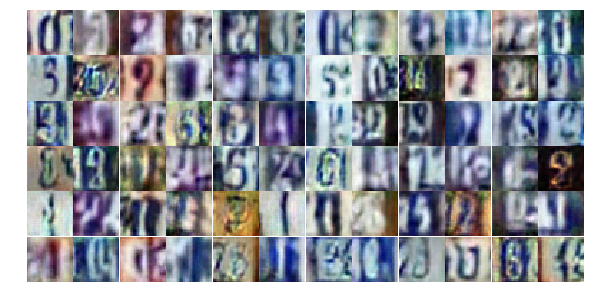

Epoch 11/25... Discriminator Loss: 0.9749... Generator Loss: 0.6438
Epoch 11/25... Discriminator Loss: 0.4617... Generator Loss: 1.7236
Epoch 11/25... Discriminator Loss: 0.3209... Generator Loss: 1.8115
Epoch 11/25... Discriminator Loss: 0.5685... Generator Loss: 1.1235
Epoch 11/25... Discriminator Loss: 0.4569... Generator Loss: 1.3592
Epoch 11/25... Discriminator Loss: 0.3404... Generator Loss: 1.6502
Epoch 11/25... Discriminator Loss: 0.4996... Generator Loss: 1.2273
Epoch 11/25... Discriminator Loss: 0.9071... Generator Loss: 0.7040
Epoch 11/25... Discriminator Loss: 0.3034... Generator Loss: 1.9351
Epoch 11/25... Discriminator Loss: 0.7595... Generator Loss: 0.9247


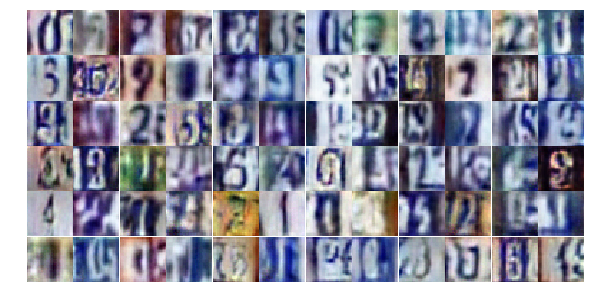

Epoch 11/25... Discriminator Loss: 0.7144... Generator Loss: 0.9455
Epoch 11/25... Discriminator Loss: 0.4615... Generator Loss: 1.5235
Epoch 11/25... Discriminator Loss: 0.7495... Generator Loss: 0.8990
Epoch 11/25... Discriminator Loss: 0.3699... Generator Loss: 1.4656
Epoch 11/25... Discriminator Loss: 0.4725... Generator Loss: 1.3631
Epoch 11/25... Discriminator Loss: 1.3439... Generator Loss: 0.3820
Epoch 11/25... Discriminator Loss: 1.4606... Generator Loss: 0.4060
Epoch 11/25... Discriminator Loss: 0.7724... Generator Loss: 0.9083
Epoch 11/25... Discriminator Loss: 0.5924... Generator Loss: 1.1171
Epoch 11/25... Discriminator Loss: 0.8409... Generator Loss: 0.8547


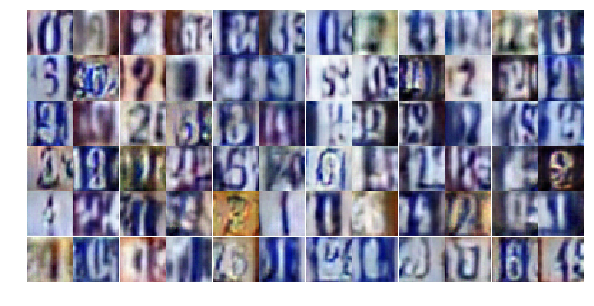

Epoch 11/25... Discriminator Loss: 0.3674... Generator Loss: 1.5591
Epoch 11/25... Discriminator Loss: 0.5480... Generator Loss: 1.1671
Epoch 11/25... Discriminator Loss: 0.4471... Generator Loss: 1.3760
Epoch 11/25... Discriminator Loss: 0.4295... Generator Loss: 2.0148
Epoch 11/25... Discriminator Loss: 1.2100... Generator Loss: 0.4630
Epoch 11/25... Discriminator Loss: 0.6234... Generator Loss: 0.9837
Epoch 11/25... Discriminator Loss: 0.2653... Generator Loss: 2.2352
Epoch 11/25... Discriminator Loss: 0.4492... Generator Loss: 1.3306
Epoch 11/25... Discriminator Loss: 1.6313... Generator Loss: 0.2968
Epoch 11/25... Discriminator Loss: 0.3044... Generator Loss: 1.9574


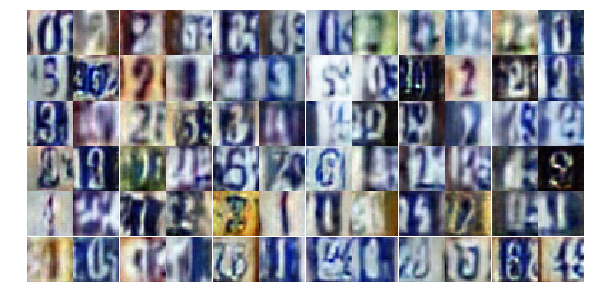

Epoch 11/25... Discriminator Loss: 0.7206... Generator Loss: 3.0948
Epoch 11/25... Discriminator Loss: 0.3540... Generator Loss: 1.7388
Epoch 11/25... Discriminator Loss: 0.6407... Generator Loss: 1.0364
Epoch 11/25... Discriminator Loss: 0.5738... Generator Loss: 1.1003
Epoch 11/25... Discriminator Loss: 0.7236... Generator Loss: 0.8532
Epoch 11/25... Discriminator Loss: 0.3930... Generator Loss: 1.6131
Epoch 11/25... Discriminator Loss: 0.7650... Generator Loss: 0.8275
Epoch 11/25... Discriminator Loss: 0.4908... Generator Loss: 2.7319
Epoch 11/25... Discriminator Loss: 1.3067... Generator Loss: 0.4468
Epoch 11/25... Discriminator Loss: 0.6283... Generator Loss: 1.1704


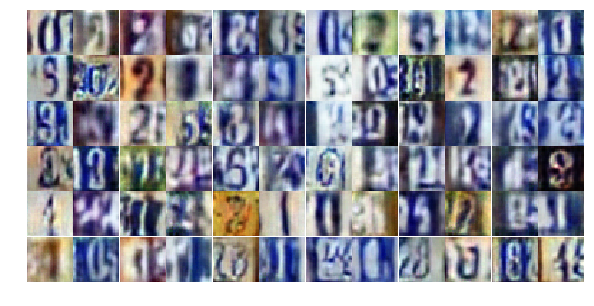

Epoch 12/25... Discriminator Loss: 0.6359... Generator Loss: 2.7293
Epoch 12/25... Discriminator Loss: 0.5877... Generator Loss: 1.3207
Epoch 12/25... Discriminator Loss: 0.8346... Generator Loss: 0.7997
Epoch 12/25... Discriminator Loss: 0.4573... Generator Loss: 1.3772
Epoch 12/25... Discriminator Loss: 0.4164... Generator Loss: 1.5380
Epoch 12/25... Discriminator Loss: 0.6120... Generator Loss: 1.0320
Epoch 12/25... Discriminator Loss: 0.7724... Generator Loss: 3.3956
Epoch 12/25... Discriminator Loss: 0.4518... Generator Loss: 2.1356
Epoch 12/25... Discriminator Loss: 0.4703... Generator Loss: 1.4833
Epoch 12/25... Discriminator Loss: 1.2237... Generator Loss: 0.4904


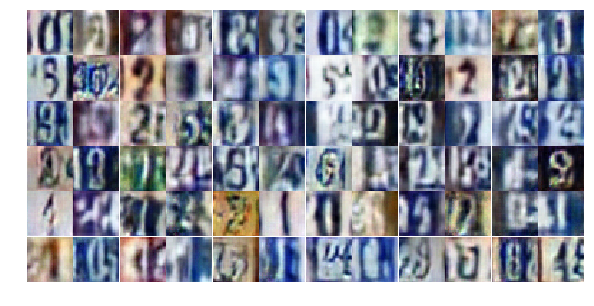

Epoch 12/25... Discriminator Loss: 0.4211... Generator Loss: 1.5749
Epoch 12/25... Discriminator Loss: 0.6644... Generator Loss: 1.6552
Epoch 12/25... Discriminator Loss: 0.4656... Generator Loss: 1.3241
Epoch 12/25... Discriminator Loss: 0.3188... Generator Loss: 2.5296
Epoch 12/25... Discriminator Loss: 0.3412... Generator Loss: 2.0302
Epoch 12/25... Discriminator Loss: 0.9463... Generator Loss: 0.7174
Epoch 12/25... Discriminator Loss: 1.4500... Generator Loss: 0.3649
Epoch 12/25... Discriminator Loss: 0.4249... Generator Loss: 2.4804
Epoch 12/25... Discriminator Loss: 0.4496... Generator Loss: 2.4497
Epoch 12/25... Discriminator Loss: 0.5107... Generator Loss: 1.4543


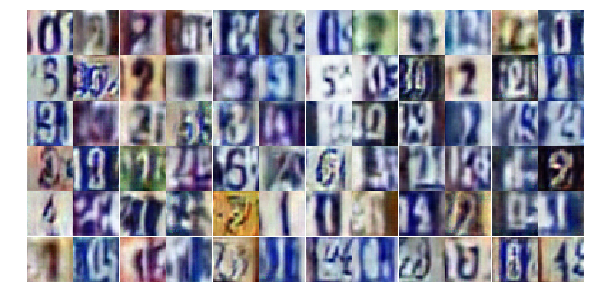

Epoch 12/25... Discriminator Loss: 0.3562... Generator Loss: 1.4765
Epoch 12/25... Discriminator Loss: 0.3865... Generator Loss: 1.4990
Epoch 12/25... Discriminator Loss: 0.3680... Generator Loss: 1.8938
Epoch 12/25... Discriminator Loss: 0.3666... Generator Loss: 1.6991
Epoch 12/25... Discriminator Loss: 0.3151... Generator Loss: 1.9830
Epoch 12/25... Discriminator Loss: 0.6586... Generator Loss: 0.9659
Epoch 12/25... Discriminator Loss: 0.5737... Generator Loss: 1.2153
Epoch 12/25... Discriminator Loss: 0.2217... Generator Loss: 2.8421
Epoch 12/25... Discriminator Loss: 1.2572... Generator Loss: 4.8533
Epoch 12/25... Discriminator Loss: 0.9245... Generator Loss: 0.8105


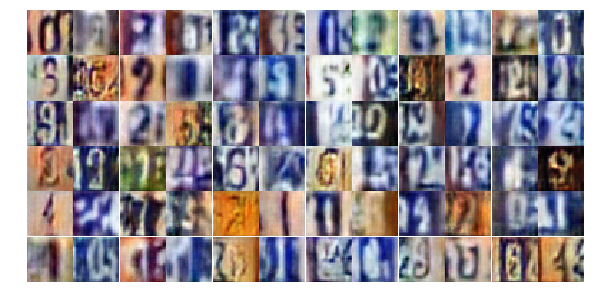

Epoch 12/25... Discriminator Loss: 0.7205... Generator Loss: 0.9423
Epoch 12/25... Discriminator Loss: 0.7297... Generator Loss: 0.9225
Epoch 12/25... Discriminator Loss: 0.7095... Generator Loss: 0.9204
Epoch 12/25... Discriminator Loss: 1.6799... Generator Loss: 0.3219
Epoch 12/25... Discriminator Loss: 0.5463... Generator Loss: 2.2765
Epoch 12/25... Discriminator Loss: 0.6838... Generator Loss: 1.0117
Epoch 12/25... Discriminator Loss: 0.9736... Generator Loss: 0.6246
Epoch 12/25... Discriminator Loss: 0.7829... Generator Loss: 1.0254
Epoch 12/25... Discriminator Loss: 0.3161... Generator Loss: 1.9162
Epoch 12/25... Discriminator Loss: 0.4092... Generator Loss: 1.3559


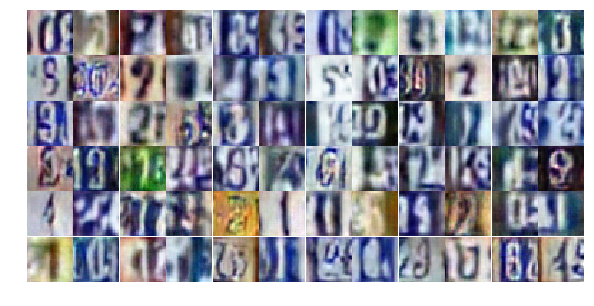

Epoch 12/25... Discriminator Loss: 0.5441... Generator Loss: 1.1036
Epoch 12/25... Discriminator Loss: 0.5154... Generator Loss: 1.2324
Epoch 12/25... Discriminator Loss: 0.3511... Generator Loss: 1.7135
Epoch 12/25... Discriminator Loss: 0.8141... Generator Loss: 0.8611
Epoch 12/25... Discriminator Loss: 0.6817... Generator Loss: 2.1075
Epoch 12/25... Discriminator Loss: 0.7565... Generator Loss: 0.9697
Epoch 12/25... Discriminator Loss: 0.5644... Generator Loss: 1.2839
Epoch 12/25... Discriminator Loss: 0.8779... Generator Loss: 0.7993
Epoch 12/25... Discriminator Loss: 0.4576... Generator Loss: 1.5242
Epoch 12/25... Discriminator Loss: 0.5351... Generator Loss: 1.2715


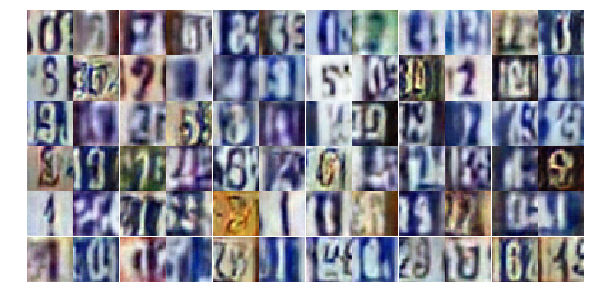

Epoch 12/25... Discriminator Loss: 0.7034... Generator Loss: 1.0985
Epoch 12/25... Discriminator Loss: 0.3167... Generator Loss: 2.0606
Epoch 12/25... Discriminator Loss: 0.6663... Generator Loss: 1.5727
Epoch 12/25... Discriminator Loss: 1.0843... Generator Loss: 1.6476
Epoch 12/25... Discriminator Loss: 0.2779... Generator Loss: 1.9790
Epoch 12/25... Discriminator Loss: 0.5107... Generator Loss: 1.4625
Epoch 12/25... Discriminator Loss: 0.7095... Generator Loss: 0.9294
Epoch 13/25... Discriminator Loss: 0.3892... Generator Loss: 1.7317
Epoch 13/25... Discriminator Loss: 0.3584... Generator Loss: 1.7057
Epoch 13/25... Discriminator Loss: 0.7634... Generator Loss: 0.8225


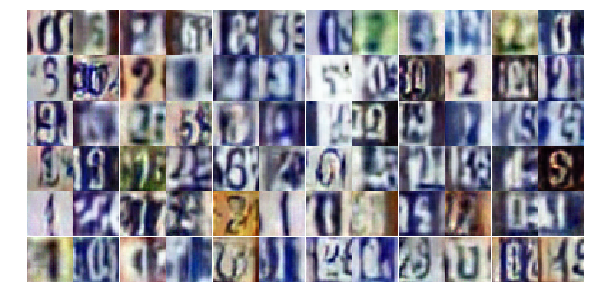

Epoch 13/25... Discriminator Loss: 0.4410... Generator Loss: 1.5959
Epoch 13/25... Discriminator Loss: 0.5508... Generator Loss: 1.1594
Epoch 13/25... Discriminator Loss: 0.7817... Generator Loss: 1.3738
Epoch 13/25... Discriminator Loss: 1.5695... Generator Loss: 0.3786
Epoch 13/25... Discriminator Loss: 0.5141... Generator Loss: 1.5146
Epoch 13/25... Discriminator Loss: 0.6870... Generator Loss: 0.9645
Epoch 13/25... Discriminator Loss: 0.3579... Generator Loss: 2.0288
Epoch 13/25... Discriminator Loss: 0.8130... Generator Loss: 0.7646
Epoch 13/25... Discriminator Loss: 0.5876... Generator Loss: 1.0744
Epoch 13/25... Discriminator Loss: 0.3281... Generator Loss: 1.8181


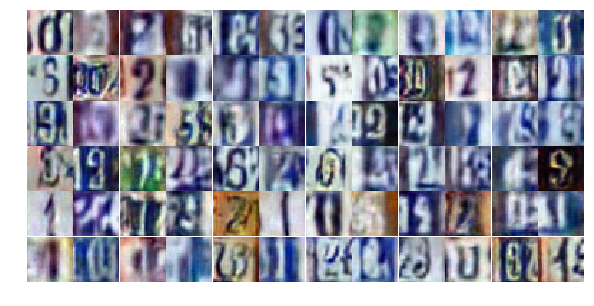

Epoch 13/25... Discriminator Loss: 0.5446... Generator Loss: 1.4207
Epoch 13/25... Discriminator Loss: 0.8866... Generator Loss: 2.9166
Epoch 13/25... Discriminator Loss: 1.7807... Generator Loss: 0.2775
Epoch 13/25... Discriminator Loss: 0.4809... Generator Loss: 1.5182
Epoch 13/25... Discriminator Loss: 0.5293... Generator Loss: 1.1968
Epoch 13/25... Discriminator Loss: 1.0555... Generator Loss: 0.5835
Epoch 13/25... Discriminator Loss: 0.6534... Generator Loss: 1.0199
Epoch 13/25... Discriminator Loss: 0.7995... Generator Loss: 0.8818
Epoch 13/25... Discriminator Loss: 0.5923... Generator Loss: 1.0195
Epoch 13/25... Discriminator Loss: 1.0697... Generator Loss: 0.6540


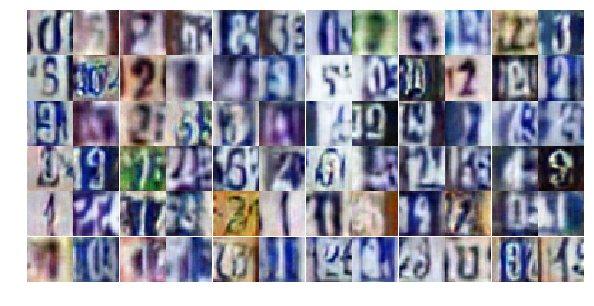

Epoch 13/25... Discriminator Loss: 0.5892... Generator Loss: 1.1592
Epoch 13/25... Discriminator Loss: 0.4327... Generator Loss: 1.8644
Epoch 13/25... Discriminator Loss: 0.5694... Generator Loss: 1.3253
Epoch 13/25... Discriminator Loss: 0.8709... Generator Loss: 0.6843
Epoch 13/25... Discriminator Loss: 0.3349... Generator Loss: 1.8336
Epoch 13/25... Discriminator Loss: 0.3455... Generator Loss: 1.8260
Epoch 13/25... Discriminator Loss: 0.4976... Generator Loss: 1.3563
Epoch 13/25... Discriminator Loss: 0.4889... Generator Loss: 1.2903
Epoch 13/25... Discriminator Loss: 0.5143... Generator Loss: 1.5889
Epoch 13/25... Discriminator Loss: 0.2499... Generator Loss: 2.4656


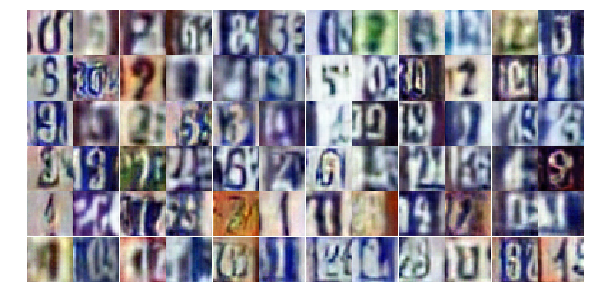

Epoch 13/25... Discriminator Loss: 1.2304... Generator Loss: 0.4449
Epoch 13/25... Discriminator Loss: 1.7092... Generator Loss: 0.3919
Epoch 13/25... Discriminator Loss: 0.6133... Generator Loss: 1.2416
Epoch 13/25... Discriminator Loss: 0.9887... Generator Loss: 0.6548
Epoch 13/25... Discriminator Loss: 0.5253... Generator Loss: 1.3630
Epoch 13/25... Discriminator Loss: 0.4522... Generator Loss: 1.3135
Epoch 13/25... Discriminator Loss: 0.3159... Generator Loss: 1.8489
Epoch 13/25... Discriminator Loss: 0.4750... Generator Loss: 1.4428
Epoch 13/25... Discriminator Loss: 0.7807... Generator Loss: 0.8787
Epoch 13/25... Discriminator Loss: 0.3772... Generator Loss: 1.5664


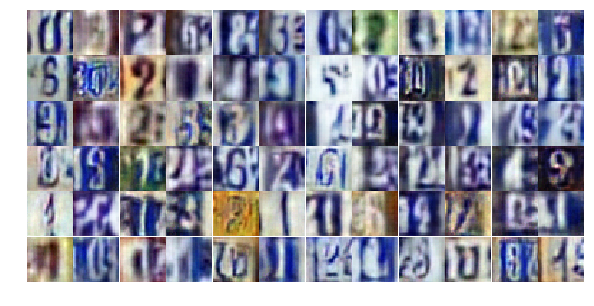

Epoch 13/25... Discriminator Loss: 0.4115... Generator Loss: 1.4685
Epoch 13/25... Discriminator Loss: 0.6467... Generator Loss: 1.1873
Epoch 13/25... Discriminator Loss: 0.4705... Generator Loss: 1.6328
Epoch 13/25... Discriminator Loss: 0.6584... Generator Loss: 1.0529
Epoch 13/25... Discriminator Loss: 0.7735... Generator Loss: 0.8796
Epoch 13/25... Discriminator Loss: 0.5300... Generator Loss: 1.2926
Epoch 13/25... Discriminator Loss: 0.4574... Generator Loss: 1.4513
Epoch 13/25... Discriminator Loss: 0.3926... Generator Loss: 1.6548
Epoch 13/25... Discriminator Loss: 0.5572... Generator Loss: 1.1782
Epoch 13/25... Discriminator Loss: 0.7766... Generator Loss: 0.8840


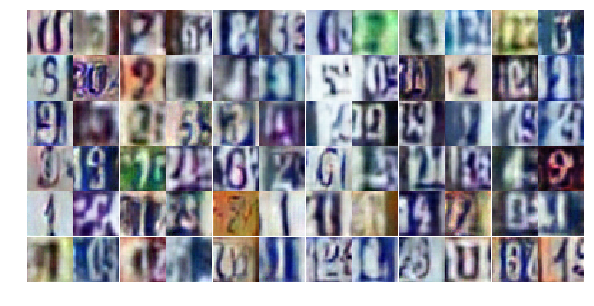

Epoch 13/25... Discriminator Loss: 0.2840... Generator Loss: 2.8155
Epoch 13/25... Discriminator Loss: 0.4979... Generator Loss: 1.4424
Epoch 13/25... Discriminator Loss: 0.6589... Generator Loss: 2.3492
Epoch 13/25... Discriminator Loss: 0.9086... Generator Loss: 0.7406
Epoch 14/25... Discriminator Loss: 1.0332... Generator Loss: 0.6120
Epoch 14/25... Discriminator Loss: 0.6507... Generator Loss: 1.1755
Epoch 14/25... Discriminator Loss: 1.2491... Generator Loss: 0.4438
Epoch 14/25... Discriminator Loss: 0.4672... Generator Loss: 1.5402
Epoch 14/25... Discriminator Loss: 0.4605... Generator Loss: 1.4678
Epoch 14/25... Discriminator Loss: 0.8302... Generator Loss: 0.8264


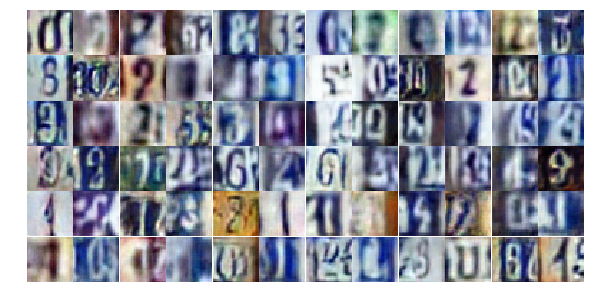

Epoch 14/25... Discriminator Loss: 1.1671... Generator Loss: 3.7419
Epoch 14/25... Discriminator Loss: 0.9904... Generator Loss: 0.7172
Epoch 14/25... Discriminator Loss: 0.6104... Generator Loss: 1.1604
Epoch 14/25... Discriminator Loss: 0.4198... Generator Loss: 1.5069
Epoch 14/25... Discriminator Loss: 1.0740... Generator Loss: 0.6043
Epoch 14/25... Discriminator Loss: 0.4535... Generator Loss: 1.2654
Epoch 14/25... Discriminator Loss: 0.2802... Generator Loss: 2.0433
Epoch 14/25... Discriminator Loss: 2.0278... Generator Loss: 0.2291
Epoch 14/25... Discriminator Loss: 0.9360... Generator Loss: 0.7066
Epoch 14/25... Discriminator Loss: 1.1358... Generator Loss: 0.6201


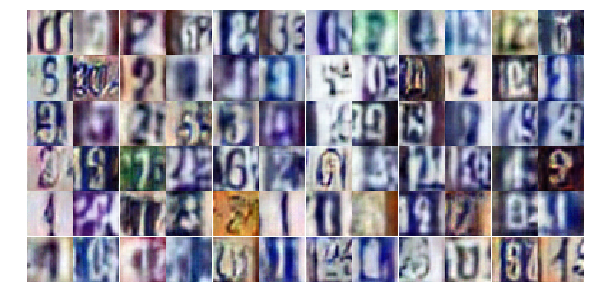

Epoch 14/25... Discriminator Loss: 0.5451... Generator Loss: 1.0974
Epoch 14/25... Discriminator Loss: 0.3204... Generator Loss: 2.3943
Epoch 14/25... Discriminator Loss: 0.9086... Generator Loss: 0.7230
Epoch 14/25... Discriminator Loss: 0.3441... Generator Loss: 1.6841
Epoch 14/25... Discriminator Loss: 0.8974... Generator Loss: 0.6964
Epoch 14/25... Discriminator Loss: 0.5603... Generator Loss: 1.1863
Epoch 14/25... Discriminator Loss: 0.5073... Generator Loss: 1.3253
Epoch 14/25... Discriminator Loss: 0.6099... Generator Loss: 0.9916
Epoch 14/25... Discriminator Loss: 0.6807... Generator Loss: 0.9990
Epoch 14/25... Discriminator Loss: 0.2973... Generator Loss: 1.8735


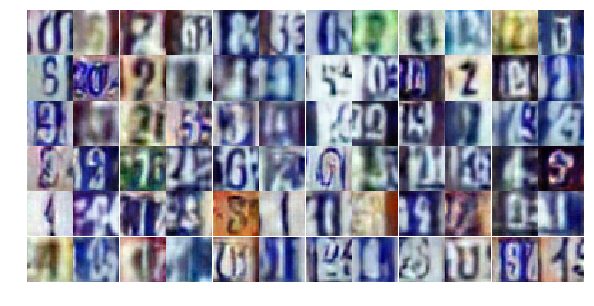

Epoch 14/25... Discriminator Loss: 1.5180... Generator Loss: 0.3360
Epoch 14/25... Discriminator Loss: 0.3446... Generator Loss: 1.8804
Epoch 14/25... Discriminator Loss: 0.4076... Generator Loss: 2.6494
Epoch 14/25... Discriminator Loss: 1.4280... Generator Loss: 3.9263
Epoch 14/25... Discriminator Loss: 0.5622... Generator Loss: 1.8635
Epoch 14/25... Discriminator Loss: 0.6802... Generator Loss: 1.2304
Epoch 14/25... Discriminator Loss: 0.6497... Generator Loss: 1.1253
Epoch 14/25... Discriminator Loss: 0.4055... Generator Loss: 1.5752
Epoch 14/25... Discriminator Loss: 0.4878... Generator Loss: 1.5235
Epoch 14/25... Discriminator Loss: 0.5370... Generator Loss: 1.6717


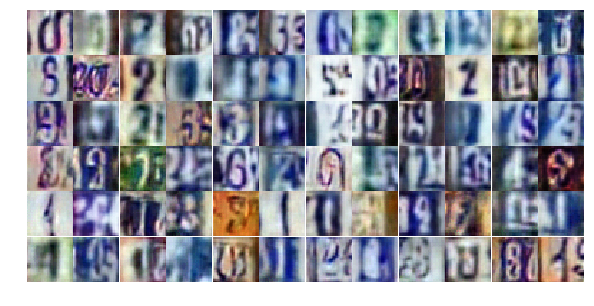

Epoch 14/25... Discriminator Loss: 1.3905... Generator Loss: 0.4050
Epoch 14/25... Discriminator Loss: 0.8476... Generator Loss: 0.7264
Epoch 14/25... Discriminator Loss: 0.8507... Generator Loss: 0.7377
Epoch 14/25... Discriminator Loss: 0.7144... Generator Loss: 0.9455
Epoch 14/25... Discriminator Loss: 0.7934... Generator Loss: 0.7864
Epoch 14/25... Discriminator Loss: 0.5633... Generator Loss: 1.1817
Epoch 14/25... Discriminator Loss: 0.8224... Generator Loss: 0.7480
Epoch 14/25... Discriminator Loss: 0.4537... Generator Loss: 1.8981
Epoch 14/25... Discriminator Loss: 1.8813... Generator Loss: 0.2663
Epoch 14/25... Discriminator Loss: 0.7203... Generator Loss: 1.1321


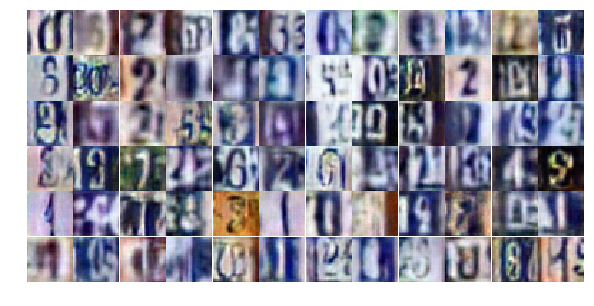

Epoch 14/25... Discriminator Loss: 0.8203... Generator Loss: 0.9144
Epoch 14/25... Discriminator Loss: 1.3567... Generator Loss: 0.4042
Epoch 14/25... Discriminator Loss: 0.4652... Generator Loss: 1.4302
Epoch 14/25... Discriminator Loss: 0.3445... Generator Loss: 1.8996
Epoch 14/25... Discriminator Loss: 0.4060... Generator Loss: 1.4817
Epoch 14/25... Discriminator Loss: 0.5999... Generator Loss: 1.0180
Epoch 14/25... Discriminator Loss: 0.5822... Generator Loss: 1.9251
Epoch 14/25... Discriminator Loss: 0.4632... Generator Loss: 1.4428
Epoch 14/25... Discriminator Loss: 1.5356... Generator Loss: 0.3931
Epoch 14/25... Discriminator Loss: 1.5297... Generator Loss: 0.3527


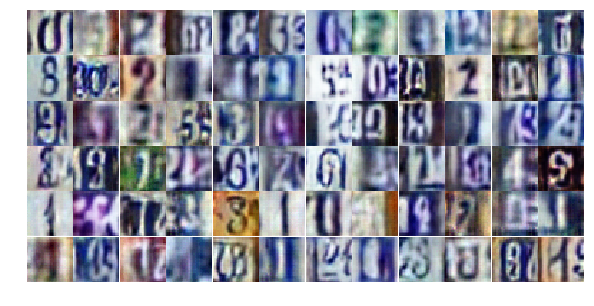

Epoch 14/25... Discriminator Loss: 0.8458... Generator Loss: 0.9012
Epoch 14/25... Discriminator Loss: 0.7912... Generator Loss: 0.8635
Epoch 15/25... Discriminator Loss: 0.4816... Generator Loss: 1.4718
Epoch 15/25... Discriminator Loss: 0.3923... Generator Loss: 1.6378
Epoch 15/25... Discriminator Loss: 0.6500... Generator Loss: 1.0575
Epoch 15/25... Discriminator Loss: 0.7687... Generator Loss: 0.8330
Epoch 15/25... Discriminator Loss: 0.6325... Generator Loss: 0.9841
Epoch 15/25... Discriminator Loss: 0.4945... Generator Loss: 1.2943
Epoch 15/25... Discriminator Loss: 1.3596... Generator Loss: 0.4734
Epoch 15/25... Discriminator Loss: 0.4766... Generator Loss: 1.4753


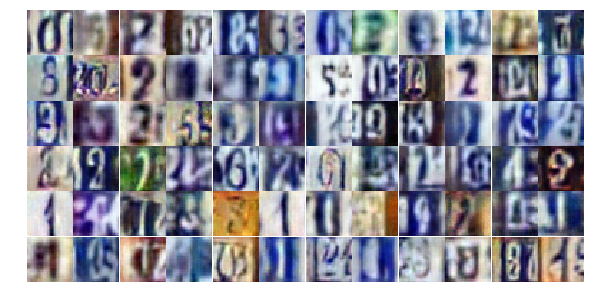

Epoch 15/25... Discriminator Loss: 0.6167... Generator Loss: 1.1561
Epoch 15/25... Discriminator Loss: 0.6470... Generator Loss: 1.2150
Epoch 15/25... Discriminator Loss: 0.7371... Generator Loss: 0.8789
Epoch 15/25... Discriminator Loss: 0.5563... Generator Loss: 1.3666
Epoch 15/25... Discriminator Loss: 0.9526... Generator Loss: 0.6986
Epoch 15/25... Discriminator Loss: 0.2580... Generator Loss: 2.2770
Epoch 15/25... Discriminator Loss: 1.0641... Generator Loss: 0.6443
Epoch 15/25... Discriminator Loss: 0.6043... Generator Loss: 1.0546
Epoch 15/25... Discriminator Loss: 0.6448... Generator Loss: 3.4746
Epoch 15/25... Discriminator Loss: 1.2618... Generator Loss: 0.5030


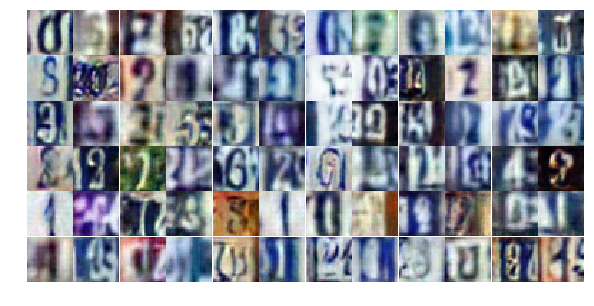

Epoch 15/25... Discriminator Loss: 1.0012... Generator Loss: 0.7123
Epoch 15/25... Discriminator Loss: 0.5773... Generator Loss: 1.1359
Epoch 15/25... Discriminator Loss: 0.2663... Generator Loss: 2.1900
Epoch 15/25... Discriminator Loss: 0.8387... Generator Loss: 0.7578
Epoch 15/25... Discriminator Loss: 1.0364... Generator Loss: 0.6923
Epoch 15/25... Discriminator Loss: 0.5578... Generator Loss: 1.2332
Epoch 15/25... Discriminator Loss: 0.6675... Generator Loss: 1.0588
Epoch 15/25... Discriminator Loss: 1.2632... Generator Loss: 0.4600
Epoch 15/25... Discriminator Loss: 0.7449... Generator Loss: 0.8285
Epoch 15/25... Discriminator Loss: 1.3536... Generator Loss: 0.4808


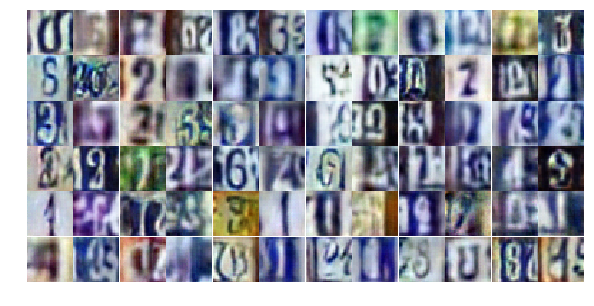

Epoch 15/25... Discriminator Loss: 0.5062... Generator Loss: 1.3787
Epoch 15/25... Discriminator Loss: 0.5440... Generator Loss: 2.7685
Epoch 15/25... Discriminator Loss: 0.4642... Generator Loss: 1.3423
Epoch 15/25... Discriminator Loss: 0.4270... Generator Loss: 1.8433
Epoch 15/25... Discriminator Loss: 0.4945... Generator Loss: 1.5788
Epoch 15/25... Discriminator Loss: 0.5650... Generator Loss: 2.4490
Epoch 15/25... Discriminator Loss: 0.6263... Generator Loss: 1.3641
Epoch 15/25... Discriminator Loss: 0.6818... Generator Loss: 0.9593
Epoch 15/25... Discriminator Loss: 0.6687... Generator Loss: 0.9733
Epoch 15/25... Discriminator Loss: 0.5055... Generator Loss: 1.4570


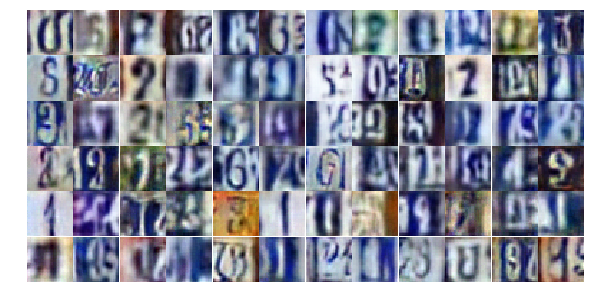

Epoch 15/25... Discriminator Loss: 0.4306... Generator Loss: 1.4119
Epoch 15/25... Discriminator Loss: 0.9608... Generator Loss: 0.6908
Epoch 15/25... Discriminator Loss: 1.0762... Generator Loss: 0.5765
Epoch 15/25... Discriminator Loss: 0.4889... Generator Loss: 1.2413
Epoch 15/25... Discriminator Loss: 0.3687... Generator Loss: 1.5618
Epoch 15/25... Discriminator Loss: 1.5451... Generator Loss: 0.3580
Epoch 15/25... Discriminator Loss: 0.3118... Generator Loss: 2.3980
Epoch 15/25... Discriminator Loss: 3.1223... Generator Loss: 4.8791
Epoch 15/25... Discriminator Loss: 0.8361... Generator Loss: 0.9340
Epoch 15/25... Discriminator Loss: 0.6152... Generator Loss: 1.3453


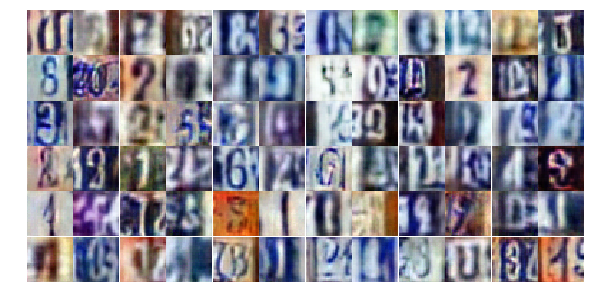

Epoch 15/25... Discriminator Loss: 1.1571... Generator Loss: 0.5080
Epoch 15/25... Discriminator Loss: 0.8675... Generator Loss: 0.7515
Epoch 15/25... Discriminator Loss: 0.2915... Generator Loss: 2.2358
Epoch 15/25... Discriminator Loss: 1.1274... Generator Loss: 0.6583
Epoch 15/25... Discriminator Loss: 0.4186... Generator Loss: 1.8480
Epoch 15/25... Discriminator Loss: 0.7073... Generator Loss: 1.1913
Epoch 15/25... Discriminator Loss: 0.6116... Generator Loss: 1.0406
Epoch 15/25... Discriminator Loss: 0.5236... Generator Loss: 1.2819
Epoch 15/25... Discriminator Loss: 1.3590... Generator Loss: 0.3853
Epoch 16/25... Discriminator Loss: 0.8107... Generator Loss: 0.7837


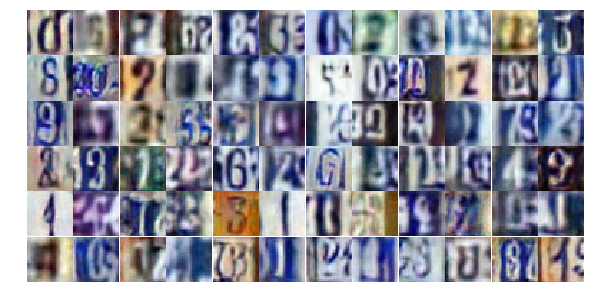

Epoch 16/25... Discriminator Loss: 0.3730... Generator Loss: 1.5426
Epoch 16/25... Discriminator Loss: 0.5944... Generator Loss: 1.4404
Epoch 16/25... Discriminator Loss: 0.8002... Generator Loss: 0.8199
Epoch 16/25... Discriminator Loss: 0.5324... Generator Loss: 1.3303
Epoch 16/25... Discriminator Loss: 0.5397... Generator Loss: 1.2783
Epoch 16/25... Discriminator Loss: 5.6178... Generator Loss: 8.5521
Epoch 16/25... Discriminator Loss: 2.1306... Generator Loss: 0.2912
Epoch 16/25... Discriminator Loss: 0.8132... Generator Loss: 1.1516
Epoch 16/25... Discriminator Loss: 0.4152... Generator Loss: 1.5888
Epoch 16/25... Discriminator Loss: 0.6960... Generator Loss: 0.9521


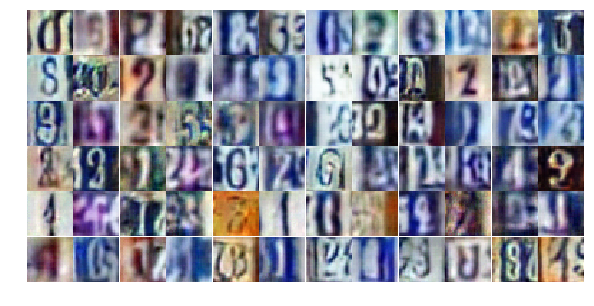

Epoch 16/25... Discriminator Loss: 0.9692... Generator Loss: 0.6773
Epoch 16/25... Discriminator Loss: 0.4648... Generator Loss: 1.4508
Epoch 16/25... Discriminator Loss: 0.8058... Generator Loss: 0.9392
Epoch 16/25... Discriminator Loss: 1.0962... Generator Loss: 0.5683
Epoch 16/25... Discriminator Loss: 0.6480... Generator Loss: 1.0393
Epoch 16/25... Discriminator Loss: 0.6277... Generator Loss: 1.0967
Epoch 16/25... Discriminator Loss: 1.9657... Generator Loss: 0.2454
Epoch 16/25... Discriminator Loss: 0.4254... Generator Loss: 1.7833
Epoch 16/25... Discriminator Loss: 0.6180... Generator Loss: 1.1503
Epoch 16/25... Discriminator Loss: 0.5451... Generator Loss: 1.2296


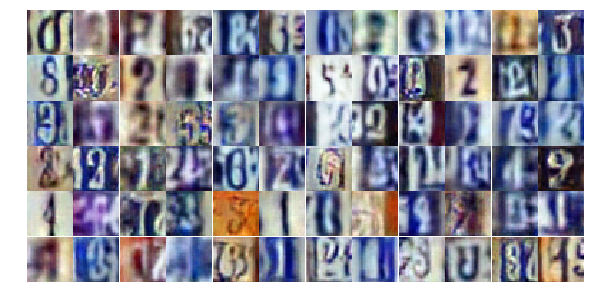

Epoch 16/25... Discriminator Loss: 0.5645... Generator Loss: 1.2862
Epoch 16/25... Discriminator Loss: 0.6677... Generator Loss: 1.0259
Epoch 16/25... Discriminator Loss: 0.6872... Generator Loss: 1.0083
Epoch 16/25... Discriminator Loss: 1.4290... Generator Loss: 0.4329
Epoch 16/25... Discriminator Loss: 0.6573... Generator Loss: 1.0380
Epoch 16/25... Discriminator Loss: 0.8201... Generator Loss: 0.7670
Epoch 16/25... Discriminator Loss: 0.7571... Generator Loss: 0.8055
Epoch 16/25... Discriminator Loss: 0.2884... Generator Loss: 2.0713
Epoch 16/25... Discriminator Loss: 0.9034... Generator Loss: 0.7866
Epoch 16/25... Discriminator Loss: 0.6191... Generator Loss: 1.0818


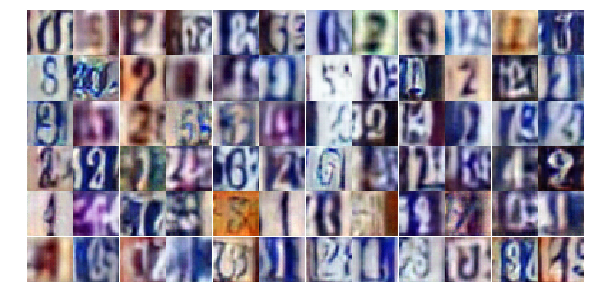

Epoch 16/25... Discriminator Loss: 0.4661... Generator Loss: 1.3841
Epoch 16/25... Discriminator Loss: 0.8762... Generator Loss: 0.7455
Epoch 16/25... Discriminator Loss: 0.4993... Generator Loss: 1.3501
Epoch 16/25... Discriminator Loss: 0.6586... Generator Loss: 1.1389
Epoch 16/25... Discriminator Loss: 1.0625... Generator Loss: 1.0895
Epoch 16/25... Discriminator Loss: 0.6783... Generator Loss: 1.0743
Epoch 16/25... Discriminator Loss: 0.6874... Generator Loss: 0.9445
Epoch 16/25... Discriminator Loss: 0.9040... Generator Loss: 0.7082
Epoch 16/25... Discriminator Loss: 0.9007... Generator Loss: 0.6947
Epoch 16/25... Discriminator Loss: 0.5306... Generator Loss: 1.2757


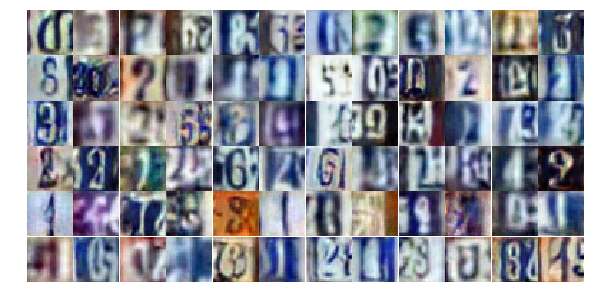

Epoch 16/25... Discriminator Loss: 0.5334... Generator Loss: 1.3011
Epoch 16/25... Discriminator Loss: 0.7116... Generator Loss: 0.8865
Epoch 16/25... Discriminator Loss: 1.5647... Generator Loss: 0.3623
Epoch 16/25... Discriminator Loss: 2.3689... Generator Loss: 0.1803
Epoch 16/25... Discriminator Loss: 1.6998... Generator Loss: 0.3509
Epoch 16/25... Discriminator Loss: 0.9946... Generator Loss: 0.7060
Epoch 16/25... Discriminator Loss: 0.4320... Generator Loss: 1.9553
Epoch 16/25... Discriminator Loss: 1.0264... Generator Loss: 0.6277
Epoch 16/25... Discriminator Loss: 0.6643... Generator Loss: 1.0086
Epoch 16/25... Discriminator Loss: 0.7575... Generator Loss: 0.8745


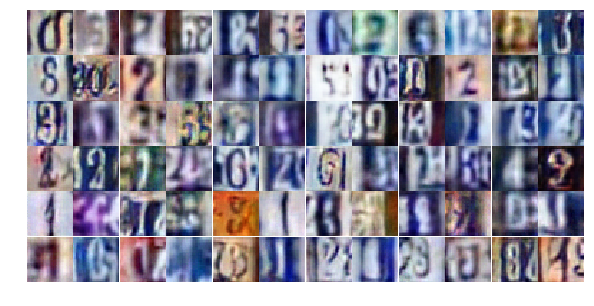

Epoch 16/25... Discriminator Loss: 1.8820... Generator Loss: 0.2309
Epoch 16/25... Discriminator Loss: 0.6682... Generator Loss: 1.8076
Epoch 16/25... Discriminator Loss: 0.9668... Generator Loss: 0.6624
Epoch 16/25... Discriminator Loss: 0.6261... Generator Loss: 0.9410
Epoch 16/25... Discriminator Loss: 0.5228... Generator Loss: 1.3226
Epoch 16/25... Discriminator Loss: 0.8388... Generator Loss: 0.7665
Epoch 17/25... Discriminator Loss: 0.6571... Generator Loss: 1.0972
Epoch 17/25... Discriminator Loss: 0.7102... Generator Loss: 1.0386
Epoch 17/25... Discriminator Loss: 0.7995... Generator Loss: 0.8877
Epoch 17/25... Discriminator Loss: 0.7181... Generator Loss: 0.9838


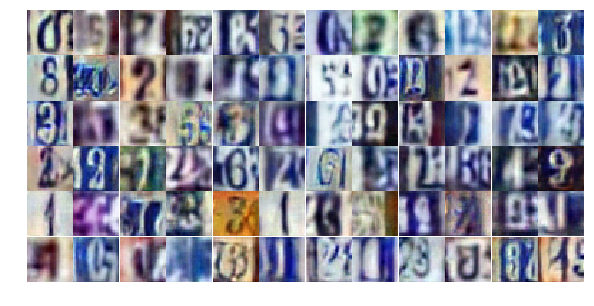

Epoch 17/25... Discriminator Loss: 0.4901... Generator Loss: 1.3040
Epoch 17/25... Discriminator Loss: 0.4264... Generator Loss: 1.3570
Epoch 17/25... Discriminator Loss: 0.7738... Generator Loss: 0.9781
Epoch 17/25... Discriminator Loss: 0.5209... Generator Loss: 1.2655
Epoch 17/25... Discriminator Loss: 1.2860... Generator Loss: 0.4461
Epoch 17/25... Discriminator Loss: 1.1444... Generator Loss: 0.5664
Epoch 17/25... Discriminator Loss: 0.4953... Generator Loss: 1.6764
Epoch 17/25... Discriminator Loss: 0.5533... Generator Loss: 1.1736
Epoch 17/25... Discriminator Loss: 0.3629... Generator Loss: 1.7313
Epoch 17/25... Discriminator Loss: 0.5723... Generator Loss: 1.1770


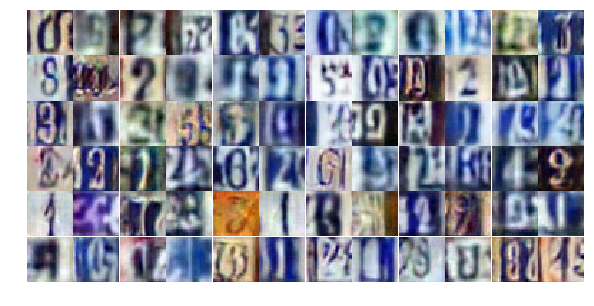

Epoch 17/25... Discriminator Loss: 0.5951... Generator Loss: 1.3183
Epoch 17/25... Discriminator Loss: 0.8807... Generator Loss: 0.7485
Epoch 17/25... Discriminator Loss: 0.5963... Generator Loss: 1.0758
Epoch 17/25... Discriminator Loss: 0.6843... Generator Loss: 1.0484
Epoch 17/25... Discriminator Loss: 0.6554... Generator Loss: 1.0519
Epoch 17/25... Discriminator Loss: 1.3735... Generator Loss: 0.4282
Epoch 17/25... Discriminator Loss: 0.4820... Generator Loss: 1.8044
Epoch 17/25... Discriminator Loss: 0.5982... Generator Loss: 1.0644
Epoch 17/25... Discriminator Loss: 0.5407... Generator Loss: 1.1816
Epoch 17/25... Discriminator Loss: 0.5138... Generator Loss: 1.2403


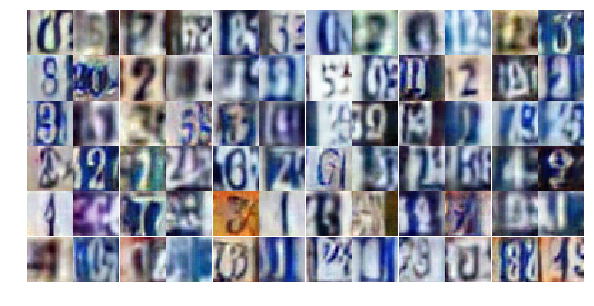

Epoch 17/25... Discriminator Loss: 1.6598... Generator Loss: 0.3125
Epoch 17/25... Discriminator Loss: 0.2964... Generator Loss: 1.9520
Epoch 17/25... Discriminator Loss: 0.3843... Generator Loss: 1.5026
Epoch 17/25... Discriminator Loss: 1.0749... Generator Loss: 0.5742
Epoch 17/25... Discriminator Loss: 1.1897... Generator Loss: 0.5680
Epoch 17/25... Discriminator Loss: 0.6932... Generator Loss: 1.5552
Epoch 17/25... Discriminator Loss: 0.6898... Generator Loss: 1.0697
Epoch 17/25... Discriminator Loss: 0.8757... Generator Loss: 0.8193
Epoch 17/25... Discriminator Loss: 1.0714... Generator Loss: 0.6059
Epoch 17/25... Discriminator Loss: 0.4523... Generator Loss: 1.5221


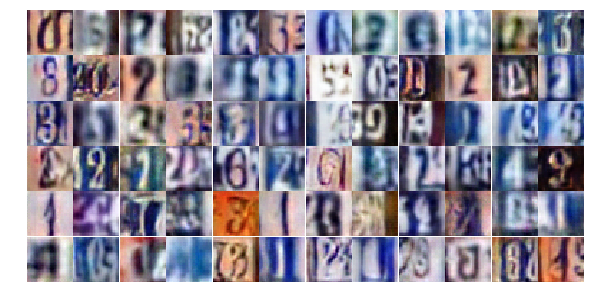

Epoch 17/25... Discriminator Loss: 1.2331... Generator Loss: 0.4861
Epoch 17/25... Discriminator Loss: 1.1117... Generator Loss: 0.6776
Epoch 17/25... Discriminator Loss: 0.5721... Generator Loss: 1.8674
Epoch 17/25... Discriminator Loss: 1.0451... Generator Loss: 0.5789
Epoch 17/25... Discriminator Loss: 0.6422... Generator Loss: 1.0149
Epoch 17/25... Discriminator Loss: 0.8235... Generator Loss: 0.8777
Epoch 17/25... Discriminator Loss: 0.7986... Generator Loss: 0.8283
Epoch 17/25... Discriminator Loss: 0.3957... Generator Loss: 1.7893
Epoch 17/25... Discriminator Loss: 0.3380... Generator Loss: 1.7633
Epoch 17/25... Discriminator Loss: 0.6617... Generator Loss: 0.9701


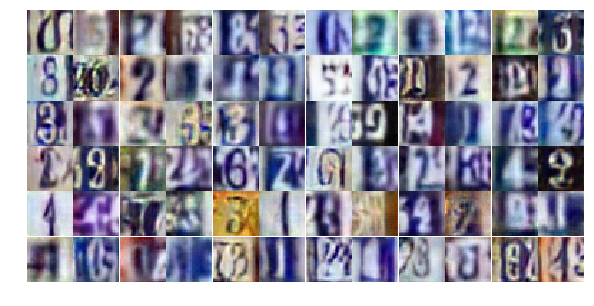

Epoch 17/25... Discriminator Loss: 1.1244... Generator Loss: 0.5955
Epoch 17/25... Discriminator Loss: 0.3016... Generator Loss: 2.8663
Epoch 17/25... Discriminator Loss: 0.5375... Generator Loss: 1.6040
Epoch 17/25... Discriminator Loss: 0.4948... Generator Loss: 1.1850
Epoch 17/25... Discriminator Loss: 0.5991... Generator Loss: 1.1224
Epoch 17/25... Discriminator Loss: 0.9829... Generator Loss: 0.6998
Epoch 17/25... Discriminator Loss: 1.4059... Generator Loss: 0.3673
Epoch 17/25... Discriminator Loss: 0.7482... Generator Loss: 0.9227
Epoch 17/25... Discriminator Loss: 0.6299... Generator Loss: 1.2311
Epoch 17/25... Discriminator Loss: 1.0910... Generator Loss: 0.6168


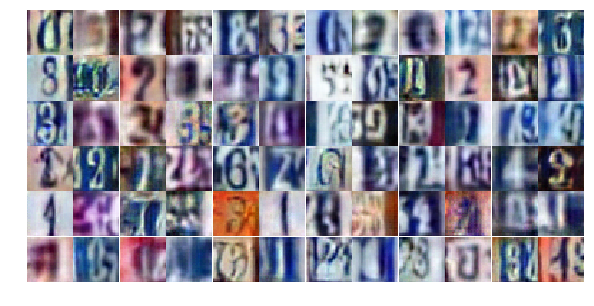

Epoch 17/25... Discriminator Loss: 0.7026... Generator Loss: 1.1636
Epoch 17/25... Discriminator Loss: 0.8415... Generator Loss: 0.8086
Epoch 17/25... Discriminator Loss: 0.3503... Generator Loss: 1.6587
Epoch 17/25... Discriminator Loss: 0.5506... Generator Loss: 1.2195
Epoch 18/25... Discriminator Loss: 1.5041... Generator Loss: 0.3498
Epoch 18/25... Discriminator Loss: 1.0045... Generator Loss: 0.6619
Epoch 18/25... Discriminator Loss: 0.6977... Generator Loss: 1.0472
Epoch 18/25... Discriminator Loss: 0.6570... Generator Loss: 0.9912
Epoch 18/25... Discriminator Loss: 1.1550... Generator Loss: 0.5560
Epoch 18/25... Discriminator Loss: 0.7259... Generator Loss: 0.9865


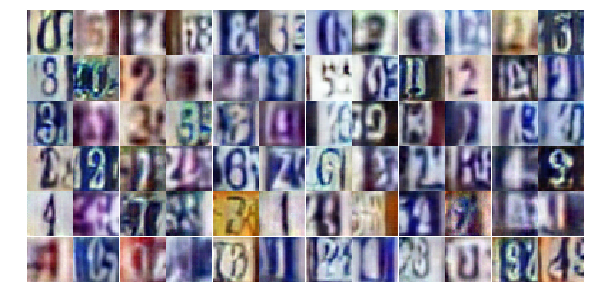

Epoch 18/25... Discriminator Loss: 0.3820... Generator Loss: 2.1732
Epoch 18/25... Discriminator Loss: 0.6533... Generator Loss: 1.7659
Epoch 18/25... Discriminator Loss: 0.5475... Generator Loss: 1.2632
Epoch 18/25... Discriminator Loss: 0.3292... Generator Loss: 2.4130
Epoch 18/25... Discriminator Loss: 0.5087... Generator Loss: 1.3462
Epoch 18/25... Discriminator Loss: 0.8553... Generator Loss: 0.7465
Epoch 18/25... Discriminator Loss: 0.5581... Generator Loss: 1.1917
Epoch 18/25... Discriminator Loss: 0.8219... Generator Loss: 0.7746
Epoch 18/25... Discriminator Loss: 0.5536... Generator Loss: 1.2929
Epoch 18/25... Discriminator Loss: 0.2619... Generator Loss: 1.9300


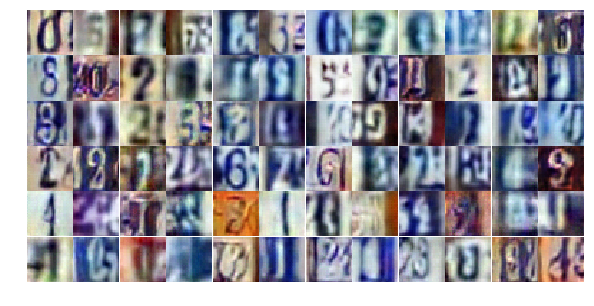

Epoch 18/25... Discriminator Loss: 1.6561... Generator Loss: 0.5110
Epoch 18/25... Discriminator Loss: 1.4416... Generator Loss: 3.4538
Epoch 18/25... Discriminator Loss: 0.7342... Generator Loss: 1.4033
Epoch 18/25... Discriminator Loss: 0.4287... Generator Loss: 1.4815
Epoch 18/25... Discriminator Loss: 0.8827... Generator Loss: 0.7465
Epoch 18/25... Discriminator Loss: 1.0416... Generator Loss: 0.6749
Epoch 18/25... Discriminator Loss: 0.8162... Generator Loss: 1.0758
Epoch 18/25... Discriminator Loss: 0.9223... Generator Loss: 0.7377
Epoch 18/25... Discriminator Loss: 0.8445... Generator Loss: 0.8610
Epoch 18/25... Discriminator Loss: 0.4806... Generator Loss: 1.4212


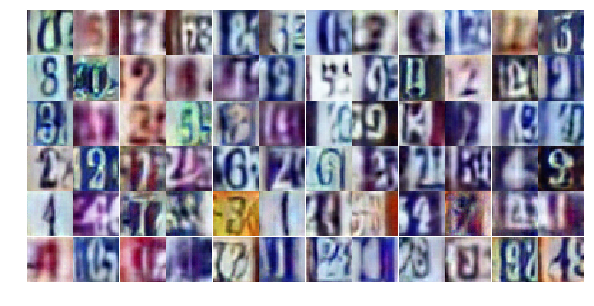

Epoch 18/25... Discriminator Loss: 0.3458... Generator Loss: 1.7308
Epoch 18/25... Discriminator Loss: 0.5672... Generator Loss: 1.2594
Epoch 18/25... Discriminator Loss: 0.5029... Generator Loss: 1.2722
Epoch 18/25... Discriminator Loss: 0.6363... Generator Loss: 1.2715
Epoch 18/25... Discriminator Loss: 1.2558... Generator Loss: 0.5035
Epoch 18/25... Discriminator Loss: 0.9857... Generator Loss: 0.7824
Epoch 18/25... Discriminator Loss: 0.5513... Generator Loss: 1.2858
Epoch 18/25... Discriminator Loss: 0.8180... Generator Loss: 0.8532
Epoch 18/25... Discriminator Loss: 0.2724... Generator Loss: 1.9109
Epoch 18/25... Discriminator Loss: 0.6099... Generator Loss: 1.2112


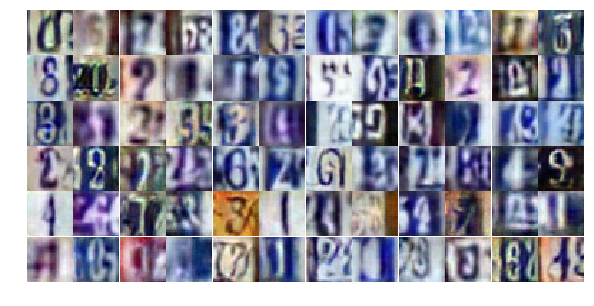

Epoch 18/25... Discriminator Loss: 0.5761... Generator Loss: 1.1622
Epoch 18/25... Discriminator Loss: 0.5944... Generator Loss: 1.0843
Epoch 18/25... Discriminator Loss: 0.4693... Generator Loss: 1.3583
Epoch 18/25... Discriminator Loss: 0.3821... Generator Loss: 1.7972
Epoch 18/25... Discriminator Loss: 0.8930... Generator Loss: 0.9269
Epoch 18/25... Discriminator Loss: 0.4424... Generator Loss: 1.3695
Epoch 18/25... Discriminator Loss: 1.0598... Generator Loss: 0.5326
Epoch 18/25... Discriminator Loss: 1.0402... Generator Loss: 3.0177
Epoch 18/25... Discriminator Loss: 1.7147... Generator Loss: 0.3298
Epoch 18/25... Discriminator Loss: 6.6178... Generator Loss: 0.0054


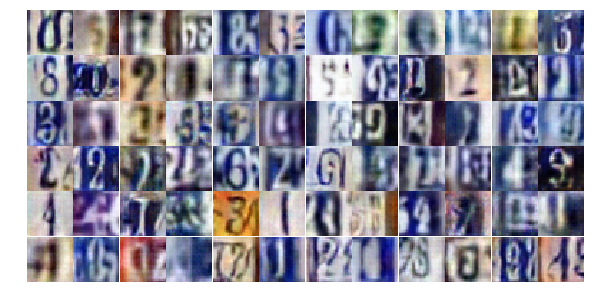

Epoch 18/25... Discriminator Loss: 1.8106... Generator Loss: 1.0697
Epoch 18/25... Discriminator Loss: 1.2741... Generator Loss: 0.8699
Epoch 18/25... Discriminator Loss: 1.4779... Generator Loss: 1.1144
Epoch 18/25... Discriminator Loss: 1.4621... Generator Loss: 0.6792
Epoch 18/25... Discriminator Loss: 1.2102... Generator Loss: 0.9545
Epoch 18/25... Discriminator Loss: 1.2882... Generator Loss: 0.8620
Epoch 18/25... Discriminator Loss: 1.2627... Generator Loss: 0.8230
Epoch 18/25... Discriminator Loss: 1.3025... Generator Loss: 1.1961
Epoch 18/25... Discriminator Loss: 1.5041... Generator Loss: 0.9212
Epoch 18/25... Discriminator Loss: 1.3328... Generator Loss: 1.3706


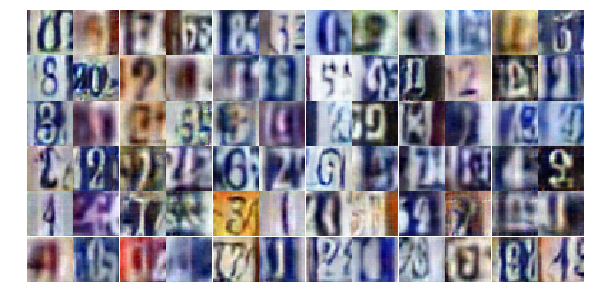

Epoch 18/25... Discriminator Loss: 1.1817... Generator Loss: 1.1687
Epoch 19/25... Discriminator Loss: 1.3342... Generator Loss: 1.0936
Epoch 19/25... Discriminator Loss: 1.5186... Generator Loss: 0.6585
Epoch 19/25... Discriminator Loss: 1.0879... Generator Loss: 1.4252
Epoch 19/25... Discriminator Loss: 1.1205... Generator Loss: 1.0026
Epoch 19/25... Discriminator Loss: 1.1065... Generator Loss: 0.7718
Epoch 19/25... Discriminator Loss: 1.4138... Generator Loss: 0.4681
Epoch 19/25... Discriminator Loss: 1.5236... Generator Loss: 0.3579
Epoch 19/25... Discriminator Loss: 0.7970... Generator Loss: 1.1459
Epoch 19/25... Discriminator Loss: 1.5644... Generator Loss: 0.4205


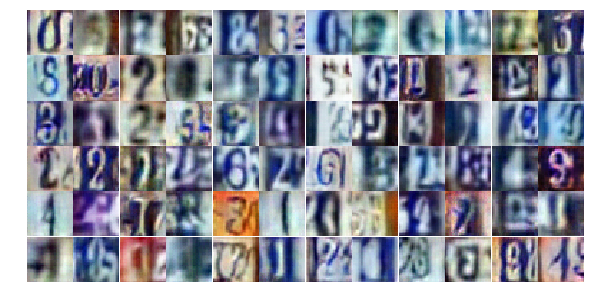

Epoch 19/25... Discriminator Loss: 0.5398... Generator Loss: 1.8889
Epoch 19/25... Discriminator Loss: 1.0618... Generator Loss: 0.6454
Epoch 19/25... Discriminator Loss: 0.8639... Generator Loss: 1.2852
Epoch 19/25... Discriminator Loss: 1.2588... Generator Loss: 0.4881
Epoch 19/25... Discriminator Loss: 1.2833... Generator Loss: 0.4471
Epoch 19/25... Discriminator Loss: 0.7346... Generator Loss: 1.5064
Epoch 19/25... Discriminator Loss: 0.8129... Generator Loss: 0.8171
Epoch 19/25... Discriminator Loss: 0.7088... Generator Loss: 0.9470
Epoch 19/25... Discriminator Loss: 0.8016... Generator Loss: 1.3317
Epoch 19/25... Discriminator Loss: 0.7560... Generator Loss: 0.9508


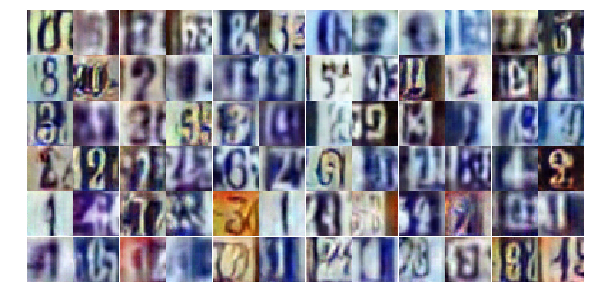

Epoch 19/25... Discriminator Loss: 0.8649... Generator Loss: 0.8394
Epoch 19/25... Discriminator Loss: 1.4208... Generator Loss: 0.4029
Epoch 19/25... Discriminator Loss: 1.4327... Generator Loss: 0.4323
Epoch 19/25... Discriminator Loss: 1.0352... Generator Loss: 0.6655
Epoch 19/25... Discriminator Loss: 1.3483... Generator Loss: 0.4725
Epoch 19/25... Discriminator Loss: 1.0009... Generator Loss: 0.6082
Epoch 19/25... Discriminator Loss: 0.9557... Generator Loss: 0.6841
Epoch 19/25... Discriminator Loss: 0.6532... Generator Loss: 1.0592
Epoch 19/25... Discriminator Loss: 0.6521... Generator Loss: 0.9707
Epoch 19/25... Discriminator Loss: 1.1656... Generator Loss: 0.5264


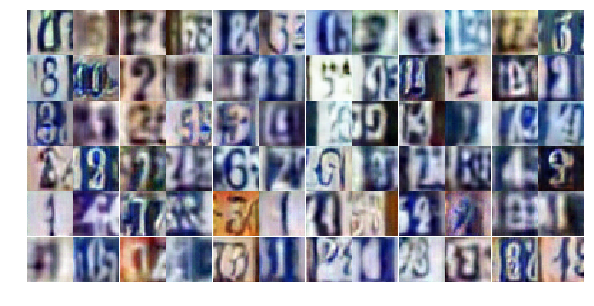

Epoch 19/25... Discriminator Loss: 0.8322... Generator Loss: 0.8971
Epoch 19/25... Discriminator Loss: 1.0239... Generator Loss: 0.6295
Epoch 19/25... Discriminator Loss: 0.8871... Generator Loss: 0.6859
Epoch 19/25... Discriminator Loss: 0.5102... Generator Loss: 1.2825
Epoch 19/25... Discriminator Loss: 0.5902... Generator Loss: 1.3003
Epoch 19/25... Discriminator Loss: 2.6942... Generator Loss: 0.1063
Epoch 19/25... Discriminator Loss: 0.9218... Generator Loss: 0.8669
Epoch 19/25... Discriminator Loss: 0.5934... Generator Loss: 1.2561
Epoch 19/25... Discriminator Loss: 1.0696... Generator Loss: 0.6223
Epoch 19/25... Discriminator Loss: 0.5283... Generator Loss: 1.3387


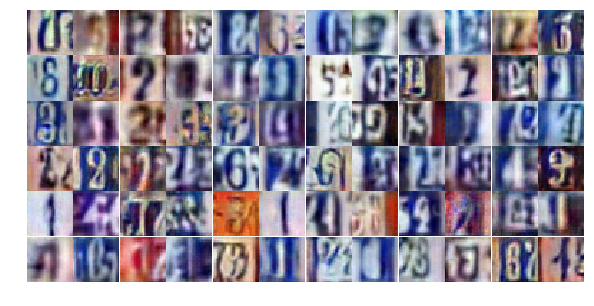

Epoch 19/25... Discriminator Loss: 0.8535... Generator Loss: 0.7310
Epoch 19/25... Discriminator Loss: 0.7292... Generator Loss: 0.9564
Epoch 19/25... Discriminator Loss: 1.0840... Generator Loss: 0.5305
Epoch 19/25... Discriminator Loss: 0.6929... Generator Loss: 1.0880
Epoch 19/25... Discriminator Loss: 0.7642... Generator Loss: 0.9811
Epoch 19/25... Discriminator Loss: 0.6497... Generator Loss: 1.1239
Epoch 19/25... Discriminator Loss: 0.7037... Generator Loss: 0.9566
Epoch 19/25... Discriminator Loss: 0.4340... Generator Loss: 1.3880
Epoch 19/25... Discriminator Loss: 0.6169... Generator Loss: 1.2281
Epoch 19/25... Discriminator Loss: 0.6633... Generator Loss: 1.3492


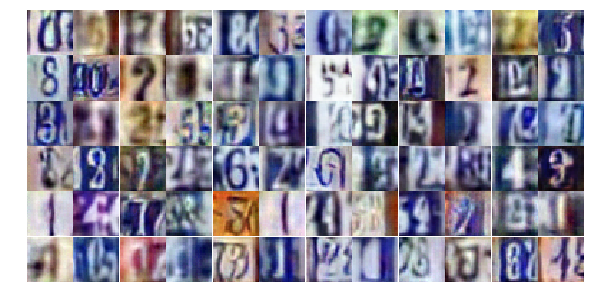

Epoch 19/25... Discriminator Loss: 0.8244... Generator Loss: 0.8130
Epoch 19/25... Discriminator Loss: 0.7645... Generator Loss: 0.9510
Epoch 19/25... Discriminator Loss: 0.7792... Generator Loss: 2.6291
Epoch 19/25... Discriminator Loss: 1.3213... Generator Loss: 0.4761
Epoch 19/25... Discriminator Loss: 1.0221... Generator Loss: 0.6165
Epoch 19/25... Discriminator Loss: 0.6233... Generator Loss: 1.3085
Epoch 19/25... Discriminator Loss: 2.2091... Generator Loss: 0.2056
Epoch 19/25... Discriminator Loss: 1.1699... Generator Loss: 0.5404
Epoch 20/25... Discriminator Loss: 0.7910... Generator Loss: 1.1420
Epoch 20/25... Discriminator Loss: 1.1787... Generator Loss: 0.6010


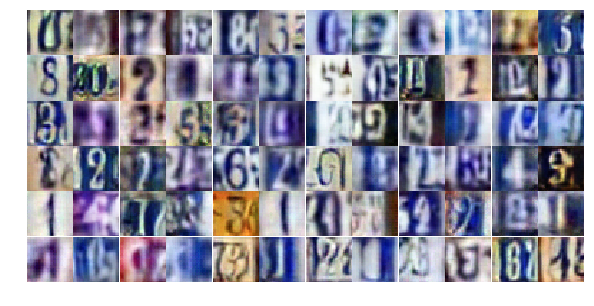

Epoch 20/25... Discriminator Loss: 0.7276... Generator Loss: 1.0633
Epoch 20/25... Discriminator Loss: 1.1752... Generator Loss: 0.5127
Epoch 20/25... Discriminator Loss: 1.3408... Generator Loss: 0.4187
Epoch 20/25... Discriminator Loss: 0.8436... Generator Loss: 1.0479
Epoch 20/25... Discriminator Loss: 0.6509... Generator Loss: 1.0629
Epoch 20/25... Discriminator Loss: 0.6699... Generator Loss: 1.1039
Epoch 20/25... Discriminator Loss: 0.5711... Generator Loss: 1.5664
Epoch 20/25... Discriminator Loss: 0.8825... Generator Loss: 0.7260
Epoch 20/25... Discriminator Loss: 1.1771... Generator Loss: 0.5404
Epoch 20/25... Discriminator Loss: 0.5830... Generator Loss: 1.1363


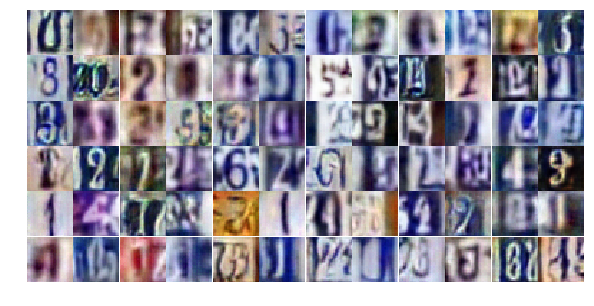

Epoch 20/25... Discriminator Loss: 1.4319... Generator Loss: 0.3860
Epoch 20/25... Discriminator Loss: 1.0206... Generator Loss: 0.6587
Epoch 20/25... Discriminator Loss: 0.7743... Generator Loss: 0.9730
Epoch 20/25... Discriminator Loss: 0.7771... Generator Loss: 0.9792
Epoch 20/25... Discriminator Loss: 0.8924... Generator Loss: 0.7487
Epoch 20/25... Discriminator Loss: 1.6656... Generator Loss: 0.3080
Epoch 20/25... Discriminator Loss: 0.7363... Generator Loss: 1.0621
Epoch 20/25... Discriminator Loss: 0.7884... Generator Loss: 0.9059
Epoch 20/25... Discriminator Loss: 0.5021... Generator Loss: 1.3372
Epoch 20/25... Discriminator Loss: 1.6357... Generator Loss: 0.3235


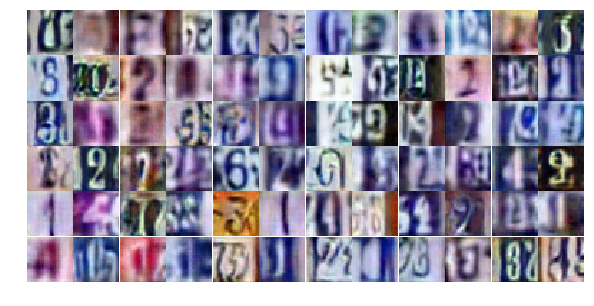

Epoch 20/25... Discriminator Loss: 0.6425... Generator Loss: 1.0903
Epoch 20/25... Discriminator Loss: 0.8593... Generator Loss: 0.7881
Epoch 20/25... Discriminator Loss: 0.2843... Generator Loss: 1.7437
Epoch 20/25... Discriminator Loss: 1.5183... Generator Loss: 0.4250
Epoch 20/25... Discriminator Loss: 0.7270... Generator Loss: 0.9441
Epoch 20/25... Discriminator Loss: 0.4952... Generator Loss: 1.3532
Epoch 20/25... Discriminator Loss: 0.6340... Generator Loss: 2.9264
Epoch 20/25... Discriminator Loss: 2.2240... Generator Loss: 0.1678
Epoch 20/25... Discriminator Loss: 0.9869... Generator Loss: 0.6573
Epoch 20/25... Discriminator Loss: 0.4632... Generator Loss: 1.3721


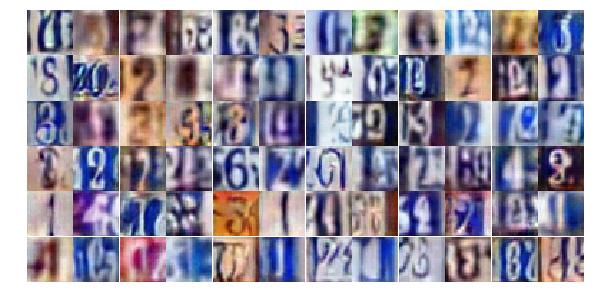

Epoch 20/25... Discriminator Loss: 0.7333... Generator Loss: 1.0603
Epoch 20/25... Discriminator Loss: 0.6997... Generator Loss: 1.0584
Epoch 20/25... Discriminator Loss: 2.0762... Generator Loss: 0.2414
Epoch 20/25... Discriminator Loss: 0.6723... Generator Loss: 2.1541
Epoch 20/25... Discriminator Loss: 0.7814... Generator Loss: 0.8858
Epoch 20/25... Discriminator Loss: 0.8554... Generator Loss: 0.8357
Epoch 20/25... Discriminator Loss: 0.7368... Generator Loss: 1.0439
Epoch 20/25... Discriminator Loss: 0.7327... Generator Loss: 1.0313
Epoch 20/25... Discriminator Loss: 0.8259... Generator Loss: 0.8245
Epoch 20/25... Discriminator Loss: 0.8002... Generator Loss: 0.9360


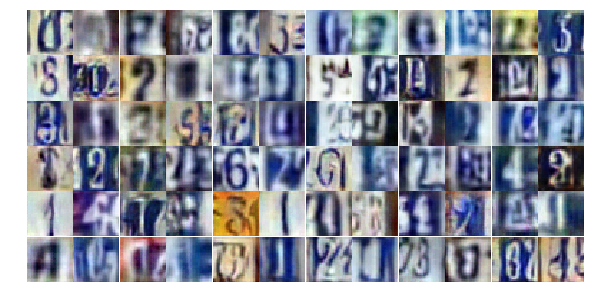

Epoch 20/25... Discriminator Loss: 0.5598... Generator Loss: 1.1438
Epoch 20/25... Discriminator Loss: 0.8706... Generator Loss: 0.8230
Epoch 20/25... Discriminator Loss: 0.7510... Generator Loss: 1.2915
Epoch 20/25... Discriminator Loss: 0.6249... Generator Loss: 0.9895
Epoch 20/25... Discriminator Loss: 0.5889... Generator Loss: 1.2502
Epoch 20/25... Discriminator Loss: 1.0938... Generator Loss: 0.6092
Epoch 20/25... Discriminator Loss: 0.8158... Generator Loss: 0.8766
Epoch 20/25... Discriminator Loss: 0.3983... Generator Loss: 1.6292
Epoch 20/25... Discriminator Loss: 0.3418... Generator Loss: 2.1228
Epoch 20/25... Discriminator Loss: 0.7364... Generator Loss: 0.8928


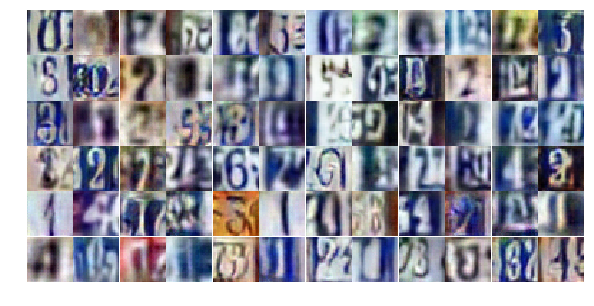

Epoch 20/25... Discriminator Loss: 0.4563... Generator Loss: 1.5490
Epoch 20/25... Discriminator Loss: 0.5292... Generator Loss: 2.0169
Epoch 20/25... Discriminator Loss: 0.5131... Generator Loss: 1.3230
Epoch 20/25... Discriminator Loss: 0.8127... Generator Loss: 0.8581
Epoch 20/25... Discriminator Loss: 0.9868... Generator Loss: 0.7230
Epoch 20/25... Discriminator Loss: 0.4236... Generator Loss: 1.4589
Epoch 21/25... Discriminator Loss: 0.8031... Generator Loss: 1.0044
Epoch 21/25... Discriminator Loss: 0.5837... Generator Loss: 1.0905
Epoch 21/25... Discriminator Loss: 1.3657... Generator Loss: 0.3801
Epoch 21/25... Discriminator Loss: 1.3758... Generator Loss: 0.4206


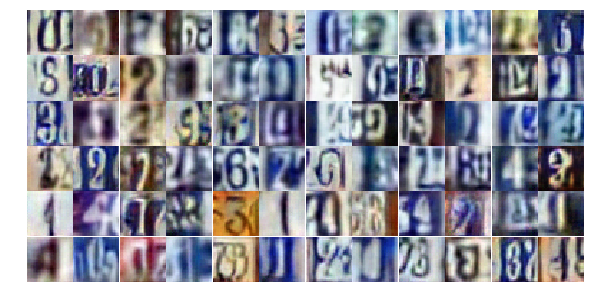

Epoch 21/25... Discriminator Loss: 0.5762... Generator Loss: 1.1729
Epoch 21/25... Discriminator Loss: 1.5312... Generator Loss: 0.3742
Epoch 21/25... Discriminator Loss: 0.9804... Generator Loss: 0.9222
Epoch 21/25... Discriminator Loss: 0.3792... Generator Loss: 1.7572
Epoch 21/25... Discriminator Loss: 0.6783... Generator Loss: 1.0263
Epoch 21/25... Discriminator Loss: 0.8530... Generator Loss: 0.9051
Epoch 21/25... Discriminator Loss: 0.8432... Generator Loss: 0.8012
Epoch 21/25... Discriminator Loss: 0.6225... Generator Loss: 1.2933
Epoch 21/25... Discriminator Loss: 0.6605... Generator Loss: 1.0101
Epoch 21/25... Discriminator Loss: 0.6653... Generator Loss: 1.1605


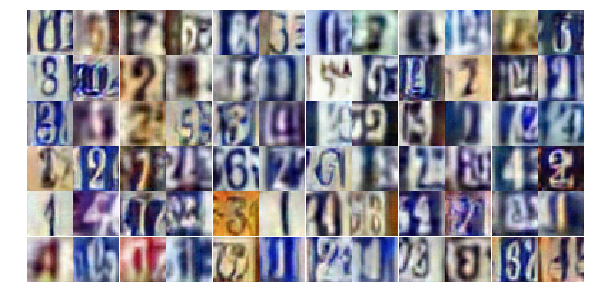

Epoch 21/25... Discriminator Loss: 0.3297... Generator Loss: 1.5539
Epoch 21/25... Discriminator Loss: 1.4804... Generator Loss: 0.3677
Epoch 21/25... Discriminator Loss: 1.3877... Generator Loss: 0.5122
Epoch 21/25... Discriminator Loss: 0.5017... Generator Loss: 1.3210
Epoch 21/25... Discriminator Loss: 0.3433... Generator Loss: 2.7622
Epoch 21/25... Discriminator Loss: 1.2212... Generator Loss: 0.5237
Epoch 21/25... Discriminator Loss: 1.0052... Generator Loss: 0.6836
Epoch 21/25... Discriminator Loss: 0.2678... Generator Loss: 1.9308
Epoch 21/25... Discriminator Loss: 0.5946... Generator Loss: 1.2244
Epoch 21/25... Discriminator Loss: 0.7772... Generator Loss: 0.8719


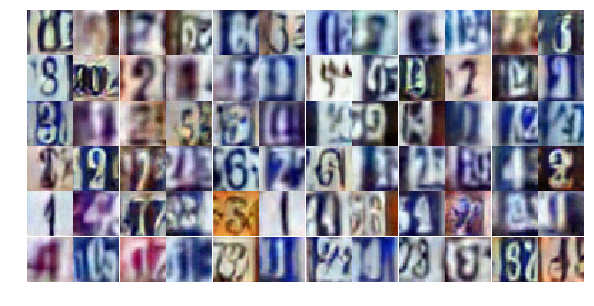

Epoch 21/25... Discriminator Loss: 1.3173... Generator Loss: 0.4800
Epoch 21/25... Discriminator Loss: 0.2633... Generator Loss: 2.5569
Epoch 21/25... Discriminator Loss: 0.9305... Generator Loss: 1.9391
Epoch 21/25... Discriminator Loss: 1.3014... Generator Loss: 0.6412
Epoch 21/25... Discriminator Loss: 0.8391... Generator Loss: 1.0995
Epoch 21/25... Discriminator Loss: 1.1873... Generator Loss: 0.5641
Epoch 21/25... Discriminator Loss: 0.6155... Generator Loss: 0.9900
Epoch 21/25... Discriminator Loss: 0.7584... Generator Loss: 0.9195
Epoch 21/25... Discriminator Loss: 0.9902... Generator Loss: 0.6613
Epoch 21/25... Discriminator Loss: 1.6429... Generator Loss: 0.4136


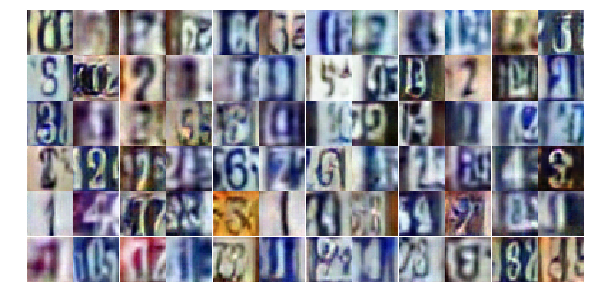

Epoch 21/25... Discriminator Loss: 1.7321... Generator Loss: 0.3108
Epoch 21/25... Discriminator Loss: 0.7190... Generator Loss: 0.9679
Epoch 21/25... Discriminator Loss: 0.9751... Generator Loss: 0.6919
Epoch 21/25... Discriminator Loss: 0.6193... Generator Loss: 1.0882
Epoch 21/25... Discriminator Loss: 0.4955... Generator Loss: 1.3330
Epoch 21/25... Discriminator Loss: 0.8588... Generator Loss: 0.7918
Epoch 21/25... Discriminator Loss: 0.8332... Generator Loss: 0.8737
Epoch 21/25... Discriminator Loss: 1.7195... Generator Loss: 0.3565
Epoch 21/25... Discriminator Loss: 1.3555... Generator Loss: 0.4752
Epoch 21/25... Discriminator Loss: 0.2627... Generator Loss: 2.2072


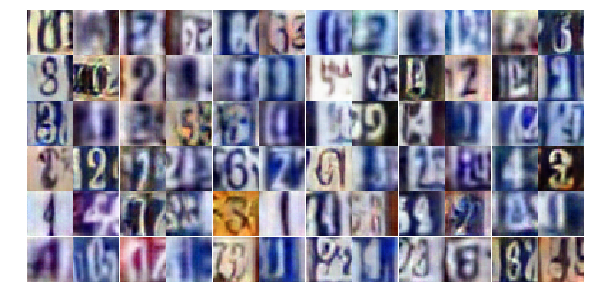

Epoch 21/25... Discriminator Loss: 1.6352... Generator Loss: 0.3732
Epoch 21/25... Discriminator Loss: 1.0222... Generator Loss: 0.6775
Epoch 21/25... Discriminator Loss: 0.6891... Generator Loss: 0.9318
Epoch 21/25... Discriminator Loss: 0.8648... Generator Loss: 0.7942
Epoch 21/25... Discriminator Loss: 0.3626... Generator Loss: 1.7109
Epoch 21/25... Discriminator Loss: 0.5707... Generator Loss: 1.1059
Epoch 21/25... Discriminator Loss: 0.8897... Generator Loss: 0.7529
Epoch 21/25... Discriminator Loss: 0.9267... Generator Loss: 0.7864
Epoch 21/25... Discriminator Loss: 0.9674... Generator Loss: 0.6632
Epoch 21/25... Discriminator Loss: 0.6351... Generator Loss: 1.0552


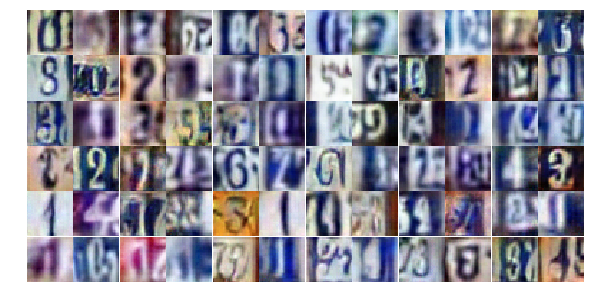

Epoch 21/25... Discriminator Loss: 0.7072... Generator Loss: 0.9226
Epoch 21/25... Discriminator Loss: 1.0385... Generator Loss: 1.4222
Epoch 21/25... Discriminator Loss: 0.8467... Generator Loss: 0.9273
Epoch 22/25... Discriminator Loss: 0.5213... Generator Loss: 1.4570
Epoch 22/25... Discriminator Loss: 1.0777... Generator Loss: 0.6323
Epoch 22/25... Discriminator Loss: 0.8303... Generator Loss: 0.7761
Epoch 22/25... Discriminator Loss: 0.4263... Generator Loss: 1.5553
Epoch 22/25... Discriminator Loss: 0.5141... Generator Loss: 1.1616
Epoch 22/25... Discriminator Loss: 1.1629... Generator Loss: 0.5865
Epoch 22/25... Discriminator Loss: 0.4894... Generator Loss: 1.7475


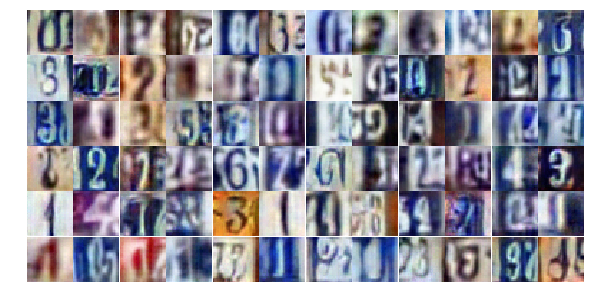

Epoch 22/25... Discriminator Loss: 0.5072... Generator Loss: 1.6197
Epoch 22/25... Discriminator Loss: 0.7170... Generator Loss: 1.7542
Epoch 22/25... Discriminator Loss: 1.4351... Generator Loss: 0.4539
Epoch 22/25... Discriminator Loss: 0.6582... Generator Loss: 1.1338
Epoch 22/25... Discriminator Loss: 0.9041... Generator Loss: 0.8153
Epoch 22/25... Discriminator Loss: 0.6342... Generator Loss: 1.3457
Epoch 22/25... Discriminator Loss: 0.5654... Generator Loss: 1.1970
Epoch 22/25... Discriminator Loss: 0.5111... Generator Loss: 1.2394
Epoch 22/25... Discriminator Loss: 1.4322... Generator Loss: 0.3785
Epoch 22/25... Discriminator Loss: 1.5088... Generator Loss: 0.3506


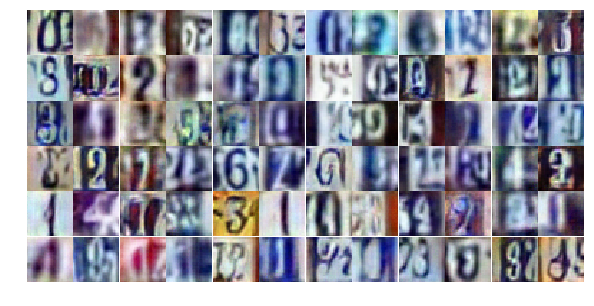

Epoch 22/25... Discriminator Loss: 0.6842... Generator Loss: 1.3682
Epoch 22/25... Discriminator Loss: 1.0021... Generator Loss: 3.8899
Epoch 22/25... Discriminator Loss: 1.3273... Generator Loss: 0.4730
Epoch 22/25... Discriminator Loss: 0.3795... Generator Loss: 1.5666
Epoch 22/25... Discriminator Loss: 0.4126... Generator Loss: 1.5339
Epoch 22/25... Discriminator Loss: 0.8662... Generator Loss: 0.8096
Epoch 22/25... Discriminator Loss: 0.4417... Generator Loss: 1.3726
Epoch 22/25... Discriminator Loss: 0.4005... Generator Loss: 1.4710
Epoch 22/25... Discriminator Loss: 0.6014... Generator Loss: 1.2244
Epoch 22/25... Discriminator Loss: 1.0493... Generator Loss: 0.5942


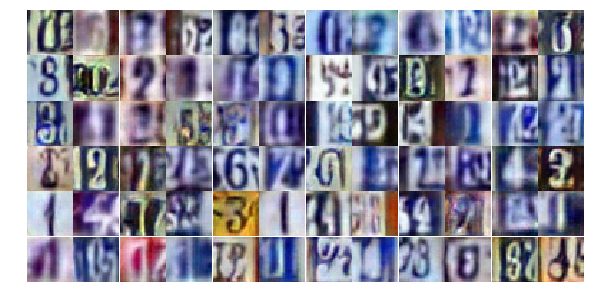

Epoch 22/25... Discriminator Loss: 0.6953... Generator Loss: 0.8915
Epoch 22/25... Discriminator Loss: 0.5649... Generator Loss: 1.2133
Epoch 22/25... Discriminator Loss: 0.9589... Generator Loss: 0.6855
Epoch 22/25... Discriminator Loss: 0.8472... Generator Loss: 0.8053
Epoch 22/25... Discriminator Loss: 0.6332... Generator Loss: 1.2612
Epoch 22/25... Discriminator Loss: 0.6348... Generator Loss: 1.0670
Epoch 22/25... Discriminator Loss: 1.5391... Generator Loss: 0.3566
Epoch 22/25... Discriminator Loss: 0.4247... Generator Loss: 1.8730
Epoch 22/25... Discriminator Loss: 0.7674... Generator Loss: 1.0011
Epoch 22/25... Discriminator Loss: 1.0925... Generator Loss: 0.5843


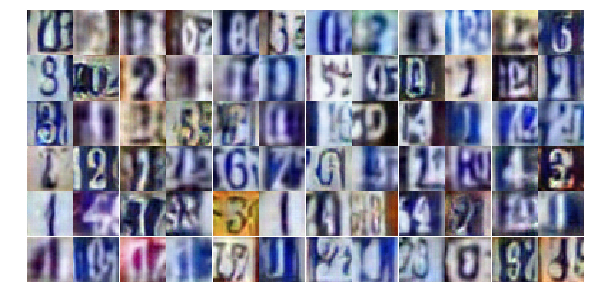

Epoch 22/25... Discriminator Loss: 0.6124... Generator Loss: 1.4617
Epoch 22/25... Discriminator Loss: 0.5259... Generator Loss: 1.4063
Epoch 22/25... Discriminator Loss: 0.3153... Generator Loss: 1.8206
Epoch 22/25... Discriminator Loss: 0.5628... Generator Loss: 1.2123
Epoch 22/25... Discriminator Loss: 1.0177... Generator Loss: 0.6353
Epoch 22/25... Discriminator Loss: 0.4030... Generator Loss: 1.4951
Epoch 22/25... Discriminator Loss: 0.6968... Generator Loss: 1.1060
Epoch 22/25... Discriminator Loss: 0.9397... Generator Loss: 0.9101
Epoch 22/25... Discriminator Loss: 1.8674... Generator Loss: 0.2510
Epoch 22/25... Discriminator Loss: 1.6041... Generator Loss: 0.5137


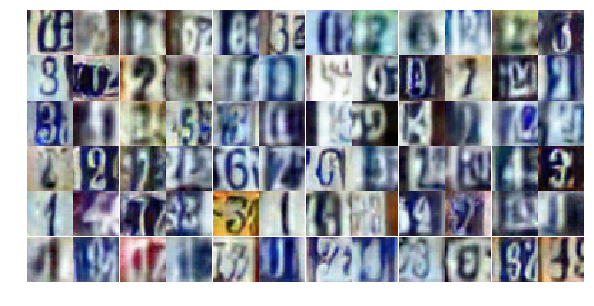

Epoch 22/25... Discriminator Loss: 0.9639... Generator Loss: 0.7918
Epoch 22/25... Discriminator Loss: 0.6091... Generator Loss: 1.2372
Epoch 22/25... Discriminator Loss: 0.6104... Generator Loss: 1.3330
Epoch 22/25... Discriminator Loss: 1.1520... Generator Loss: 0.5826
Epoch 22/25... Discriminator Loss: 0.6535... Generator Loss: 1.0436
Epoch 22/25... Discriminator Loss: 0.7411... Generator Loss: 0.9245
Epoch 22/25... Discriminator Loss: 0.9866... Generator Loss: 1.6757
Epoch 22/25... Discriminator Loss: 0.4955... Generator Loss: 1.3226
Epoch 22/25... Discriminator Loss: 0.8425... Generator Loss: 1.3564
Epoch 22/25... Discriminator Loss: 0.8750... Generator Loss: 0.7449


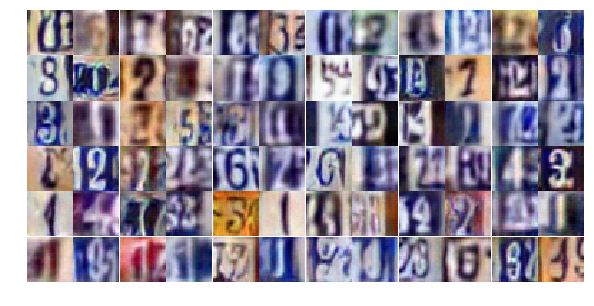

Epoch 23/25... Discriminator Loss: 0.4776... Generator Loss: 1.6711
Epoch 23/25... Discriminator Loss: 0.3647... Generator Loss: 1.8646
Epoch 23/25... Discriminator Loss: 0.9499... Generator Loss: 0.7471
Epoch 23/25... Discriminator Loss: 0.8113... Generator Loss: 0.7967
Epoch 23/25... Discriminator Loss: 0.5006... Generator Loss: 1.3389
Epoch 23/25... Discriminator Loss: 0.7970... Generator Loss: 1.0809
Epoch 23/25... Discriminator Loss: 1.5246... Generator Loss: 0.5199
Epoch 23/25... Discriminator Loss: 0.5651... Generator Loss: 1.2230
Epoch 23/25... Discriminator Loss: 0.4986... Generator Loss: 1.3802
Epoch 23/25... Discriminator Loss: 0.3241... Generator Loss: 1.7402


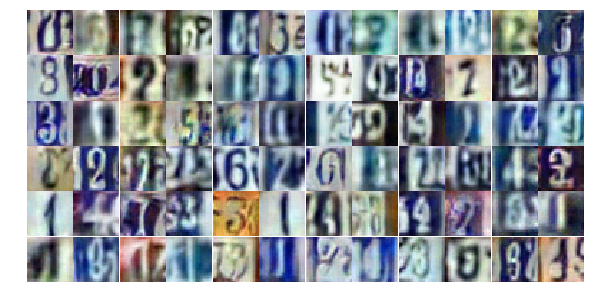

Epoch 23/25... Discriminator Loss: 0.6392... Generator Loss: 2.9084
Epoch 23/25... Discriminator Loss: 1.0367... Generator Loss: 0.6587
Epoch 23/25... Discriminator Loss: 0.9835... Generator Loss: 0.6595
Epoch 23/25... Discriminator Loss: 0.5936... Generator Loss: 1.1328
Epoch 23/25... Discriminator Loss: 0.5334... Generator Loss: 1.2429
Epoch 23/25... Discriminator Loss: 0.9474... Generator Loss: 0.9195
Epoch 23/25... Discriminator Loss: 1.3721... Generator Loss: 0.4365
Epoch 23/25... Discriminator Loss: 0.6901... Generator Loss: 1.9476
Epoch 23/25... Discriminator Loss: 0.4855... Generator Loss: 1.6489
Epoch 23/25... Discriminator Loss: 0.6568... Generator Loss: 1.1867


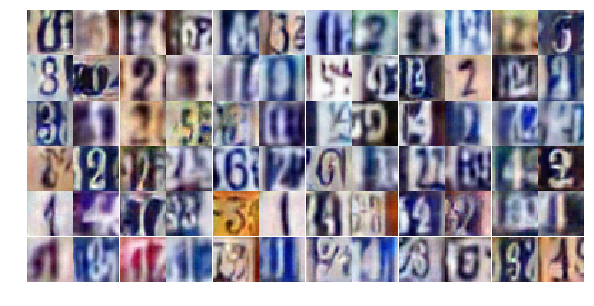

Epoch 23/25... Discriminator Loss: 0.8615... Generator Loss: 0.8313
Epoch 23/25... Discriminator Loss: 0.5389... Generator Loss: 1.4393
Epoch 23/25... Discriminator Loss: 1.2568... Generator Loss: 0.4968
Epoch 23/25... Discriminator Loss: 0.9633... Generator Loss: 0.7033
Epoch 23/25... Discriminator Loss: 0.5713... Generator Loss: 1.3191
Epoch 23/25... Discriminator Loss: 0.7480... Generator Loss: 0.8967
Epoch 23/25... Discriminator Loss: 0.6537... Generator Loss: 1.0299
Epoch 23/25... Discriminator Loss: 0.4686... Generator Loss: 1.4936
Epoch 23/25... Discriminator Loss: 0.4366... Generator Loss: 1.5317
Epoch 23/25... Discriminator Loss: 1.3841... Generator Loss: 2.9147


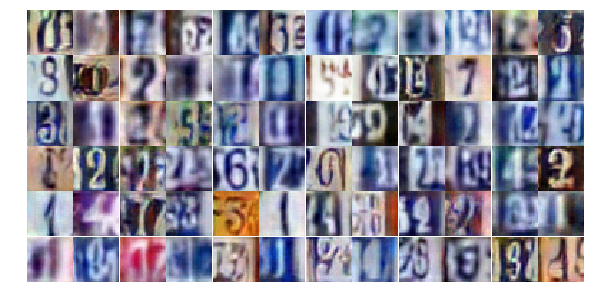

Epoch 23/25... Discriminator Loss: 0.4983... Generator Loss: 1.3441
Epoch 23/25... Discriminator Loss: 0.7101... Generator Loss: 1.0793
Epoch 23/25... Discriminator Loss: 0.7031... Generator Loss: 0.9871
Epoch 23/25... Discriminator Loss: 1.3470... Generator Loss: 0.4626
Epoch 23/25... Discriminator Loss: 0.5744... Generator Loss: 1.2828
Epoch 23/25... Discriminator Loss: 0.8825... Generator Loss: 0.7597
Epoch 23/25... Discriminator Loss: 1.0932... Generator Loss: 0.6290
Epoch 23/25... Discriminator Loss: 0.7338... Generator Loss: 1.0451
Epoch 23/25... Discriminator Loss: 0.6178... Generator Loss: 1.1623
Epoch 23/25... Discriminator Loss: 0.5246... Generator Loss: 1.1743


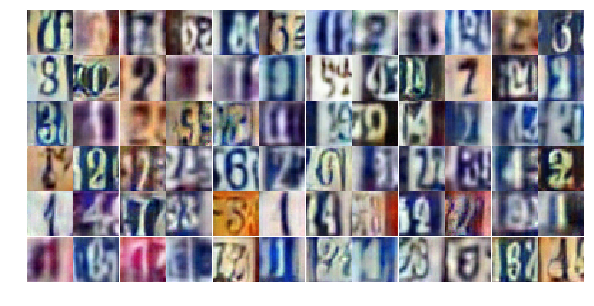

Epoch 23/25... Discriminator Loss: 0.5688... Generator Loss: 1.2761
Epoch 23/25... Discriminator Loss: 0.7946... Generator Loss: 0.7903
Epoch 23/25... Discriminator Loss: 1.2774... Generator Loss: 0.4691
Epoch 23/25... Discriminator Loss: 1.1405... Generator Loss: 0.5151
Epoch 23/25... Discriminator Loss: 1.5627... Generator Loss: 0.4350
Epoch 23/25... Discriminator Loss: 0.8826... Generator Loss: 0.7896
Epoch 23/25... Discriminator Loss: 0.3583... Generator Loss: 1.6398
Epoch 23/25... Discriminator Loss: 1.4495... Generator Loss: 0.3816
Epoch 23/25... Discriminator Loss: 0.8573... Generator Loss: 0.7503
Epoch 23/25... Discriminator Loss: 1.8643... Generator Loss: 0.2944


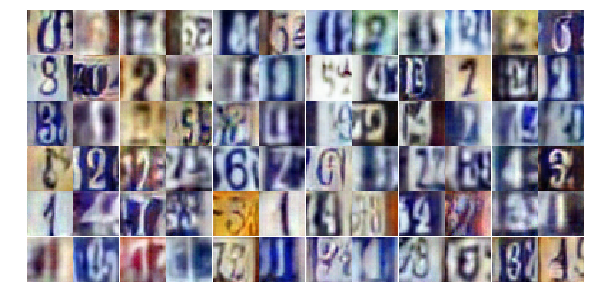

Epoch 23/25... Discriminator Loss: 0.7885... Generator Loss: 1.1548
Epoch 23/25... Discriminator Loss: 1.0656... Generator Loss: 0.6218
Epoch 23/25... Discriminator Loss: 1.1867... Generator Loss: 0.5382
Epoch 23/25... Discriminator Loss: 0.3736... Generator Loss: 1.5302
Epoch 23/25... Discriminator Loss: 1.3593... Generator Loss: 0.5123
Epoch 23/25... Discriminator Loss: 0.4598... Generator Loss: 1.5177
Epoch 23/25... Discriminator Loss: 0.9066... Generator Loss: 0.6817
Epoch 24/25... Discriminator Loss: 0.8419... Generator Loss: 1.0169
Epoch 24/25... Discriminator Loss: 0.7917... Generator Loss: 0.8932
Epoch 24/25... Discriminator Loss: 0.8745... Generator Loss: 0.8653


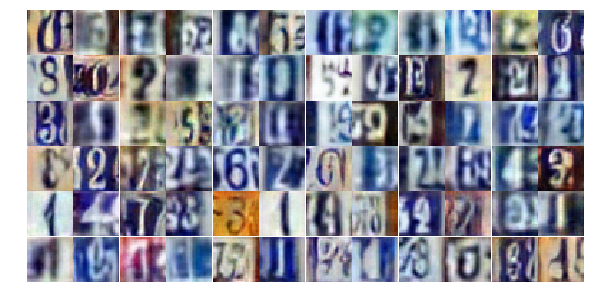

Epoch 24/25... Discriminator Loss: 0.5737... Generator Loss: 1.1871
Epoch 24/25... Discriminator Loss: 0.5971... Generator Loss: 1.2605
Epoch 24/25... Discriminator Loss: 0.9240... Generator Loss: 0.6753
Epoch 24/25... Discriminator Loss: 0.6984... Generator Loss: 2.6794
Epoch 24/25... Discriminator Loss: 0.4768... Generator Loss: 1.3430
Epoch 24/25... Discriminator Loss: 0.6207... Generator Loss: 1.0889
Epoch 24/25... Discriminator Loss: 0.8800... Generator Loss: 0.7466
Epoch 24/25... Discriminator Loss: 1.3504... Generator Loss: 0.4717
Epoch 24/25... Discriminator Loss: 0.4302... Generator Loss: 1.4129
Epoch 24/25... Discriminator Loss: 0.4775... Generator Loss: 1.3654


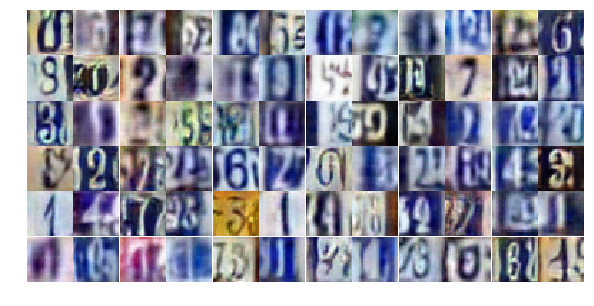

Epoch 24/25... Discriminator Loss: 1.5427... Generator Loss: 0.3825
Epoch 24/25... Discriminator Loss: 1.7058... Generator Loss: 0.2787
Epoch 24/25... Discriminator Loss: 0.8258... Generator Loss: 0.8536
Epoch 24/25... Discriminator Loss: 1.1600... Generator Loss: 0.5322
Epoch 24/25... Discriminator Loss: 0.5512... Generator Loss: 1.2780
Epoch 24/25... Discriminator Loss: 1.2299... Generator Loss: 0.4811
Epoch 24/25... Discriminator Loss: 0.4275... Generator Loss: 1.4736
Epoch 24/25... Discriminator Loss: 1.1855... Generator Loss: 0.5095
Epoch 24/25... Discriminator Loss: 0.6536... Generator Loss: 1.0060
Epoch 24/25... Discriminator Loss: 0.5262... Generator Loss: 1.3731


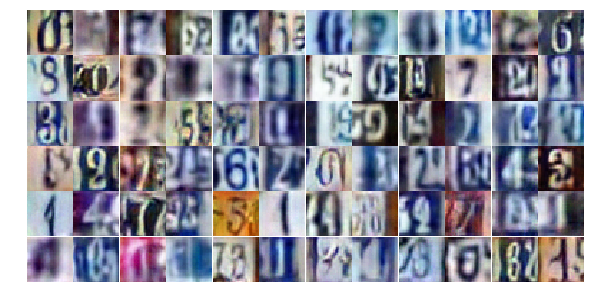

Epoch 24/25... Discriminator Loss: 0.7586... Generator Loss: 0.9274
Epoch 24/25... Discriminator Loss: 0.4458... Generator Loss: 1.6870
Epoch 24/25... Discriminator Loss: 0.3895... Generator Loss: 1.7158
Epoch 24/25... Discriminator Loss: 1.5765... Generator Loss: 0.3612
Epoch 24/25... Discriminator Loss: 0.6144... Generator Loss: 1.1387
Epoch 24/25... Discriminator Loss: 0.4292... Generator Loss: 1.4539
Epoch 24/25... Discriminator Loss: 0.4832... Generator Loss: 1.2042
Epoch 24/25... Discriminator Loss: 0.5749... Generator Loss: 1.2529
Epoch 24/25... Discriminator Loss: 0.7538... Generator Loss: 0.8945
Epoch 24/25... Discriminator Loss: 0.7177... Generator Loss: 0.9989


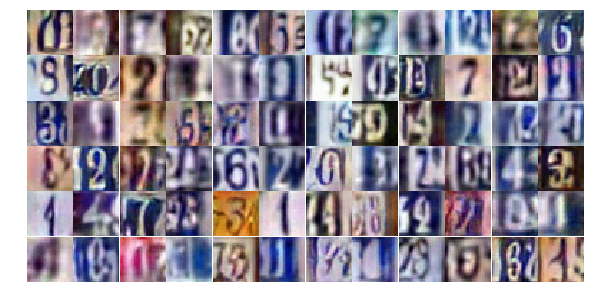

Epoch 24/25... Discriminator Loss: 0.5429... Generator Loss: 1.3215
Epoch 24/25... Discriminator Loss: 0.3041... Generator Loss: 1.9090
Epoch 24/25... Discriminator Loss: 0.7377... Generator Loss: 1.7003
Epoch 24/25... Discriminator Loss: 1.3241... Generator Loss: 0.5124
Epoch 24/25... Discriminator Loss: 0.9116... Generator Loss: 0.8599
Epoch 24/25... Discriminator Loss: 0.6428... Generator Loss: 0.9589
Epoch 24/25... Discriminator Loss: 0.8626... Generator Loss: 0.7563
Epoch 24/25... Discriminator Loss: 0.6532... Generator Loss: 1.0462
Epoch 24/25... Discriminator Loss: 0.8031... Generator Loss: 0.8592
Epoch 24/25... Discriminator Loss: 0.5856... Generator Loss: 1.2367


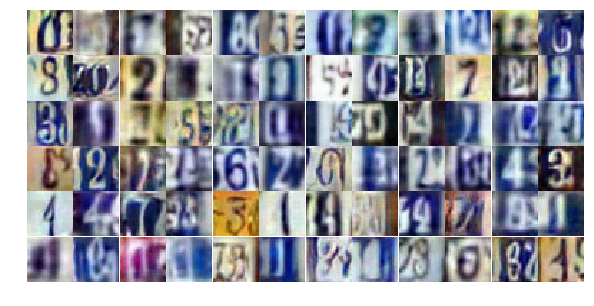

Epoch 24/25... Discriminator Loss: 0.7171... Generator Loss: 1.0143
Epoch 24/25... Discriminator Loss: 0.4049... Generator Loss: 1.7973
Epoch 24/25... Discriminator Loss: 0.9420... Generator Loss: 0.9306
Epoch 24/25... Discriminator Loss: 1.9571... Generator Loss: 4.0191
Epoch 24/25... Discriminator Loss: 1.7831... Generator Loss: 0.9418
Epoch 24/25... Discriminator Loss: 1.5632... Generator Loss: 0.7142
Epoch 24/25... Discriminator Loss: 1.5111... Generator Loss: 0.5565
Epoch 24/25... Discriminator Loss: 1.5965... Generator Loss: 1.0973
Epoch 24/25... Discriminator Loss: 1.4251... Generator Loss: 0.6236
Epoch 24/25... Discriminator Loss: 1.5070... Generator Loss: 0.7646


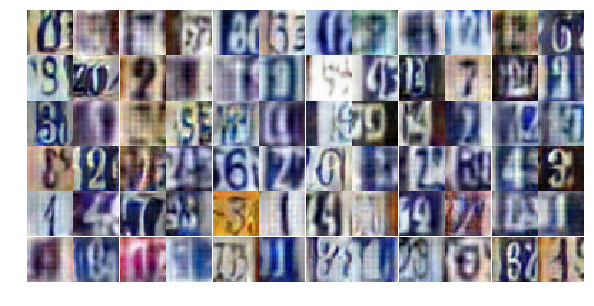

Epoch 24/25... Discriminator Loss: 1.4069... Generator Loss: 0.7065
Epoch 24/25... Discriminator Loss: 1.3824... Generator Loss: 0.8762
Epoch 24/25... Discriminator Loss: 1.3483... Generator Loss: 0.6791
Epoch 24/25... Discriminator Loss: 1.4394... Generator Loss: 0.5933
Epoch 24/25... Discriminator Loss: 1.3320... Generator Loss: 0.8717
Epoch 25/25... Discriminator Loss: 1.4398... Generator Loss: 0.6907
Epoch 25/25... Discriminator Loss: 1.1812... Generator Loss: 0.9247
Epoch 25/25... Discriminator Loss: 1.2206... Generator Loss: 0.7804
Epoch 25/25... Discriminator Loss: 1.3894... Generator Loss: 0.7503
Epoch 25/25... Discriminator Loss: 1.1804... Generator Loss: 0.7460


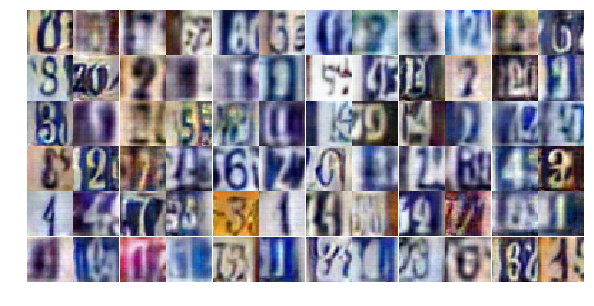

Epoch 25/25... Discriminator Loss: 1.1638... Generator Loss: 1.1165
Epoch 25/25... Discriminator Loss: 1.2744... Generator Loss: 0.8244
Epoch 25/25... Discriminator Loss: 1.8074... Generator Loss: 0.2958
Epoch 25/25... Discriminator Loss: 0.8177... Generator Loss: 2.0244
Epoch 25/25... Discriminator Loss: 1.4638... Generator Loss: 2.6200
Epoch 25/25... Discriminator Loss: 1.1234... Generator Loss: 0.7601
Epoch 25/25... Discriminator Loss: 0.7787... Generator Loss: 1.1271
Epoch 25/25... Discriminator Loss: 1.1740... Generator Loss: 0.6583
Epoch 25/25... Discriminator Loss: 0.7492... Generator Loss: 2.0920
Epoch 25/25... Discriminator Loss: 1.8713... Generator Loss: 0.2749


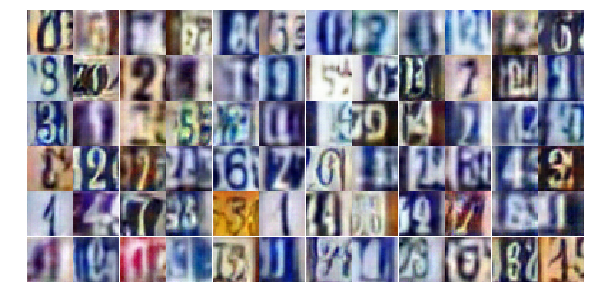

Epoch 25/25... Discriminator Loss: 0.7307... Generator Loss: 1.1725
Epoch 25/25... Discriminator Loss: 0.8558... Generator Loss: 2.4006
Epoch 25/25... Discriminator Loss: 1.4283... Generator Loss: 0.4203
Epoch 25/25... Discriminator Loss: 0.8610... Generator Loss: 0.8939
Epoch 25/25... Discriminator Loss: 0.7447... Generator Loss: 1.0530
Epoch 25/25... Discriminator Loss: 0.5849... Generator Loss: 1.1650
Epoch 25/25... Discriminator Loss: 0.7479... Generator Loss: 0.9270
Epoch 25/25... Discriminator Loss: 1.2996... Generator Loss: 0.4447
Epoch 25/25... Discriminator Loss: 0.7092... Generator Loss: 1.0182
Epoch 25/25... Discriminator Loss: 1.3579... Generator Loss: 0.5579


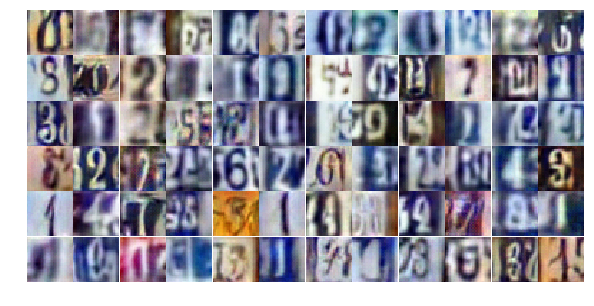

Epoch 25/25... Discriminator Loss: 0.9637... Generator Loss: 0.7782
Epoch 25/25... Discriminator Loss: 0.7110... Generator Loss: 0.9430
Epoch 25/25... Discriminator Loss: 1.1446... Generator Loss: 0.6252
Epoch 25/25... Discriminator Loss: 0.8155... Generator Loss: 0.9486
Epoch 25/25... Discriminator Loss: 1.1623... Generator Loss: 0.6015
Epoch 25/25... Discriminator Loss: 0.7530... Generator Loss: 0.8565
Epoch 25/25... Discriminator Loss: 0.7019... Generator Loss: 1.0994
Epoch 25/25... Discriminator Loss: 0.8988... Generator Loss: 0.7612
Epoch 25/25... Discriminator Loss: 0.8422... Generator Loss: 1.0413
Epoch 25/25... Discriminator Loss: 0.5277... Generator Loss: 1.2183


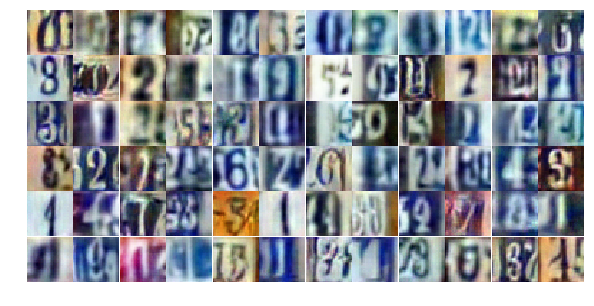

Epoch 25/25... Discriminator Loss: 0.6356... Generator Loss: 1.1146
Epoch 25/25... Discriminator Loss: 0.6712... Generator Loss: 1.0442
Epoch 25/25... Discriminator Loss: 0.8085... Generator Loss: 0.8980
Epoch 25/25... Discriminator Loss: 0.6518... Generator Loss: 1.0839
Epoch 25/25... Discriminator Loss: 1.1429... Generator Loss: 0.5353
Epoch 25/25... Discriminator Loss: 0.8086... Generator Loss: 0.8960
Epoch 25/25... Discriminator Loss: 0.4355... Generator Loss: 1.4735
Epoch 25/25... Discriminator Loss: 0.6240... Generator Loss: 1.0447
Epoch 25/25... Discriminator Loss: 2.1803... Generator Loss: 0.2536
Epoch 25/25... Discriminator Loss: 0.4024... Generator Loss: 1.7447


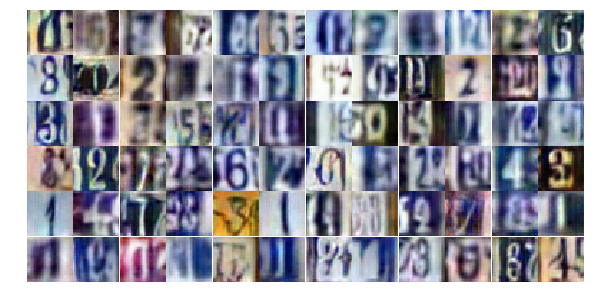

Epoch 25/25... Discriminator Loss: 0.8086... Generator Loss: 1.4216
Epoch 25/25... Discriminator Loss: 0.7448... Generator Loss: 0.9018
Epoch 25/25... Discriminator Loss: 0.5544... Generator Loss: 1.3815
Epoch 25/25... Discriminator Loss: 1.2363... Generator Loss: 0.4910
Epoch 25/25... Discriminator Loss: 0.9102... Generator Loss: 0.7784
Epoch 25/25... Discriminator Loss: 0.5310... Generator Loss: 1.3068
Epoch 25/25... Discriminator Loss: 1.9761... Generator Loss: 0.1923
Epoch 25/25... Discriminator Loss: 0.7061... Generator Loss: 1.3993
Epoch 25/25... Discriminator Loss: 0.5714... Generator Loss: 1.6381
Epoch 25/25... Discriminator Loss: 0.9762... Generator Loss: 0.7122


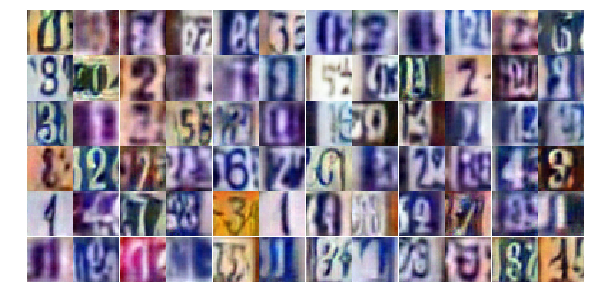

Epoch 25/25... Discriminator Loss: 0.5771... Generator Loss: 1.2163
Epoch 25/25... Discriminator Loss: 2.2280... Generator Loss: 0.1816


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

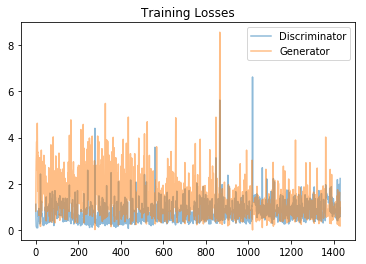

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

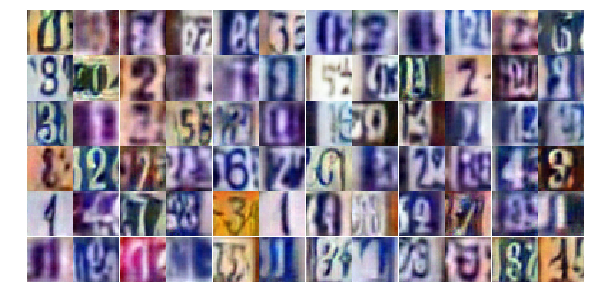

In [20]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

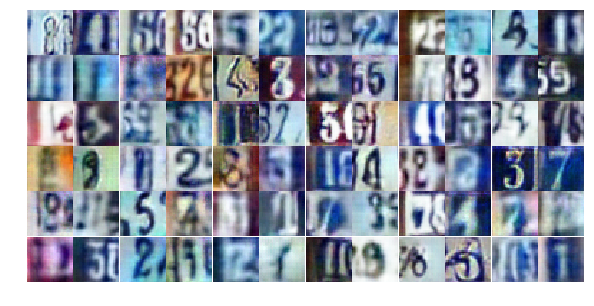

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))